# Adding the required libraries


In [ ]:
import os
import cv2
import glob
import PIL
import shutil
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
from skimage import data
from skimage.util import montage
import skimage.transform as skTrans
from skimage.transform import rotate
from skimage.transform import resize
from PIL import Image, ImageOps
import nibabel as nib
import matplotlib.pylab as plt
import keras
from tensorflow import keras
import keras.backend as K
from keras.callbacks import CSVLogger
import tensorflow as tf
from tensorflow.keras.utils import plot_model
from sklearn.preprocessing import MinMaxScaler
from sklearn.model_selection import train_test_split
from sklearn.metrics import classification_report
from tensorflow.keras.models import *
from tensorflow.keras.layers import *
from tensorflow.keras.optimizers import *
from tensorflow.keras.callbacks import ModelCheckpoint, ReduceLROnPlateau, EarlyStopping, TensorBoard
from tensorflow.keras.layers.experimental import preprocessing
from tensorflow.keras.layers import Input
from tensorflow.keras.models import Model

!pip install nilearn
import nilearn as nl
import nibabel as nib
import nilearn.plotting as nlplt


# Make numpy printouts easier to read.
np.set_printoptions(precision=3, suppress=True)

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 10.4/10.4 MB 21.4 MB/s eta 0:00:00


# **Mount Google drive**

We are using google colab To create the model. Our dataset is saved in google drive which we are importing into google colab by unzipping it to google colab.

In [ ]:
from google.colab import drive
drive.mount('/content/gdrive/')

Mounted at /content/gdrive/


In [ ]:
ls

gdrive/  sample_data/


# Set Working Directory

In [ ]:
os.chdir("/content/gdrive/MyDrive/Colab Notebooks/CMPT340")

In [ ]:
!mkdir -p "/content/data"  # Create a data directory in a writable location
!cp "/content/gdrive/MyDrive/Colab Notebooks/CMPT340/data/archive.zip" "/content/data/"  # Copy the zip file to the new data directory
!unzip "/content/data/archive.zip" -d "/content/data/"  # Unzip the file in the new data directory

Archive:  /content/data/archive.zip
  inflating: /content/data/BraTS2020_TrainingData/MICCAI_BraTS2020_TrainingData/BraTS20_Training_001/BraTS20_Training_001_flair.nii  
  inflating: /content/data/BraTS2020_TrainingData/MICCAI_BraTS2020_TrainingData/BraTS20_Training_001/BraTS20_Training_001_seg.nii  
  inflating: /content/data/BraTS2020_TrainingData/MICCAI_BraTS2020_TrainingData/BraTS20_Training_001/BraTS20_Training_001_t1.nii  
  inflating: /content/data/BraTS2020_TrainingData/MICCAI_BraTS2020_TrainingData/BraTS20_Training_001/BraTS20_Training_001_t1ce.nii  
  inflating: /content/data/BraTS2020_TrainingData/MICCAI_BraTS2020_TrainingData/BraTS20_Training_001/BraTS20_Training_001_t2.nii  
  inflating: /content/data/BraTS2020_TrainingData/MICCAI_BraTS2020_TrainingData/BraTS20_Training_002/BraTS20_Training_002_flair.nii  
  inflating: /content/data/BraTS2020_TrainingData/MICCAI_BraTS2020_TrainingData/BraTS20_Training_002/BraTS20_Training_002_seg.nii  
  inflating: /content/data/BraTS2020_

# Handling .nii files

# **What are .nii files?**
NII format is created by Neuroimaging Informatics Technology Initiative. It is commonly used to store magnetic resonance imaging (MRI) data.

This sections of the code is just to see how to open and visualize this .nii data in python.

Text(0.5, 1.0, 'Mask')

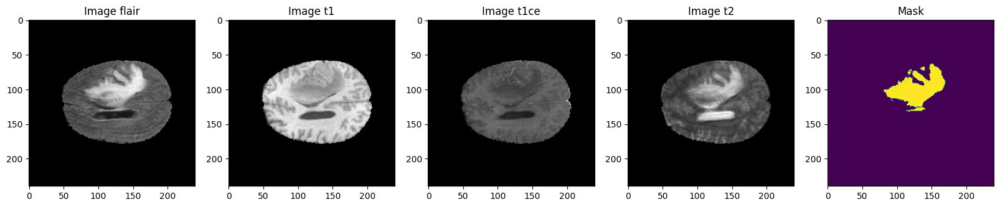

In [ ]:
TRAIN_DATASET_PATH = '/content/data/BraTS2020_TrainingData/MICCAI_BraTS2020_TrainingData'
VALIDATION_DATASET_PATH = '/content/data/BraTS2020_ValidationData/MICCAI_BraTS2020_ValidationData'

test_image_flair=nib.load(TRAIN_DATASET_PATH + '/BraTS20_Training_001/BraTS20_Training_001_flair.nii').get_fdata()
test_image_t1=nib.load(TRAIN_DATASET_PATH + '/BraTS20_Training_001/BraTS20_Training_001_t1.nii').get_fdata()
test_image_t1ce=nib.load(TRAIN_DATASET_PATH + '/BraTS20_Training_001/BraTS20_Training_001_t1ce.nii').get_fdata()
test_image_t2=nib.load(TRAIN_DATASET_PATH + '/BraTS20_Training_001/BraTS20_Training_001_t2.nii').get_fdata()
test_mask=nib.load(TRAIN_DATASET_PATH + '/BraTS20_Training_001/BraTS20_Training_001_seg.nii').get_fdata()


fig, (ax1, ax2, ax3, ax4, ax5) = plt.subplots(1,5, figsize = (20, 10))
slice_w = 25
ax1.imshow(test_image_flair[:,:,test_image_flair.shape[0]//2-slice_w], cmap = 'gray')
ax1.set_title('Image flair')
ax2.imshow(test_image_t1[:,:,test_image_t1.shape[0]//2-slice_w], cmap = 'gray')
ax2.set_title('Image t1')
ax3.imshow(test_image_t1ce[:,:,test_image_t1ce.shape[0]//2-slice_w], cmap = 'gray')
ax3.set_title('Image t1ce')
ax4.imshow(test_image_t2[:,:,test_image_t2.shape[0]//2-slice_w], cmap = 'gray')
ax4.set_title('Image t2')
ax5.imshow(test_mask[:,:,test_mask.shape[0]//2-slice_w])
ax5.set_title('Mask')

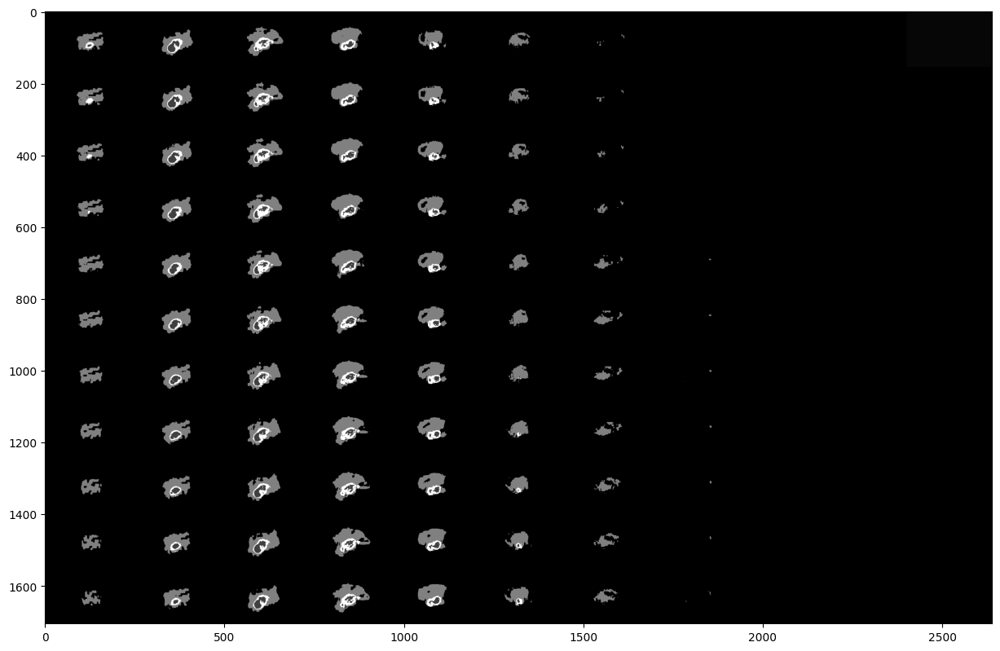

In [ ]:
# Skip 50:-50 slices since there is not much to see
fig, ax1 = plt.subplots(1, 1, figsize = (15,15))
ax1.imshow(rotate(montage(test_mask[60:-60,:,:]), 90, resize=True), cmap ='gray')

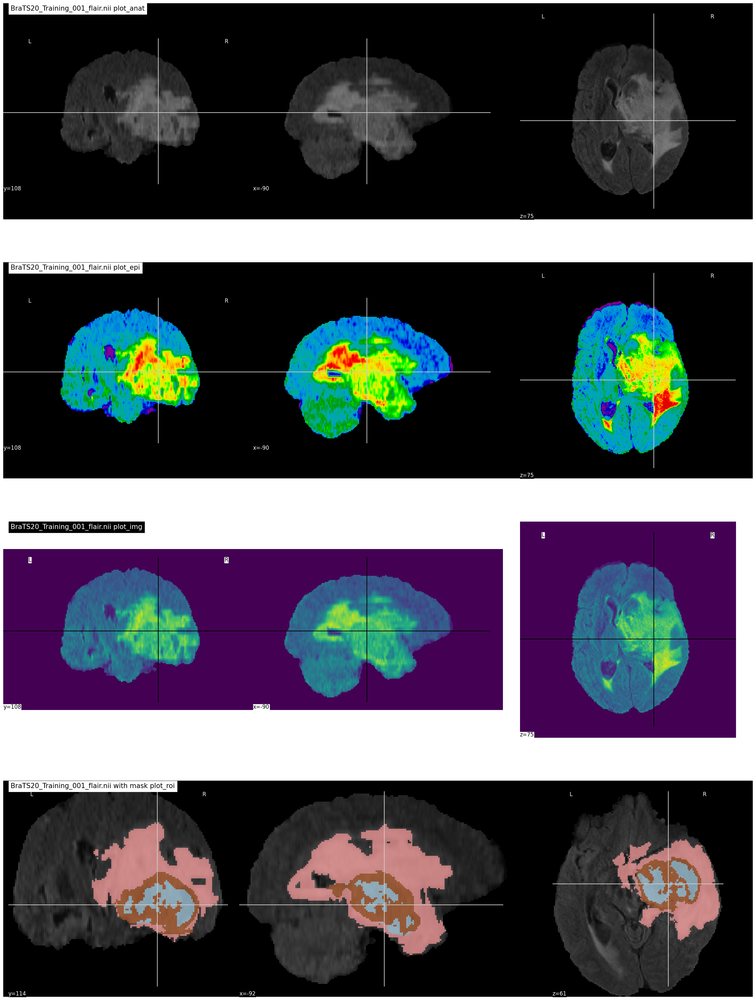

In [ ]:
niimg = nl.image.load_img(TRAIN_DATASET_PATH + '/BraTS20_Training_001/BraTS20_Training_001_flair.nii')
nimask = nl.image.load_img(TRAIN_DATASET_PATH + '/BraTS20_Training_001/BraTS20_Training_001_seg.nii')

fig, axes = plt.subplots(nrows=4, figsize=(30, 40))


nlplt.plot_anat(niimg,
                title='BraTS20_Training_001_flair.nii plot_anat',
                axes=axes[0])

nlplt.plot_epi(niimg,
               title='BraTS20_Training_001_flair.nii plot_epi',
               axes=axes[1])

nlplt.plot_img(niimg,
               title='BraTS20_Training_001_flair.nii plot_img',
               axes=axes[2])

nlplt.plot_roi(nimask,
               title='BraTS20_Training_001_flair.nii with mask plot_roi',
               bg_img=niimg,
               axes=axes[3], cmap='Paired')

plt.show()

# Set configuring parameters

In [ ]:
# There are 155 slices per volume
# We want to use all 155 slices, start at 0 and end at 154
IMG_SIZE=128
VOLUME_SLICES = 155
VOLUME_START_AT = 0  # starting from the first slice of the volume
TRAIN_DATASET_PATH = '/content/data/BraTS2020_TrainingData/MICCAI_BraTS2020_TrainingData'

# Loading the dataset

In [ ]:
'''
This is a list comprehension that goes through each entry in the directory.
For each entry, it checks if the entry is a directory (if f.is_dir()).
If the entry is a directory, it gets the path to the directory (f.path) and adds it to the list.
'''
# train_and_val_directories = [f.path for f in os.scandir(TRAIN_DATASET_PATH) if f.is_dir()]
train_directories = [f.path for f in os.scandir(TRAIN_DATASET_PATH) if f.is_dir()]

In [ ]:
# Removing the corrupted data
# This is done because the mask file in the data for file BraTS20_Training_335 seems to have bad data
# Removing it is a better idea than renaming it as the data could be courpted.
train_directories.remove('/content/data/BraTS2020_TrainingData/MICCAI_BraTS2020_TrainingData/BraTS20_Training_355')

In [ ]:
def pathListIntoIds(dirList):
    x = []
    for i in range(0,len(dirList)):
        x.append(dirList[i][dirList[i].rfind('/')+1:])
    return x

In [ ]:
dataset_ids = pathListIntoIds(train_directories);

In [ ]:
sorted_dataset_ids = sorted(dataset_ids)
print(sorted_dataset_ids)

['BraTS20_Training_001', 'BraTS20_Training_002', 'BraTS20_Training_003', 'BraTS20_Training_004', 'BraTS20_Training_005', 'BraTS20_Training_006', 'BraTS20_Training_007', 'BraTS20_Training_008', 'BraTS20_Training_009', 'BraTS20_Training_010', 'BraTS20_Training_011', 'BraTS20_Training_012', 'BraTS20_Training_013', 'BraTS20_Training_014', 'BraTS20_Training_015', 'BraTS20_Training_016', 'BraTS20_Training_017', 'BraTS20_Training_018', 'BraTS20_Training_019', 'BraTS20_Training_020', 'BraTS20_Training_021', 'BraTS20_Training_022', 'BraTS20_Training_023', 'BraTS20_Training_024', 'BraTS20_Training_025', 'BraTS20_Training_026', 'BraTS20_Training_027', 'BraTS20_Training_028', 'BraTS20_Training_029', 'BraTS20_Training_030', 'BraTS20_Training_031', 'BraTS20_Training_032', 'BraTS20_Training_033', 'BraTS20_Training_034', 'BraTS20_Training_035', 'BraTS20_Training_036', 'BraTS20_Training_037', 'BraTS20_Training_038', 'BraTS20_Training_039', 'BraTS20_Training_040', 'BraTS20_Training_041', 'BraTS20_Traini

# Splitting train, validation and test
80% train

10% validation

10% test

In [ ]:
# Split the validation set into validation and test sets
# 80% of the data will be used for validation, 20% for test
# train_ids, val_ids, test_ids = train_test_split(sorted_dataset_ids, test_size=0.4)

# Use a specific random state for reproducibility
random_state_value = 42


# First split: 80% for training, 20% for temp (validation + test)
# train_ids, temp_ids = train_test_split(sorted_dataset_ids, test_size=0.2)
train_ids, temp_ids = train_test_split(sorted_dataset_ids, test_size=0.2, random_state=random_state_value)


# Second split: Split the temp into validation and test (50% each)
# val_ids, test_ids = train_test_split(temp_ids, test_size=0.5)
val_ids, test_ids = train_test_split(temp_ids, test_size=0.5, random_state=random_state_value)


In [ ]:
# making sure the data split was succefull and there is not leakage

print("Size of training set:", len(train_ids), train_ids)
print("Size of validation set:", len(val_ids), val_ids)
print("Size of test set:", len(test_ids), test_ids)

Size of training set: 294 ['BraTS20_Training_350', 'BraTS20_Training_308', 'BraTS20_Training_076', 'BraTS20_Training_085', 'BraTS20_Training_358', 'BraTS20_Training_017', 'BraTS20_Training_067', 'BraTS20_Training_325', 'BraTS20_Training_008', 'BraTS20_Training_114', 'BraTS20_Training_117', 'BraTS20_Training_327', 'BraTS20_Training_322', 'BraTS20_Training_219', 'BraTS20_Training_279', 'BraTS20_Training_111', 'BraTS20_Training_276', 'BraTS20_Training_061', 'BraTS20_Training_288', 'BraTS20_Training_317', 'BraTS20_Training_133', 'BraTS20_Training_224', 'BraTS20_Training_141', 'BraTS20_Training_018', 'BraTS20_Training_353', 'BraTS20_Training_025', 'BraTS20_Training_200', 'BraTS20_Training_324', 'BraTS20_Training_361', 'BraTS20_Training_359', 'BraTS20_Training_140', 'BraTS20_Training_164', 'BraTS20_Training_235', 'BraTS20_Training_365', 'BraTS20_Training_211', 'BraTS20_Training_263', 'BraTS20_Training_302', 'BraTS20_Training_193', 'BraTS20_Training_159', 'BraTS20_Training_020', 'BraTS20_Trai

# Initialize MRI Data Generators
Defines and initializes custom data generators for the MRI datasets, preparing them for training, validation, and testing in the neural network model. The data generators handle loading, resizing, and preprocessing of the MRI images and segmentation masks

In [ ]:
class DataGenerator(keras.utils.Sequence):
    'Generates data for Keras'
    def __init__(self, list_IDs, base_path, dim=(IMG_SIZE, IMG_SIZE), batch_size=1, n_channels=2, shuffle=True):
        'Initialization'
        self.dim = dim
        self.batch_size = batch_size
        self.list_IDs = list_IDs
        self.base_path = base_path
        self.n_channels = n_channels
        self.shuffle = shuffle
        self.on_epoch_end()

    def __len__(self):
        'Denotes the number of batches per epoch'
        return int(np.floor(len(self.list_IDs) / self.batch_size))

    def __getitem__(self, index):
        'Generate one batch of data'
        indexes = self.indexes[index*self.batch_size:(index+1)*self.batch_size]
        batch_ids = [self.list_IDs[k] for k in indexes]
        X, Y = self.__data_generation(batch_ids)
        return X, Y

    def on_epoch_end(self):
        'Updates indexes after each epoch'
        self.indexes = np.arange(len(self.list_IDs))
        if self.shuffle:
            np.random.shuffle(self.indexes)

    def __data_generation(self, batch_ids):
        'Generates data containing batch_size samples'
        X = np.zeros((self.batch_size * VOLUME_SLICES, *self.dim, self.n_channels), dtype=np.float32)
        Y = np.zeros((self.batch_size * VOLUME_SLICES, *self.dim, 4), dtype=np.float32)

        for c, id_ in enumerate(batch_ids):
            case_path = os.path.join(self.base_path, id_)

            flair_path = os.path.join(case_path, f'{id_}_flair.nii')
            t1ce_path = os.path.join(case_path, f'{id_}_t1ce.nii')
            seg_path = os.path.join(case_path, f'{id_}_seg.nii')

            flair = nib.load(flair_path).get_fdata()
            t1ce = nib.load(t1ce_path).get_fdata()
            seg = nib.load(seg_path).get_fdata()

            for j in range(VOLUME_SLICES):
                X[j + VOLUME_SLICES * c, :, :, 0] = cv2.resize(flair[:, :, j + VOLUME_START_AT], self.dim)
                X[j + VOLUME_SLICES * c, :, :, 1] = cv2.resize(t1ce[:, :, j + VOLUME_START_AT], self.dim)

                seg_resized = cv2.resize(seg[:, :, j + VOLUME_START_AT], self.dim, interpolation=cv2.INTER_NEAREST)
                seg_resized[seg_resized == 4] = 3  # Adjusting class labels if needed
                Y[j + VOLUME_SLICES * c] = tf.one_hot(seg_resized.astype(np.int32), 4)

        # Normalize the images
        X = X / np.max(X)
        return X, Y

# Instantiate the data generators
training_generator = DataGenerator(train_ids, TRAIN_DATASET_PATH)
valid_generator = DataGenerator(val_ids, TRAIN_DATASET_PATH)
test_generator = DataGenerator(test_ids, TRAIN_DATASET_PATH)


# Loss function
**Dice Coefficient Functions**:
Precision, Sensitivity, Specificity: Defines functions for additional crucial metrics:

*   Precision: Accuracy of positive predictions.
*   Sensitivity: True positive rate.
*   Specificity: True negative rate.








In [ ]:
def dice_coef(y_true, y_pred, smooth=1.0):
    class_num = 4
    for i in range(class_num):
        y_true_f = K.flatten(y_true[:,:,:,i])
        y_pred_f = K.flatten(y_pred[:,:,:,i])
        intersection = K.sum(y_true_f * y_pred_f)
        loss = ((2. * intersection + smooth) / (K.sum(y_true_f) + K.sum(y_pred_f) + smooth))
        # K.print_tensor(loss, message='loss value for class {} : '.format(SEGMENT_CLASSES[i]))
        if i == 0:
            total_loss = loss
        else:
            total_loss = total_loss + loss
    total_loss = total_loss / class_num
    # K.print_tensor(total_loss, message=' total dice coef: ')
    return total_loss



# define per class evaluation of dice coef
# inspired by https://github.com/keras-team/keras/issues/9395
def dice_coef_necrotic(y_true, y_pred, epsilon=1e-6):
    intersection = K.sum(K.abs(y_true[:,:,:,1] * y_pred[:,:,:,1]))
    return (2. * intersection) / (K.sum(K.square(y_true[:,:,:,1])) + K.sum(K.square(y_pred[:,:,:,1])) + epsilon)

def dice_coef_edema(y_true, y_pred, epsilon=1e-6):
    intersection = K.sum(K.abs(y_true[:,:,:,2] * y_pred[:,:,:,2]))
    return (2. * intersection) / (K.sum(K.square(y_true[:,:,:,2])) + K.sum(K.square(y_pred[:,:,:,2])) + epsilon)

def dice_coef_enhancing(y_true, y_pred, epsilon=1e-6):
    intersection = K.sum(K.abs(y_true[:,:,:,3] * y_pred[:,:,:,3]))
    return (2. * intersection) / (K.sum(K.square(y_true[:,:,:,3])) + K.sum(K.square(y_pred[:,:,:,3])) + epsilon)



# Computing Precision
def precision(y_true, y_pred):
        true_positives = K.sum(K.round(K.clip(y_true * y_pred, 0, 1)))
        predicted_positives = K.sum(K.round(K.clip(y_pred, 0, 1)))
        precision = true_positives / (predicted_positives + K.epsilon())
        return precision


# Computing Sensitivity
def sensitivity(y_true, y_pred):
    true_positives = K.sum(K.round(K.clip(y_true * y_pred, 0, 1)))
    possible_positives = K.sum(K.round(K.clip(y_true, 0, 1)))
    return true_positives / (possible_positives + K.epsilon())


# Computing Specificity
def specificity(y_true, y_pred):
    true_negatives = K.sum(K.round(K.clip((1-y_true) * (1-y_pred), 0, 1)))
    possible_negatives = K.sum(K.round(K.clip(1-y_true, 0, 1)))
    return true_negatives / (possible_negatives + K.epsilon())

# U-net model
*   Layer Composition: It consists of convolutional layers, max pooling for down-sampling, and up-sampling layers, followed by concatenation steps for feature map fusion.
*   Output Layer: The final layer uses a softmax activation for multi-class segmentation.
*   Model Compilation: After defining the U-Net model, it's compiled with categorical cross-entropy loss and accuracy, MeanIoU, and custom metrics like dice coefficient, precision, sensitivity, and specificity.


In [ ]:
def build_unet(inputs, ker_init, dropout):
    conv1 = Conv2D(32, 3, activation = 'relu', padding = 'same', kernel_initializer = ker_init)(inputs)
    conv1 = Conv2D(32, 3, activation = 'relu', padding = 'same', kernel_initializer = ker_init)(conv1)

    pool = MaxPooling2D(pool_size=(2, 2))(conv1)
    conv = Conv2D(64, 3, activation = 'relu', padding = 'same', kernel_initializer = ker_init)(pool)
    conv = Conv2D(64, 3, activation = 'relu', padding = 'same', kernel_initializer = ker_init)(conv)

    pool1 = MaxPooling2D(pool_size=(2, 2))(conv)
    conv2 = Conv2D(128, 3, activation = 'relu', padding = 'same', kernel_initializer = ker_init)(pool1)
    conv2 = Conv2D(128, 3, activation = 'relu', padding = 'same', kernel_initializer = ker_init)(conv2)

    pool2 = MaxPooling2D(pool_size=(2, 2))(conv2)
    conv3 = Conv2D(256, 3, activation = 'relu', padding = 'same', kernel_initializer = ker_init)(pool2)
    conv3 = Conv2D(256, 3, activation = 'relu', padding = 'same', kernel_initializer = ker_init)(conv3)


    pool4 = MaxPooling2D(pool_size=(2, 2))(conv3)
    conv5 = Conv2D(512, 3, activation = 'relu', padding = 'same', kernel_initializer = ker_init)(pool4)
    conv5 = Conv2D(512, 3, activation = 'relu', padding = 'same', kernel_initializer = ker_init)(conv5)
    drop5 = Dropout(dropout)(conv5)

    up7 = Conv2D(256, 2, activation = 'relu', padding = 'same', kernel_initializer = ker_init)(UpSampling2D(size = (2,2))(drop5))
    merge7 = concatenate([conv3,up7], axis = 3)
    conv7 = Conv2D(256, 3, activation = 'relu', padding = 'same', kernel_initializer = ker_init)(merge7)
    conv7 = Conv2D(256, 3, activation = 'relu', padding = 'same', kernel_initializer = ker_init)(conv7)

    up8 = Conv2D(128, 2, activation = 'relu', padding = 'same', kernel_initializer = ker_init)(UpSampling2D(size = (2,2))(conv7))
    merge8 = concatenate([conv2,up8], axis = 3)
    conv8 = Conv2D(128, 3, activation = 'relu', padding = 'same', kernel_initializer = ker_init)(merge8)
    conv8 = Conv2D(128, 3, activation = 'relu', padding = 'same', kernel_initializer = ker_init)(conv8)

    up9 = Conv2D(64, 2, activation = 'relu', padding = 'same', kernel_initializer = ker_init)(UpSampling2D(size = (2,2))(conv8))
    merge9 = concatenate([conv,up9], axis = 3)
    conv9 = Conv2D(64, 3, activation = 'relu', padding = 'same', kernel_initializer = ker_init)(merge9)
    conv9 = Conv2D(64, 3, activation = 'relu', padding = 'same', kernel_initializer = ker_init)(conv9)

    up = Conv2D(32, 2, activation = 'relu', padding = 'same', kernel_initializer = ker_init)(UpSampling2D(size = (2,2))(conv9))
    merge = concatenate([conv1,up], axis = 3)
    conv = Conv2D(32, 3, activation = 'relu', padding = 'same', kernel_initializer = ker_init)(merge)
    conv = Conv2D(32, 3, activation = 'relu', padding = 'same', kernel_initializer = ker_init)(conv)

    conv10 = Conv2D(4, (1,1), activation = 'softmax')(conv)

    return Model(inputs = inputs, outputs = conv10)

input_layer = Input((IMG_SIZE, IMG_SIZE, 2))

model = build_unet(input_layer, 'he_normal', 0.2)
model.compile(loss="categorical_crossentropy", optimizer=keras.optimizers.Adam(learning_rate=0.001), metrics = ['accuracy',tf.keras.metrics.MeanIoU(num_classes=4), dice_coef, precision, sensitivity, specificity, dice_coef_necrotic, dice_coef_edema ,dice_coef_enhancing] )

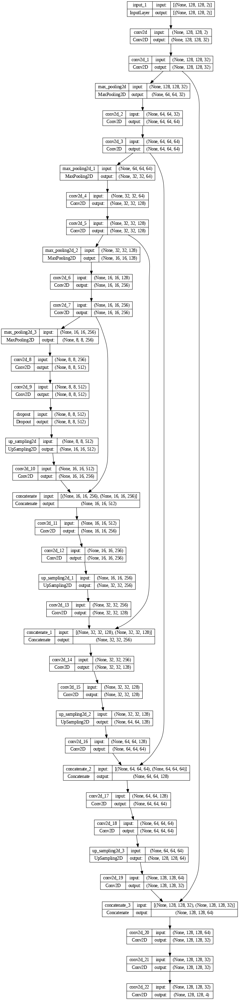

In [ ]:
# plotting the architure of the model
plot_model(model,
           show_shapes = True,
           show_dtype=False,
           show_layer_names = True,
           rankdir = 'TB',
           expand_nested = False,
           dpi = 70)

In [ ]:
# K.clear_session()

# Training

In [ ]:
dropout_rate = 0.2

# Input layer
input_layer = Input((IMG_SIZE, IMG_SIZE, 2))

# Build the U-Net model
model = build_unet(input_layer, 'he_normal', dropout_rate)

# Compile the model
model.compile(optimizer='adam',
              loss='categorical_crossentropy',
              metrics=['accuracy', dice_coef])  # Ensure dice_coef is defined

# Set up callbacks
callbacks = [
    tf.keras.callbacks.ModelCheckpoint('model_best.h5', save_best_only=True),
    tf.keras.callbacks.EarlyStopping(patience=10, monitor='val_loss'),
    tf.keras.callbacks.ReduceLROnPlateau(factor=0.1, patience=5, min_lr=0.00001, monitor='val_loss')
]

# Train the model
history = model.fit(
    training_generator,
    validation_data=valid_generator,
    epochs= 25,  #25, 30, 35, 40, 45
    callbacks=callbacks
)

# Evaluate the model on the test set
test_results = model.evaluate(test_generator)
print("Test Loss, Test Accuracy:", test_results)

Epoch 1/25
294/294 [==============================] - ETA: 0s - loss: 0.0754 - accuracy: 0.9860 - dice_coef: 0.2679

/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3079: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


294/294 [==============================] - 199s 600ms/step - loss: 0.0754 - accuracy: 0.9860 - dice_coef: 0.2679 - val_loss: 0.0652 - val_accuracy: 0.9889 - val_dice_coef: 0.2814 - lr: 0.0010
Epoch 2/25
294/294 [==============================] - 170s 578ms/step - loss: 0.0499 - accuracy: 0.9889 - dice_coef: 0.2759 - val_loss: 0.0434 - val_accuracy: 0.9889 - val_dice_coef: 0.2823 - lr: 0.0010
Epoch 3/25
294/294 [==============================] - 168s 570ms/step - loss: 0.0463 - accuracy: 0.9889 - dice_coef: 0.2806 - val_loss: 0.0408 - val_accuracy: 0.9889 - val_dice_coef: 0.2938 - lr: 0.0010
Epoch 4/25
294/294 [==============================] - 174s 591ms/step - loss: 0.0426 - accuracy: 0.9887 - dice_coef: 0.2979 - val_loss: 0.0357 - val_accuracy: 0.9889 - val_dice_coef: 0.3265 - lr: 0.0010
Epoch 5/25
294/294 [==============================] - 168s 572ms/step - loss: 0.0412 - accuracy: 0.9889 - dice_coef: 0.3117 - val_loss: 0.0291 - val_accuracy: 0.9900 - val_dice_coef: 0.3659 - lr: 0.0

# Visualize Training and Validation Metrics

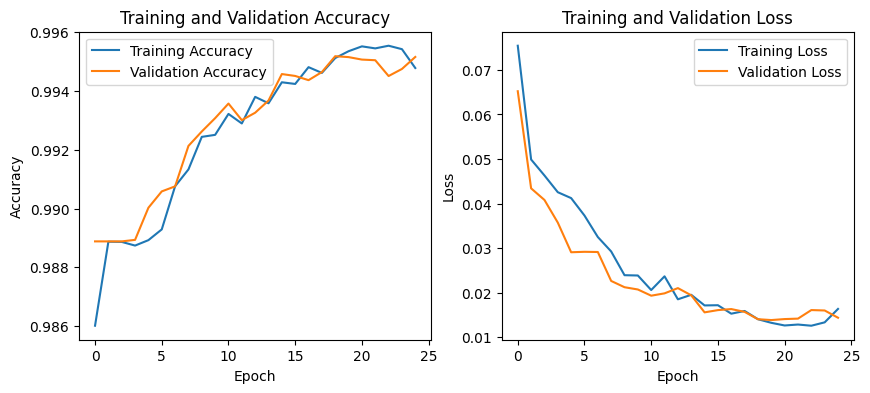

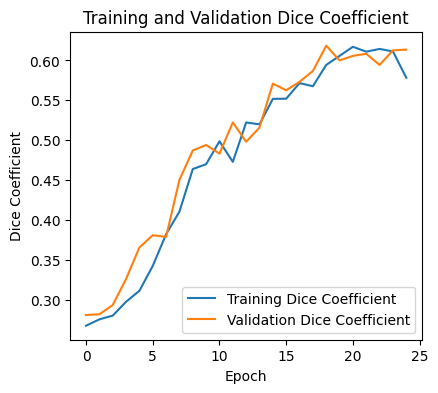

In [ ]:
# Plot training & validation accuracy
plt.figure(figsize=(10, 4))
plt.subplot(1, 2, 1)
plt.plot(history.history['accuracy'], label='Training Accuracy')
plt.plot(history.history['val_accuracy'], label='Validation Accuracy')
plt.title('Training and Validation Accuracy')
plt.xlabel('Epoch')
plt.ylabel('Accuracy')
plt.legend()

# Plot training & validation loss
plt.subplot(1, 2, 2)
plt.plot(history.history['loss'], label='Training Loss')
plt.plot(history.history['val_loss'], label='Validation Loss')
plt.title('Training and Validation Loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.legend()

plt.show()

# Plot training & validation Dice Coefficient
plt.figure(figsize=(10, 4))
plt.subplot(1, 2, 1)
plt.plot(history.history['dice_coef'], label='Training Dice Coefficient')
plt.plot(history.history['val_dice_coef'], label='Validation Dice Coefficient')
plt.title('Training and Validation Dice Coefficient')
plt.xlabel('Epoch')
plt.ylabel('Dice Coefficient')
plt.legend()

# Plot training & validation Mean IOU

plt.show()

5/5 [==============================] - 1s 138ms/step


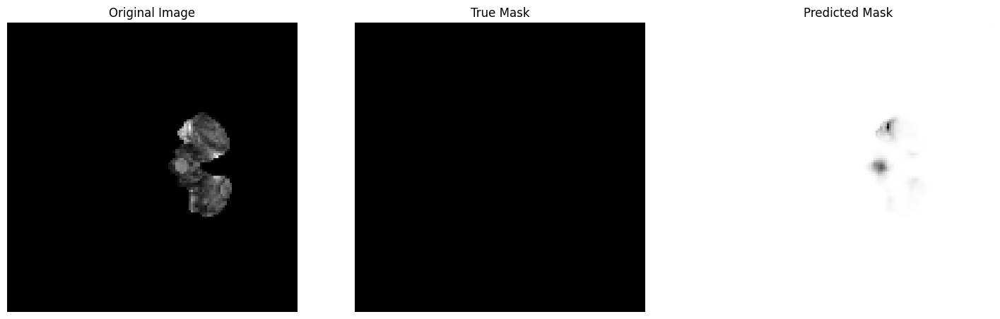

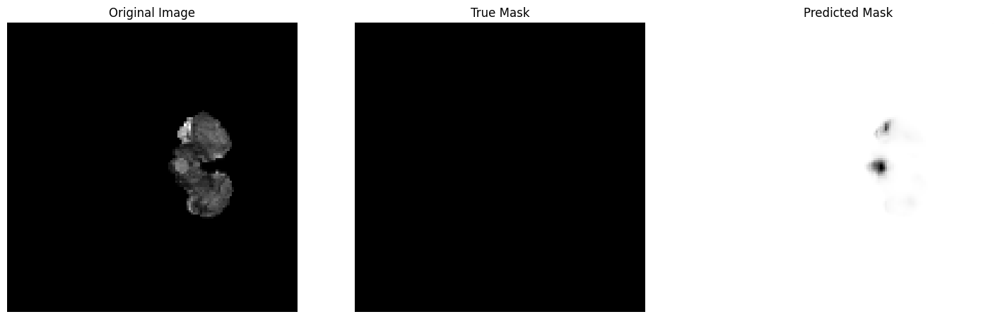

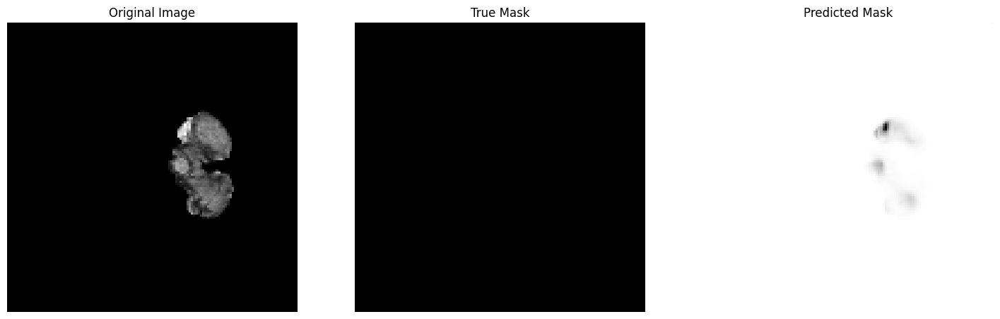

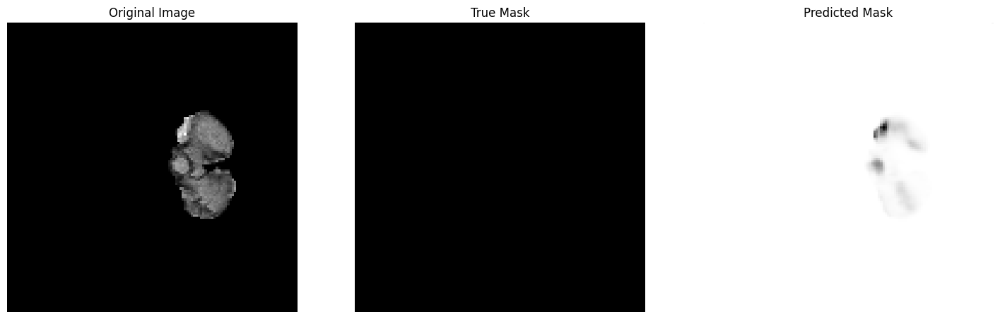

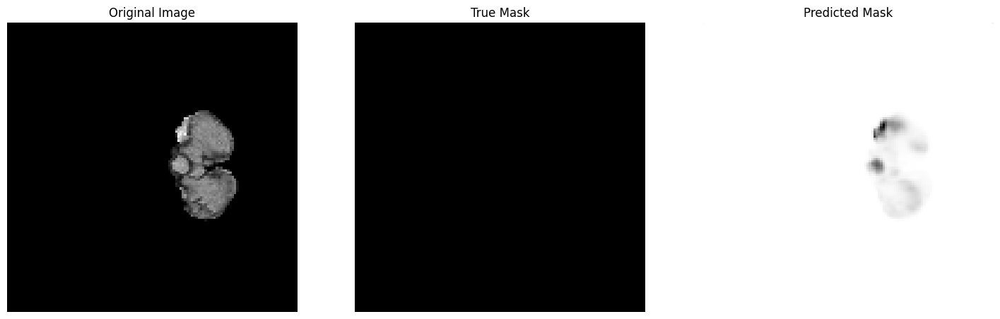

...

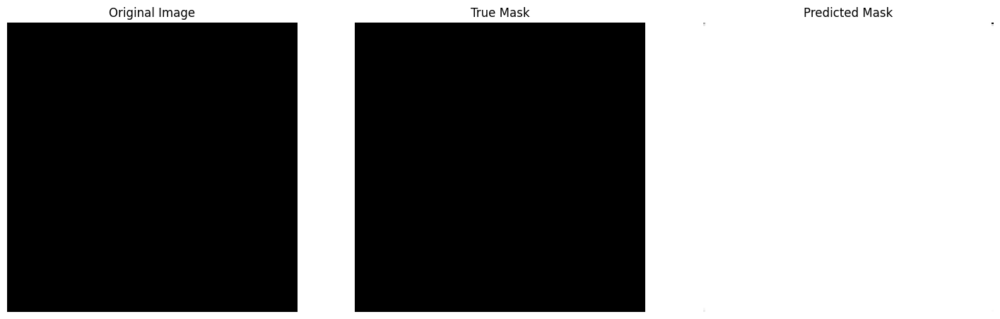

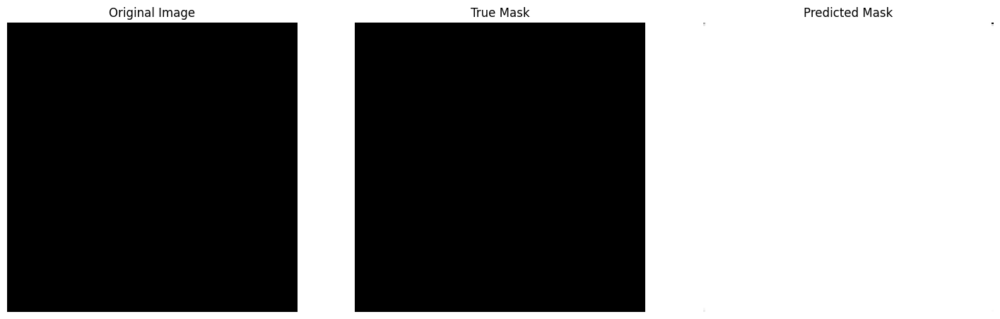

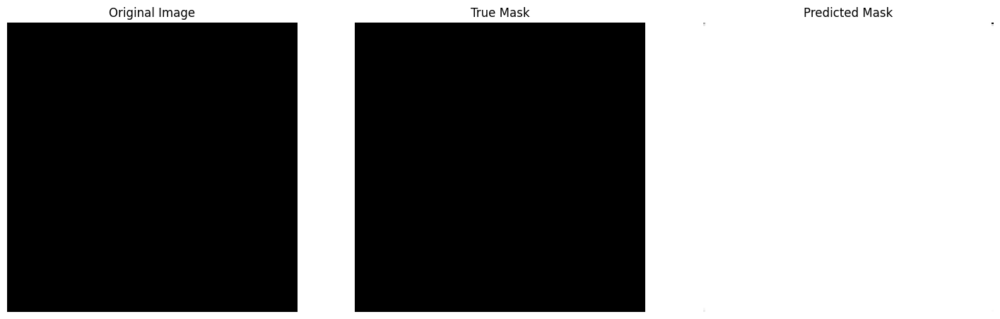

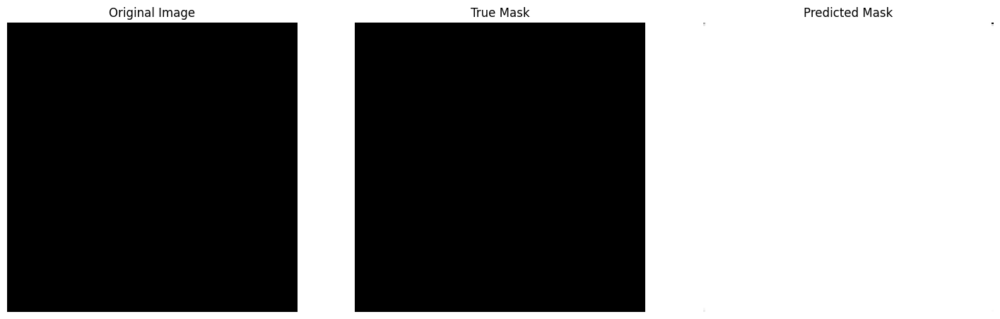

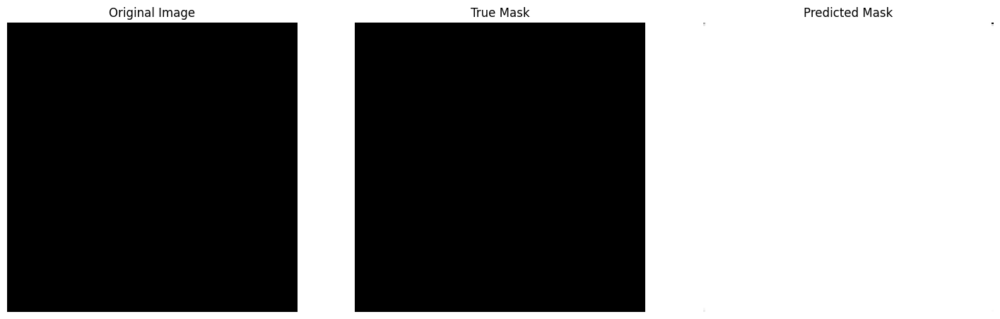

5/5 [==============================] - 0s 18ms/step


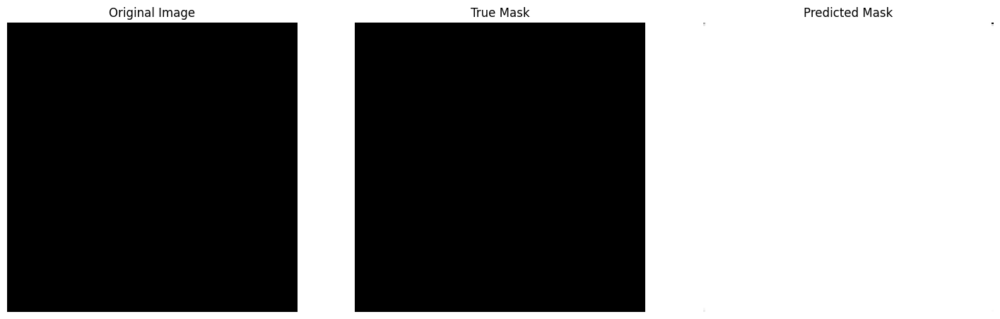

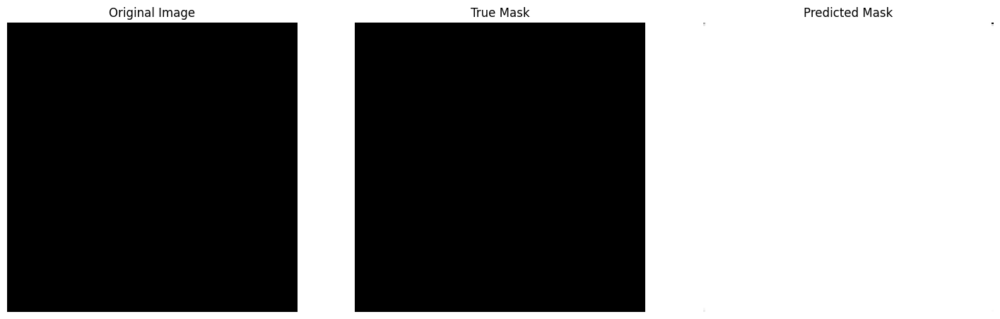

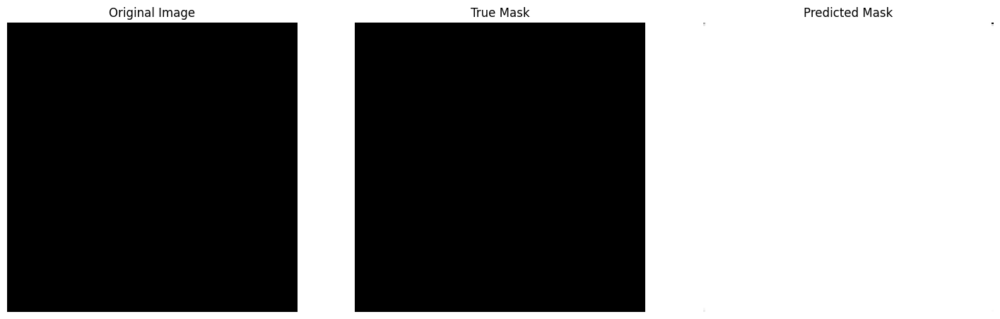

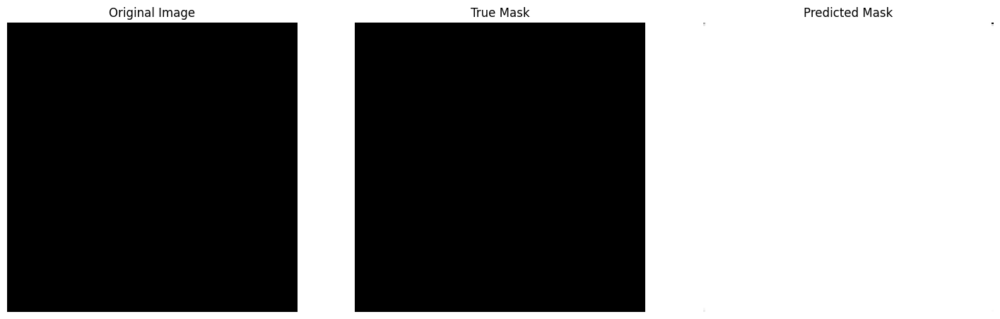

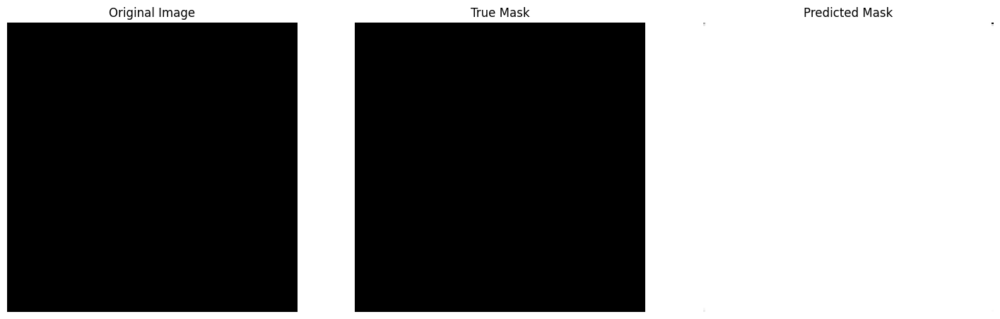

...

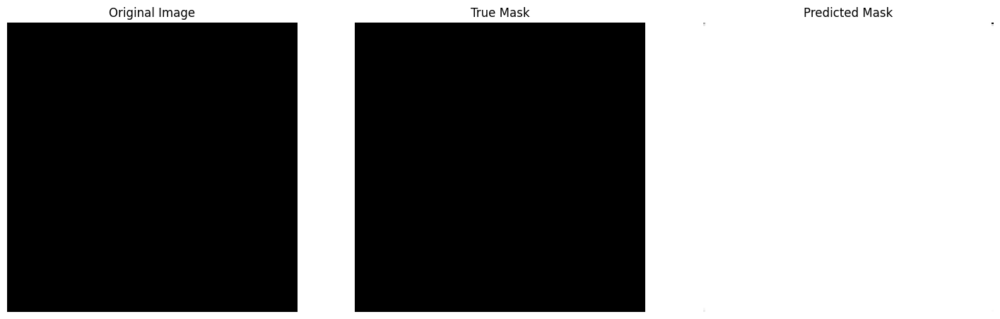

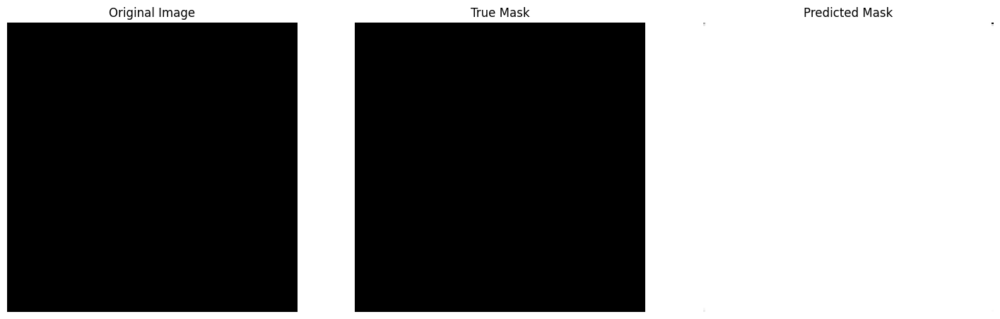

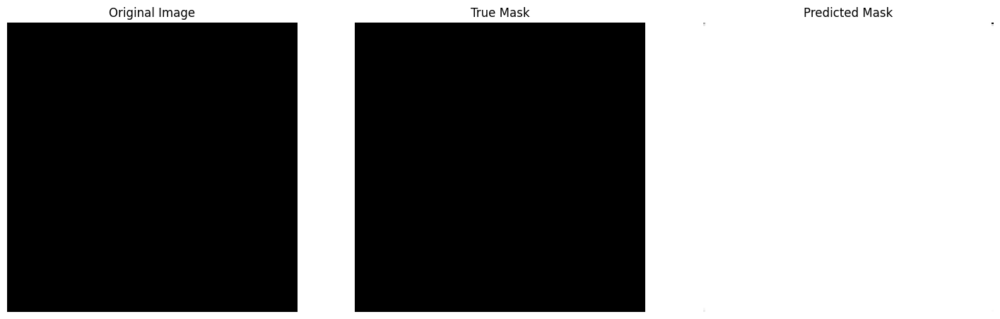

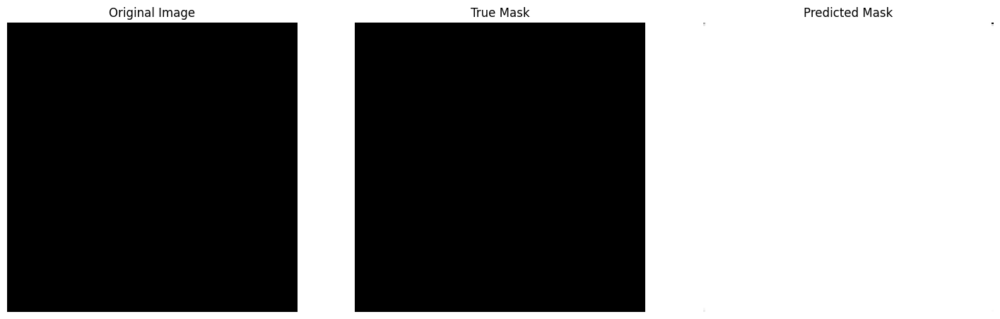

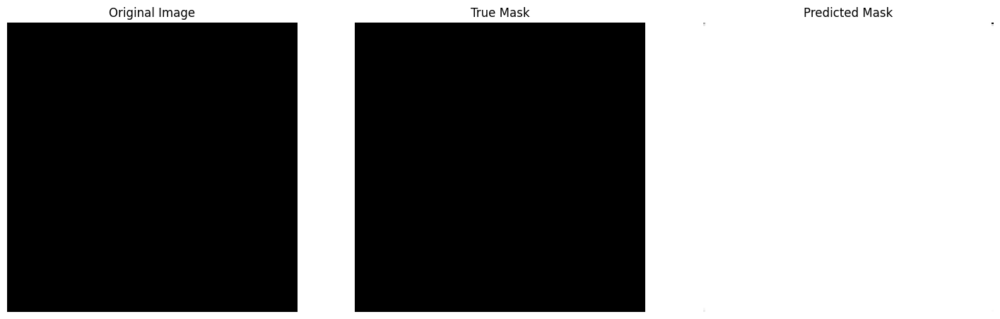

5/5 [==============================] - 0s 18ms/step


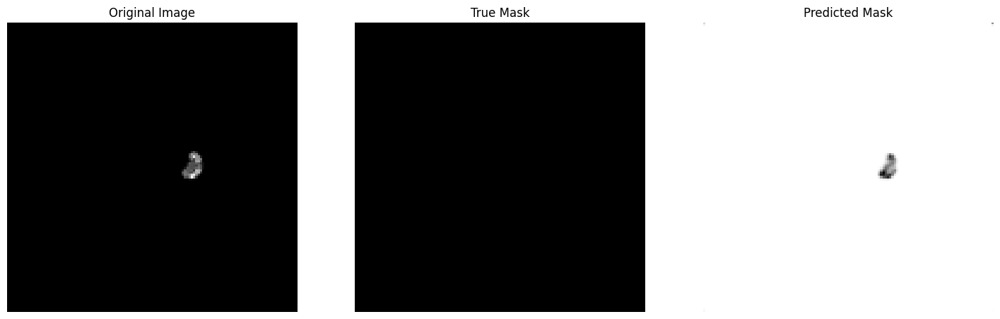

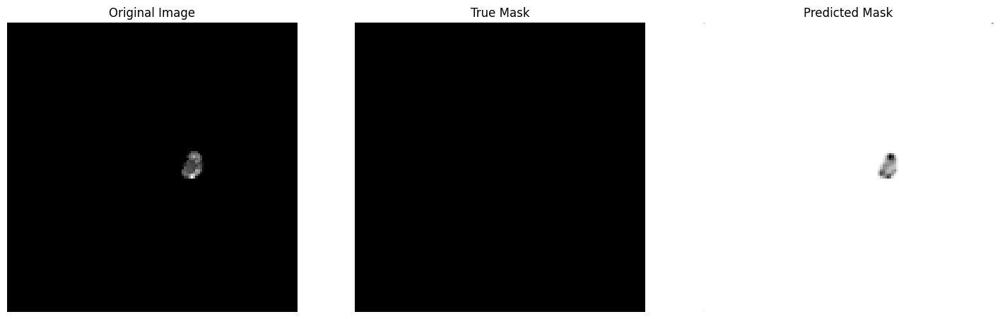

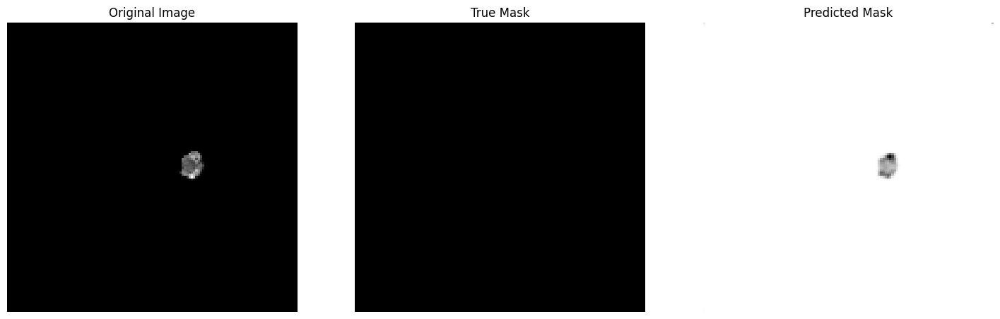

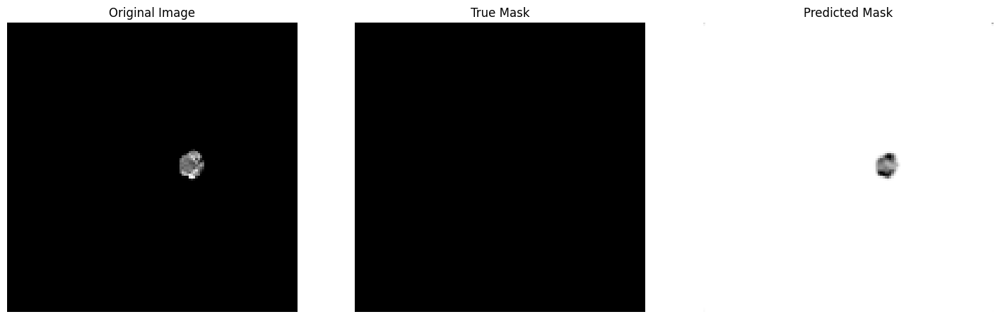

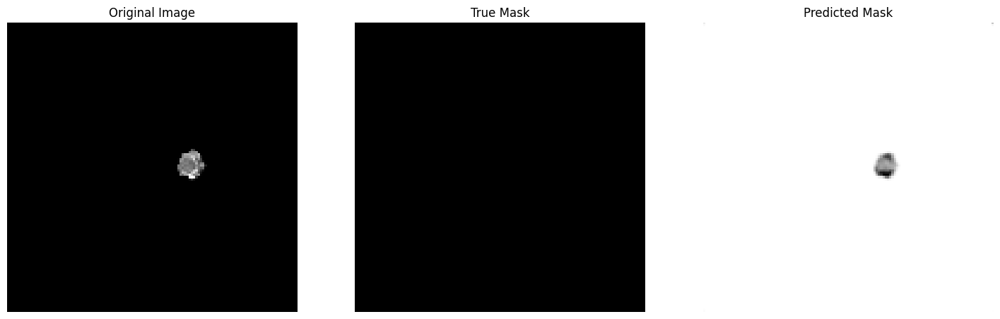

...

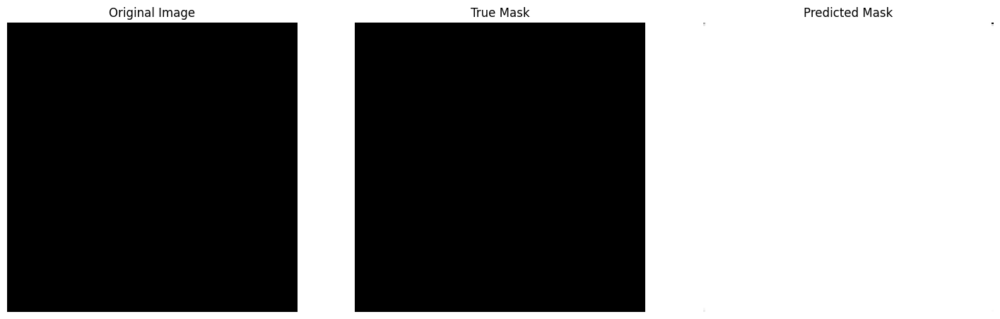

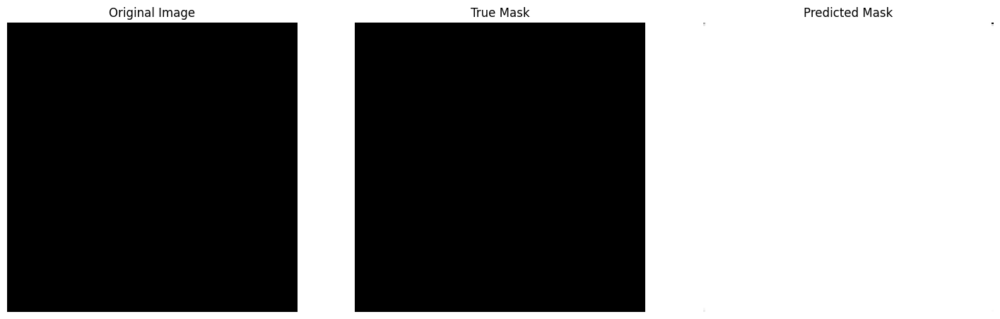

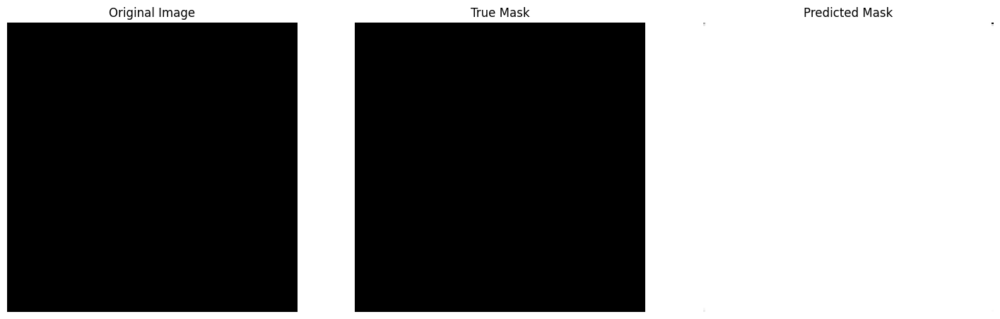

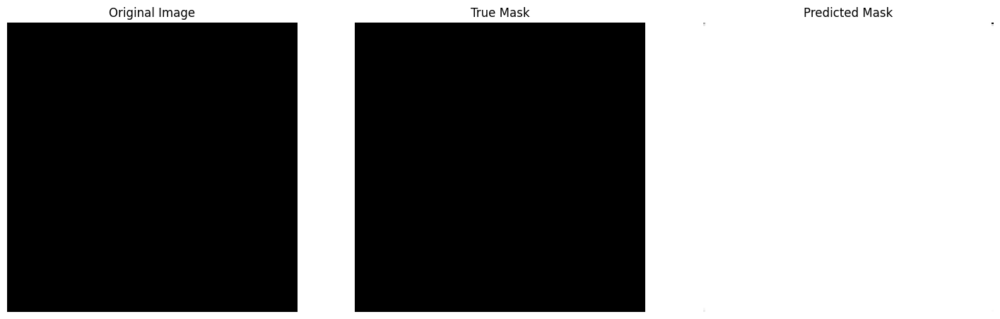

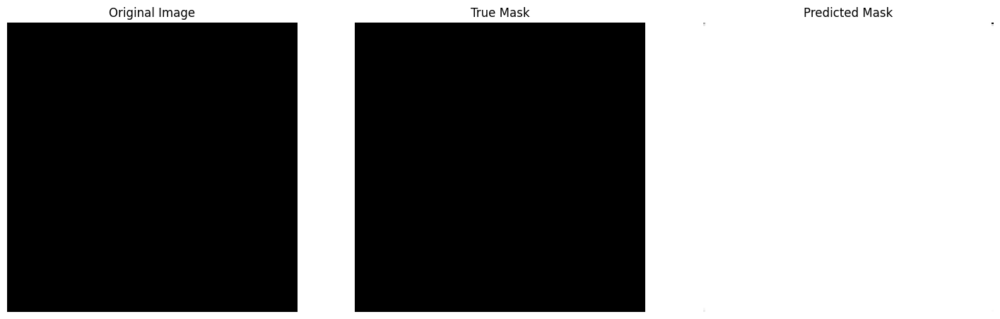

In [ ]:
# Visualize Model Predictions on Training Data
def plot_image_mask_prediction(image, true_mask, pred_mask):
    plt.figure(figsize=(18, 6))

    plt.subplot(1, 3, 1)
    plt.imshow(image, cmap='gray')
    plt.title('Original Image')
    plt.axis('off')

    plt.subplot(1, 3, 2)
    plt.imshow(true_mask, cmap='gray')
    plt.title('True Mask')
    plt.axis('off')

    plt.subplot(1, 3, 3)
    plt.imshow(pred_mask, cmap='gray')
    plt.title('Predicted Mask')
    plt.axis('off')

    plt.show()


for i in range(3):
    X_train, Y_train = training_generator[i]
    pred_masks = model.predict(X_train)

    # For each image in the batch
    for j in range(X_train.shape[0]):
        plot_image_mask_prediction(X_train[j, :, :, 0], Y_train[j, :, :, 0], pred_masks[j, :, :, 0])


5/5 [==============================] - 0s 18ms/step


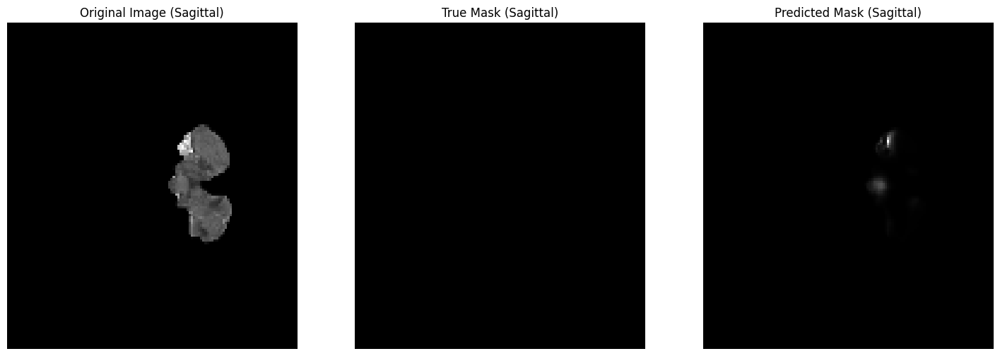

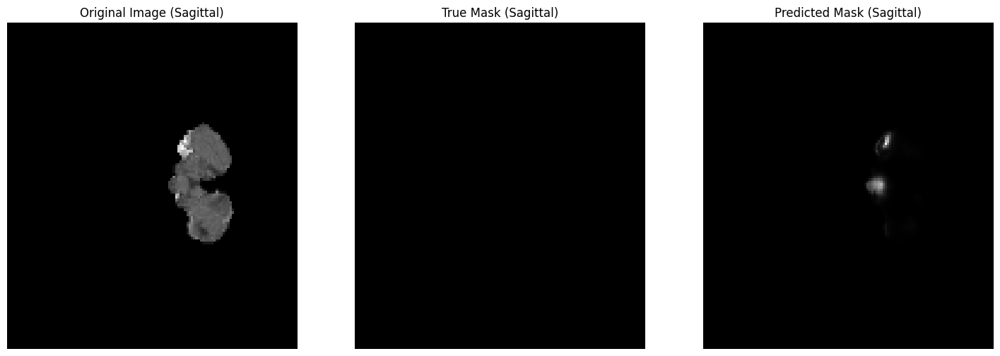

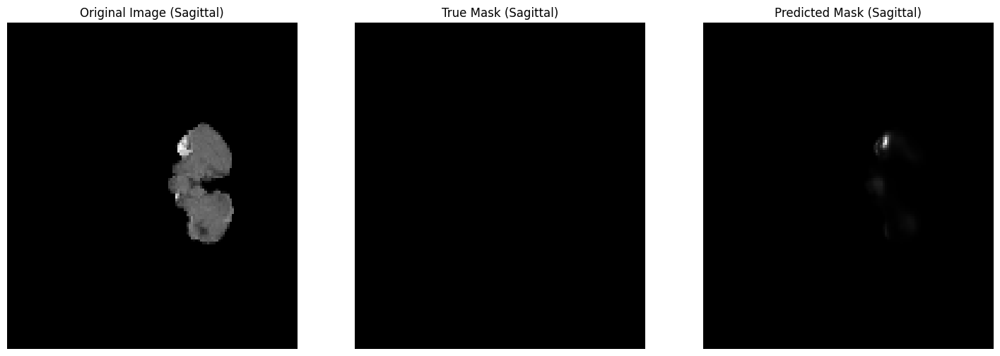

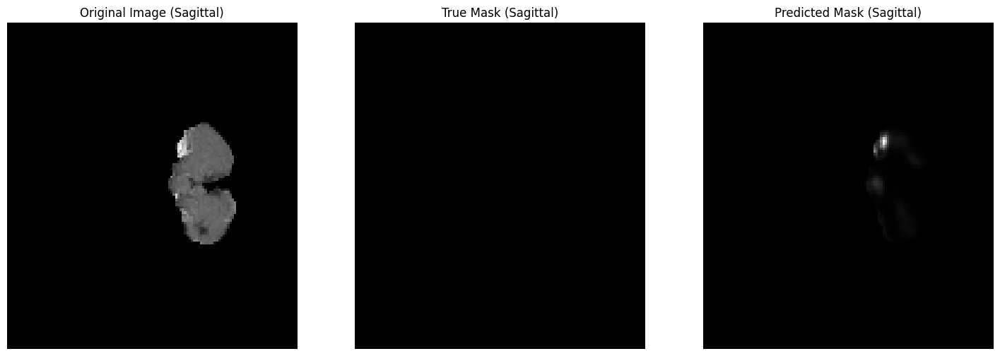

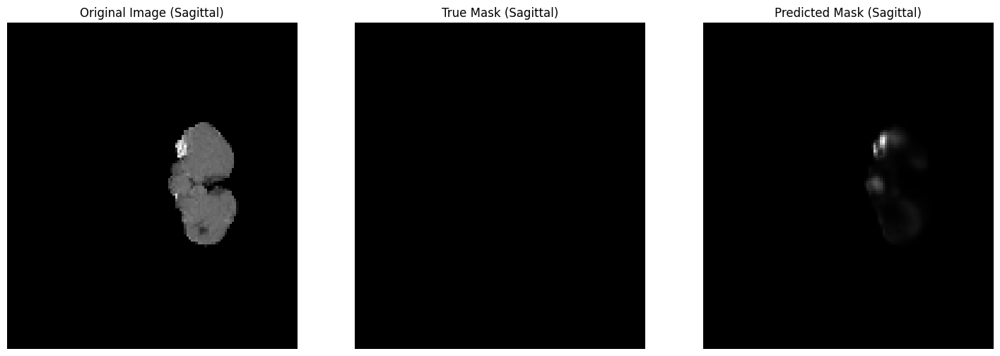

...

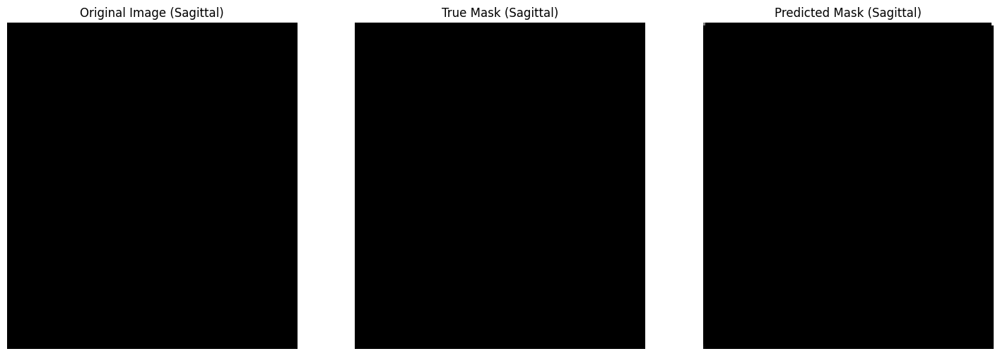

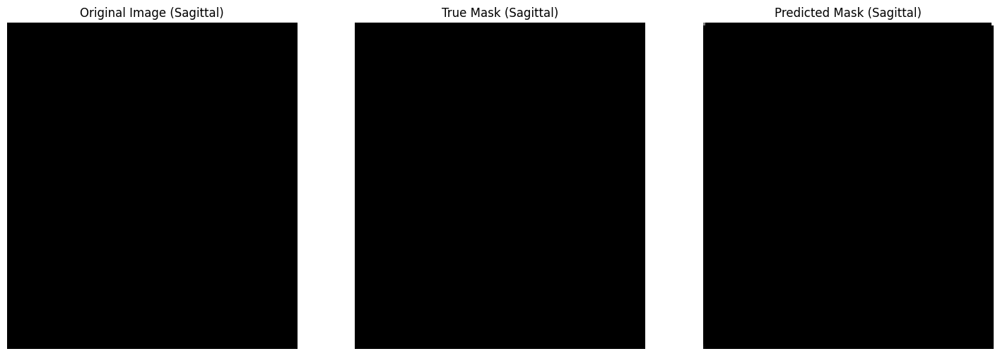

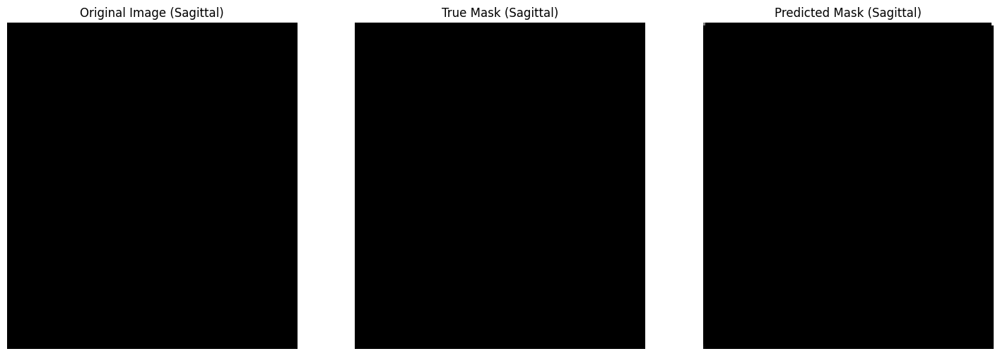

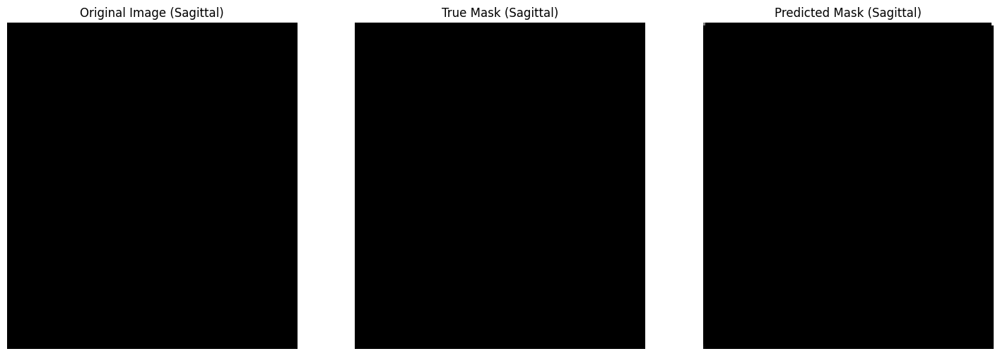

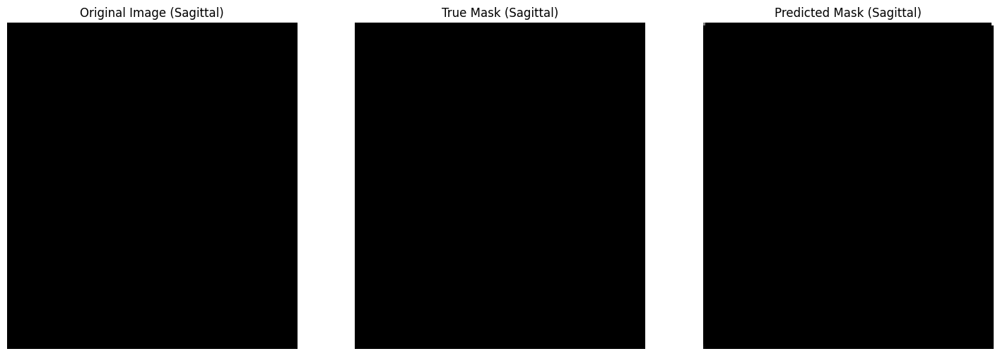

In [ ]:
# Visualize Sagittal Plane Segmentations
def plot_sagittal(image, true_mask, pred_mask):
    slice_index = image.shape[2] // 2  # Middle slice, adjust as needed
    plt.figure(figsize=(18, 6))

    plt.subplot(1, 3, 1)
    plt.imshow(image[:, :, slice_index], cmap='gray', aspect='auto')
    plt.title('Original Image (Sagittal)')
    plt.axis('off')

    plt.subplot(1, 3, 2)
    plt.imshow(true_mask[:, :, slice_index], cmap='gray', aspect='auto')
    plt.title('True Mask (Sagittal)')
    plt.axis('off')

    plt.subplot(1, 3, 3)
    plt.imshow(pred_mask[:, :, slice_index], cmap='gray', aspect='auto')
    plt.title('Predicted Mask (Sagittal)')
    plt.axis('off')

    plt.show()


for i in range(1):
    X_train, Y_train = training_generator[i]
    pred_masks = model.predict(X_train)

    for j in range(X_train.shape[0]):
        # Plot Sagittal
        plot_sagittal(X_train[j], Y_train[j], pred_masks[j])

5/5 [==============================] - 0s 18ms/step


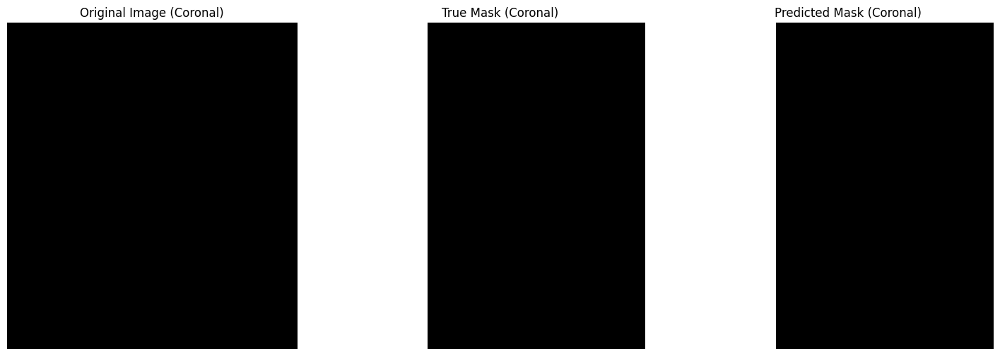

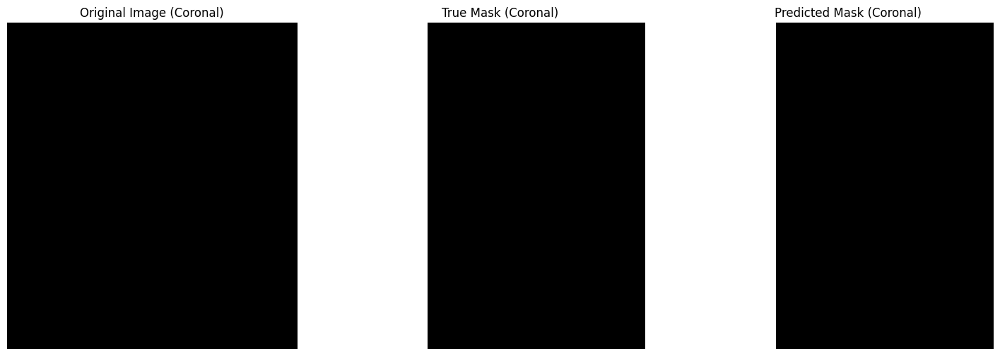

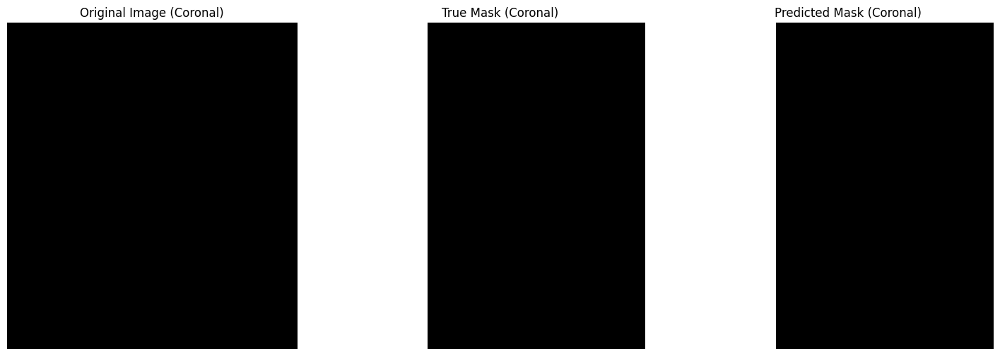

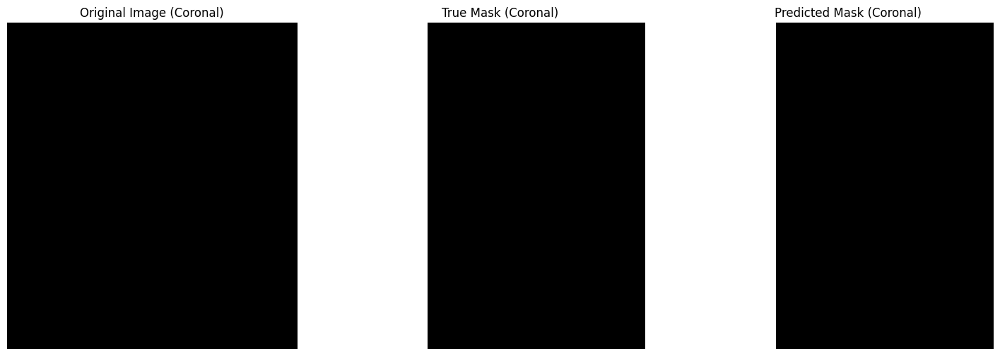

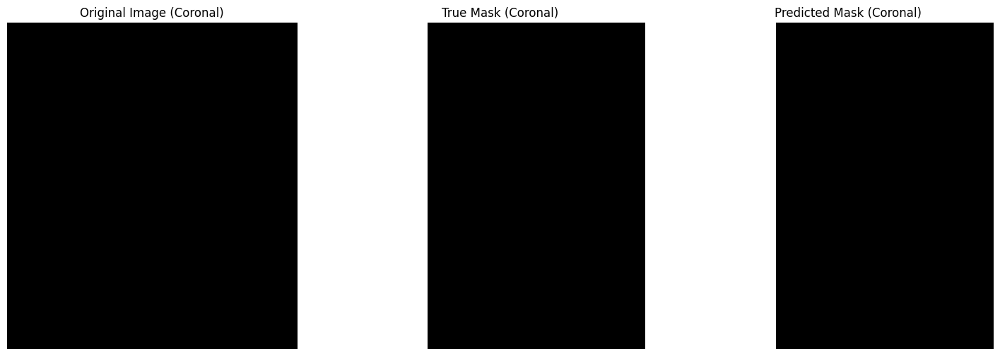

...

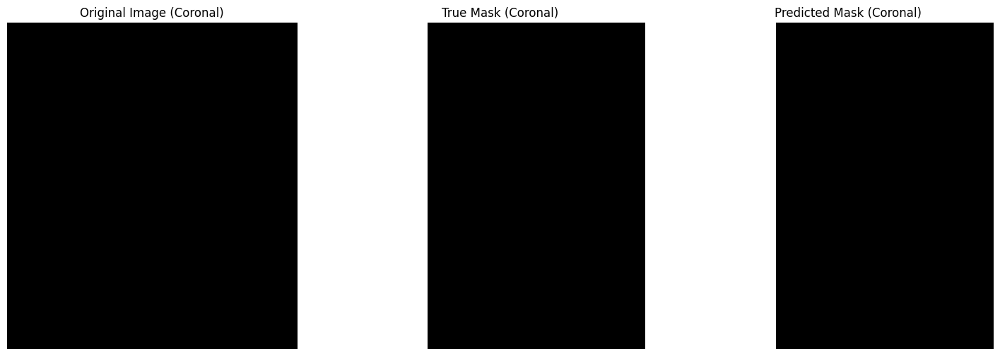

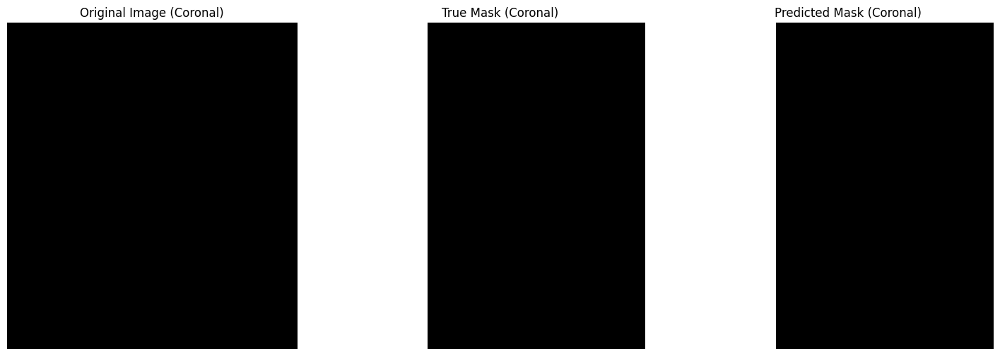

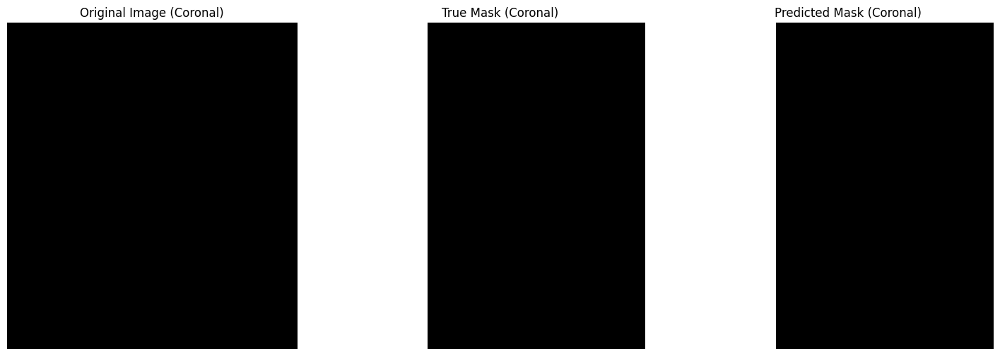

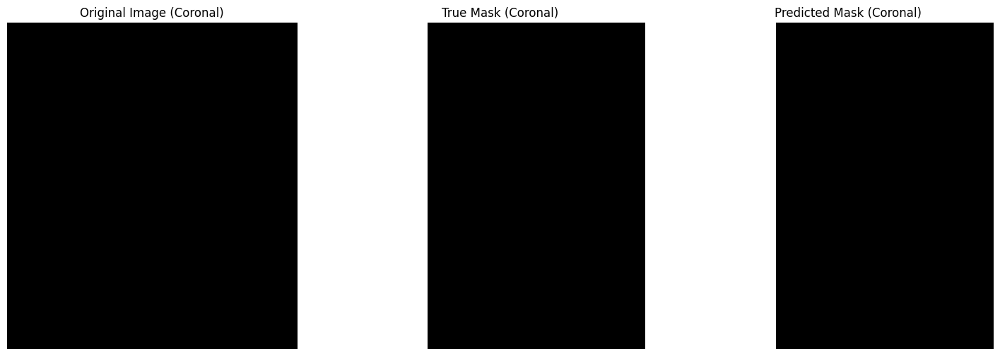

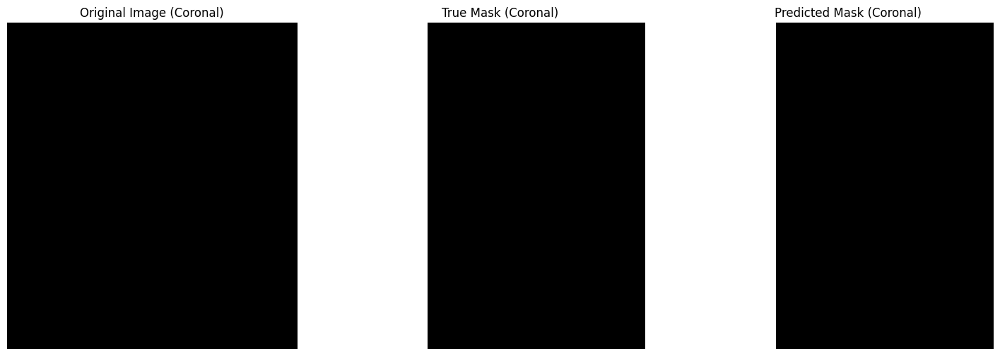

In [ ]:
# Visualize Coronal Plane Segmentations
# REMINDER FOR SAHBA / VEDANT
# FIX THIS CELL
def plot_coronal(image, true_mask, pred_mask):
    slice_index = image.shape[1] // 2  # Middle slice, adjust as needed
    plt.figure(figsize=(18, 6))

    plt.subplot(1, 3, 1)
    plt.imshow(image[:, slice_index, :], cmap='gray', aspect='auto')
    plt.title('Original Image (Coronal)')
    plt.axis('off')

    plt.subplot(1, 3, 2)
    plt.imshow(true_mask[:, slice_index, :], cmap='gray', aspect='auto')
    plt.title('True Mask (Coronal)')
    plt.axis('off')

    plt.subplot(1, 3, 3)
    plt.imshow(pred_mask[:, slice_index, :], cmap='gray', aspect='auto')
    plt.title('Predicted Mask (Coronal)')
    plt.axis('off')

    plt.show()

for i in range(1):
    X_train, Y_train = training_generator[i]
    pred_masks = model.predict(X_train)

    for j in range(X_train.shape[0]):
        # Plot Sagittal
        plot_coronal(X_train[j], Y_train[j], pred_masks[j])


# Visualize MRI Slice Predictions on Validation Data

In [ ]:
# # Load the MRI volumes
# flair_path = '/content/data/BraTS2020_ValidationData/MICCAI_BraTS2020_ValidationData/BraTS20_Validation_039/BraTS20_Validation_039_flair.nii'
# t1ce_path = '/content/data/BraTS2020_ValidationData/MICCAI_BraTS2020_ValidationData/BraTS20_Validation_039/BraTS20_Validation_039_t1ce.nii'

# flair_volume = nib.load(flair_path).get_fdata()
# t1ce_volume = nib.load(t1ce_path).get_fdata()

# # Normalize the volumes
# flair_volume = flair_volume / np.max(flair_volume)
# t1ce_volume = t1ce_volume / np.max(t1ce_volume)

# # Predict and visualize all slices
# num_slices = flair_volume.shape[1]
# num_slices2 = flair_volume.shape[2]

# print(num_slices)
# print(num_slices2)

1/1 [==============================] - 0s 266ms/step


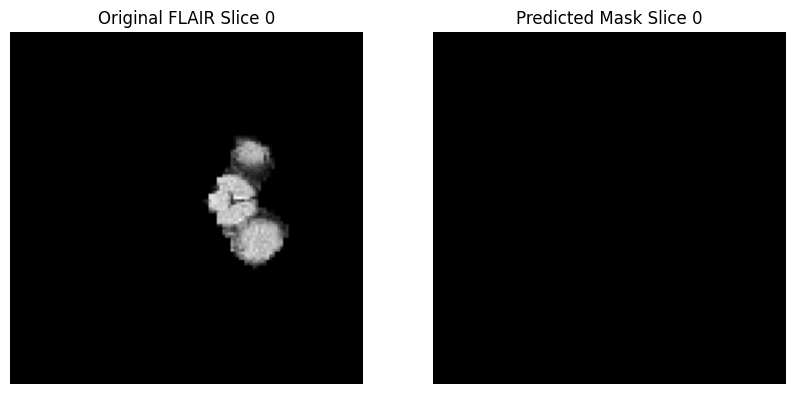

1/1 [==============================] - 0s 20ms/step


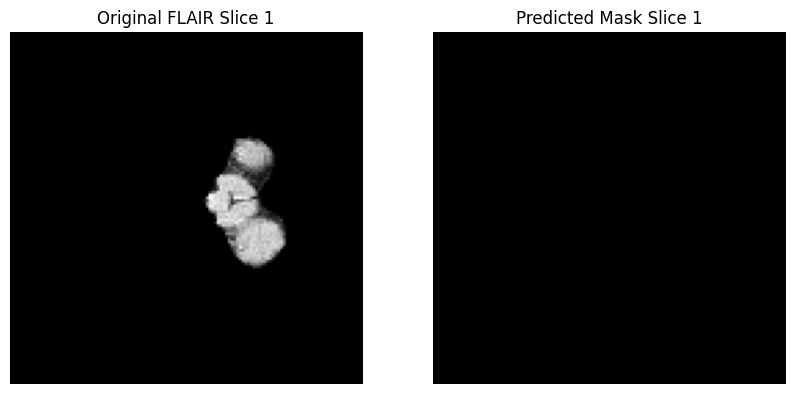

1/1 [==============================] - 0s 20ms/step


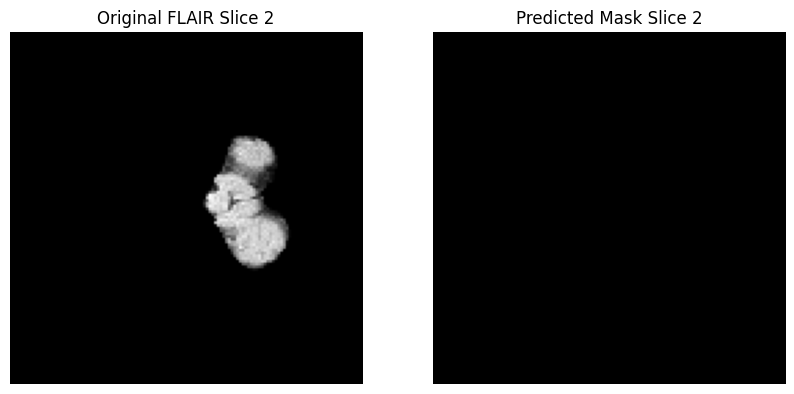

1/1 [==============================] - 0s 20ms/step


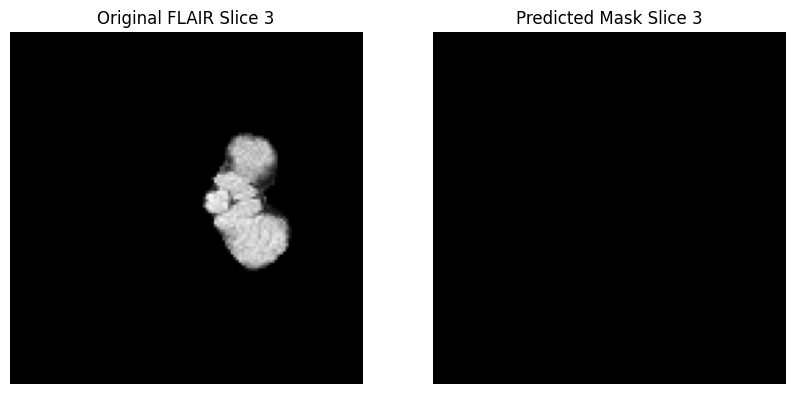

1/1 [==============================] - 0s 19ms/step


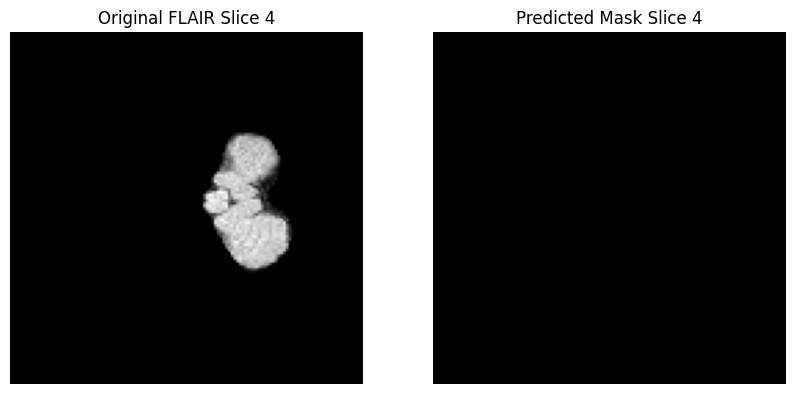

1/1 [==============================] - 0s 20ms/step


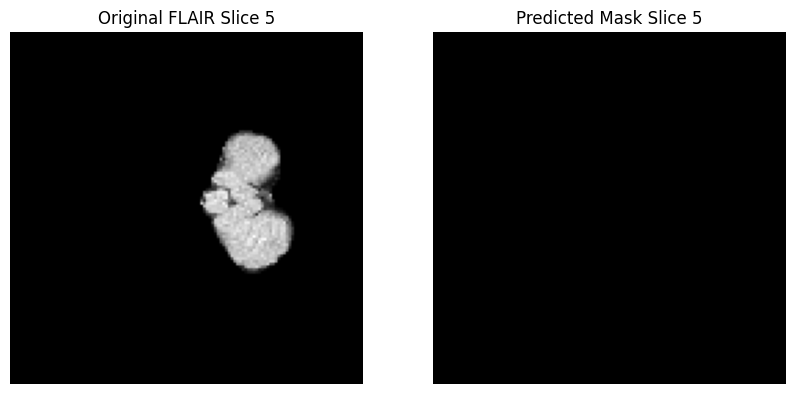

1/1 [==============================] - 0s 18ms/step


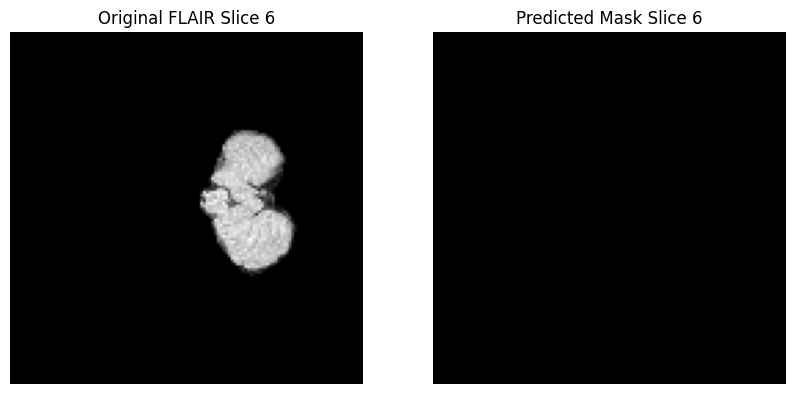

1/1 [==============================] - 0s 18ms/step


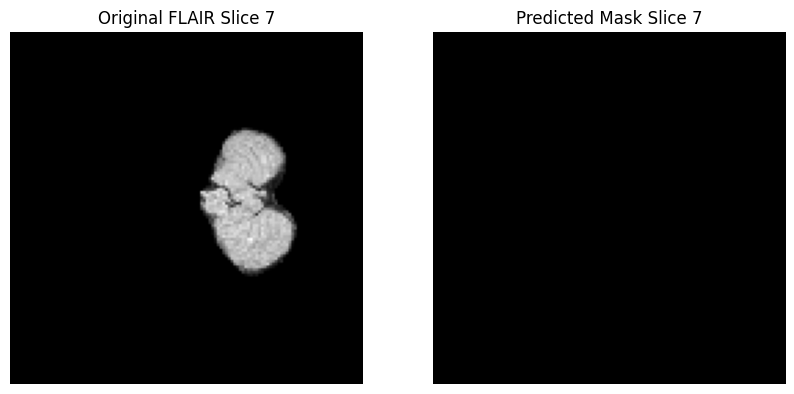

1/1 [==============================] - 0s 19ms/step


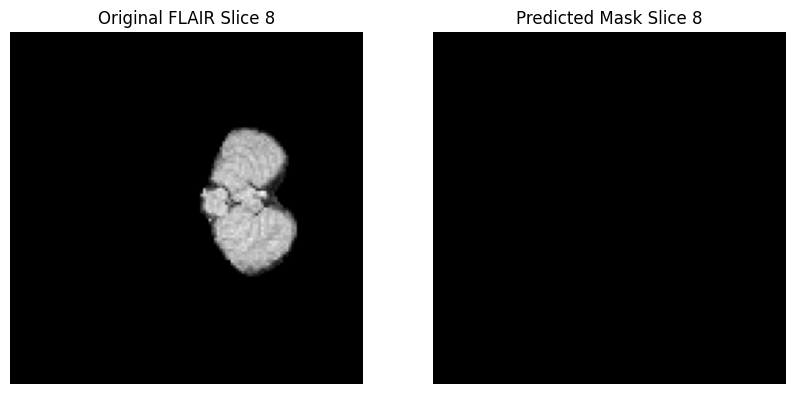

1/1 [==============================] - 0s 19ms/step


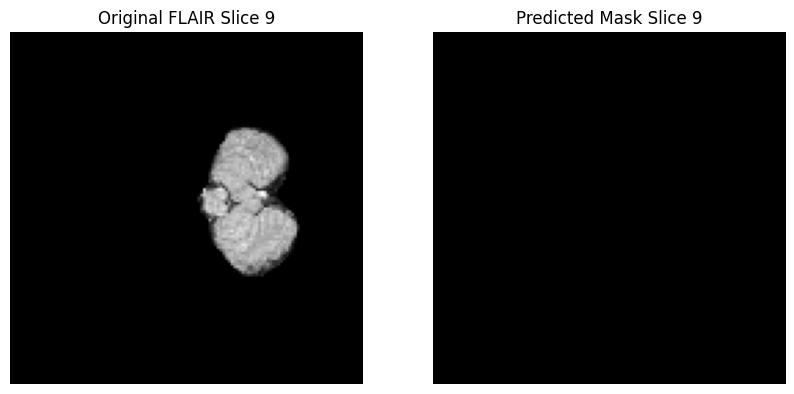

1/1 [==============================] - 0s 20ms/step


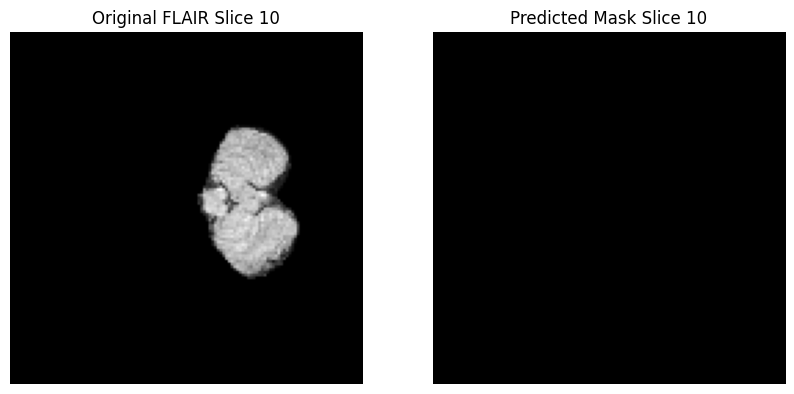

1/1 [==============================] - 0s 18ms/step


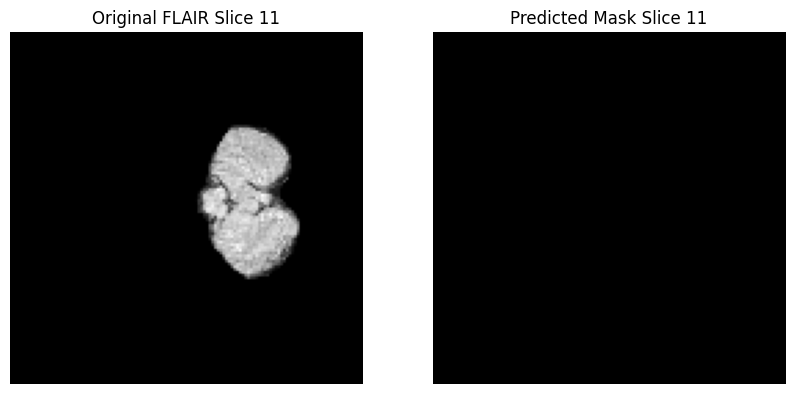

1/1 [==============================] - 0s 19ms/step


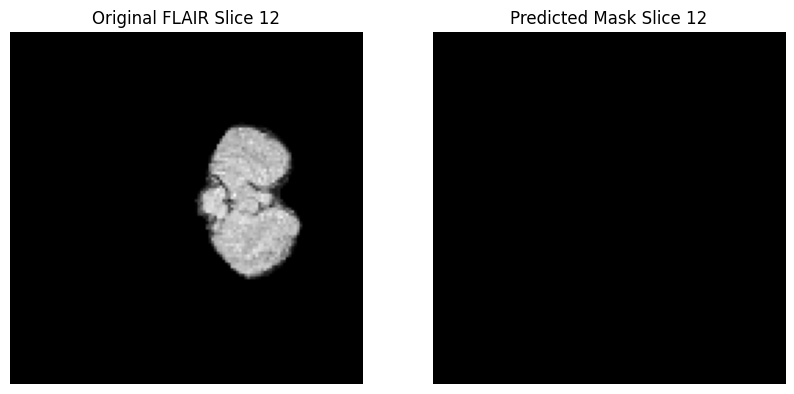

1/1 [==============================] - 0s 18ms/step


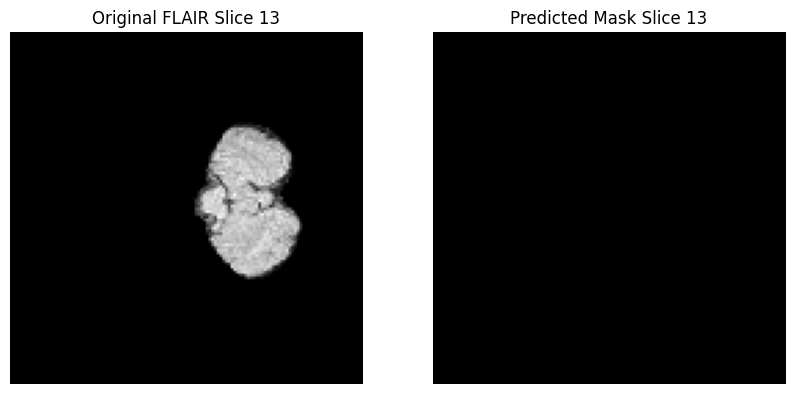

1/1 [==============================] - 0s 18ms/step


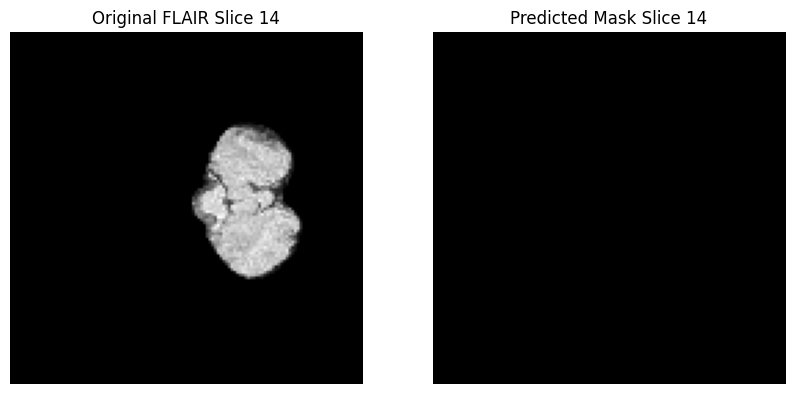

1/1 [==============================] - 0s 19ms/step


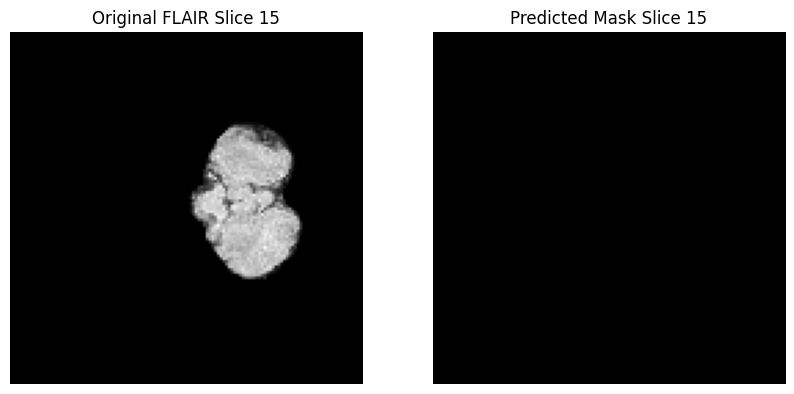

1/1 [==============================] - 0s 18ms/step


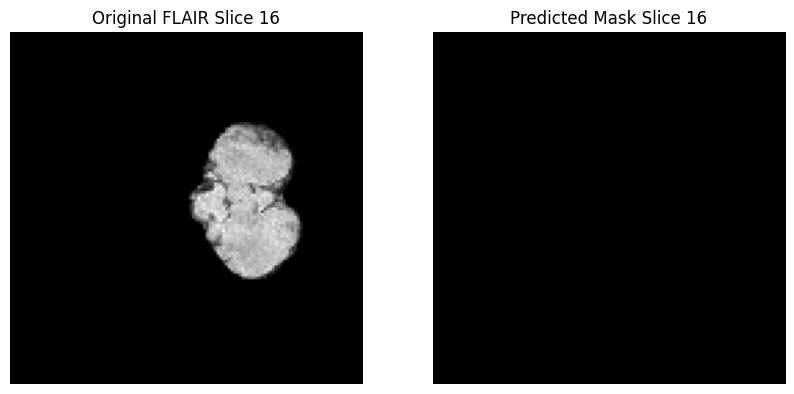

1/1 [==============================] - 0s 19ms/step


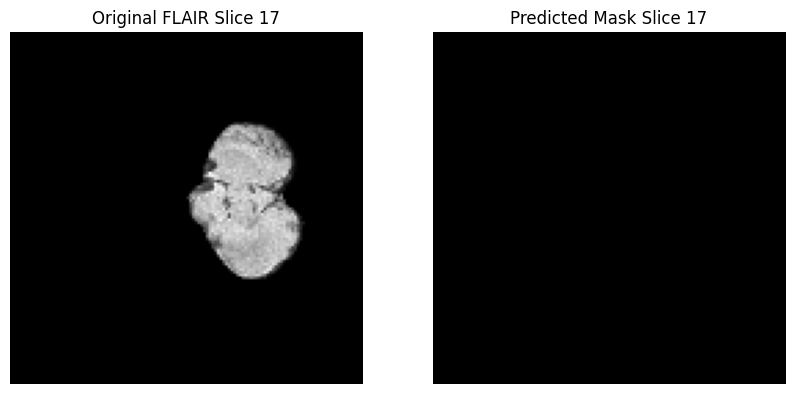

1/1 [==============================] - 0s 18ms/step


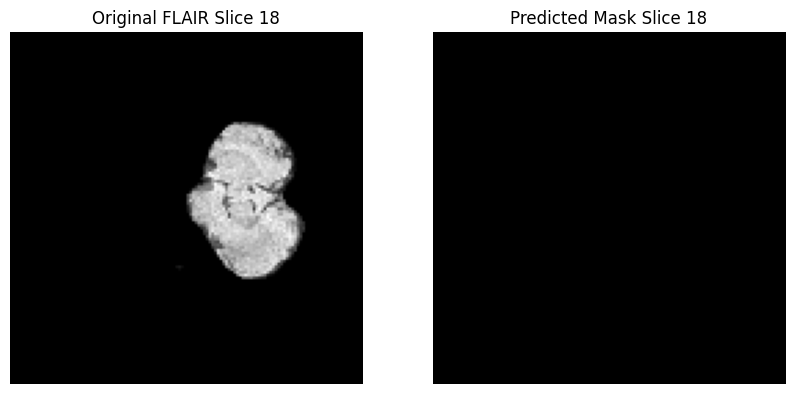

1/1 [==============================] - 0s 21ms/step


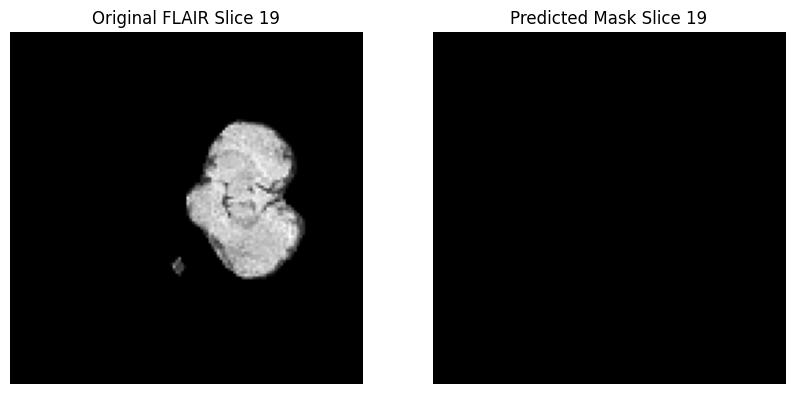

1/1 [==============================] - 0s 19ms/step


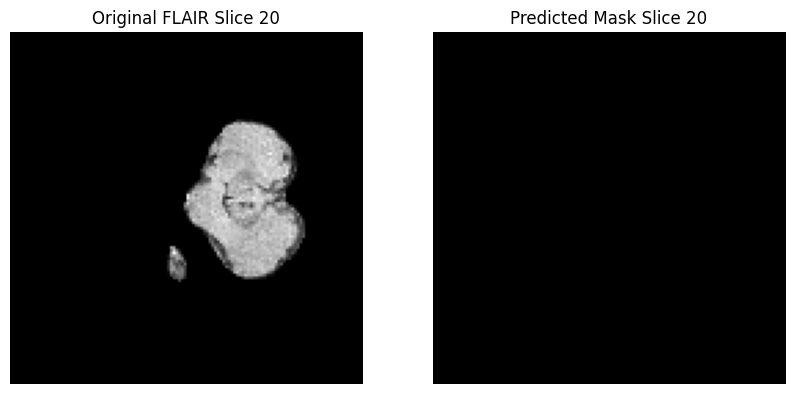

1/1 [==============================] - 0s 21ms/step


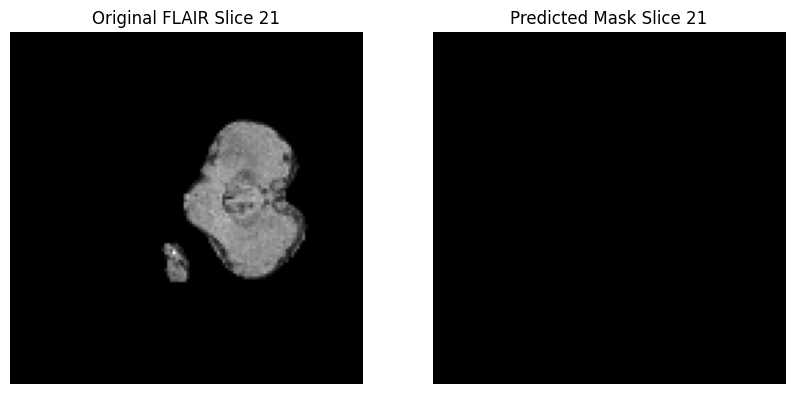

1/1 [==============================] - 0s 20ms/step


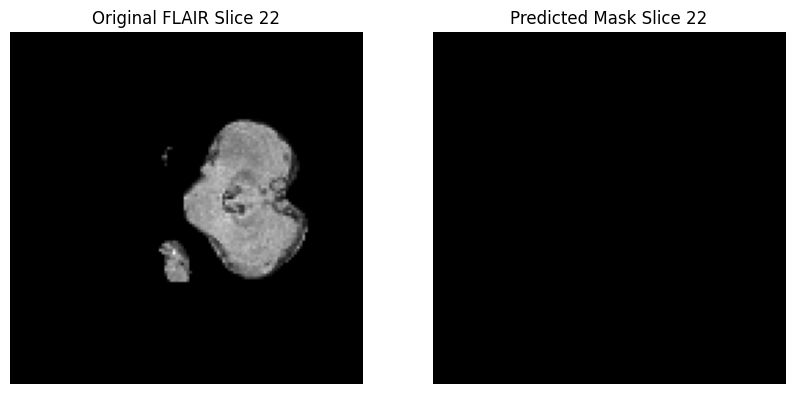

1/1 [==============================] - 0s 19ms/step


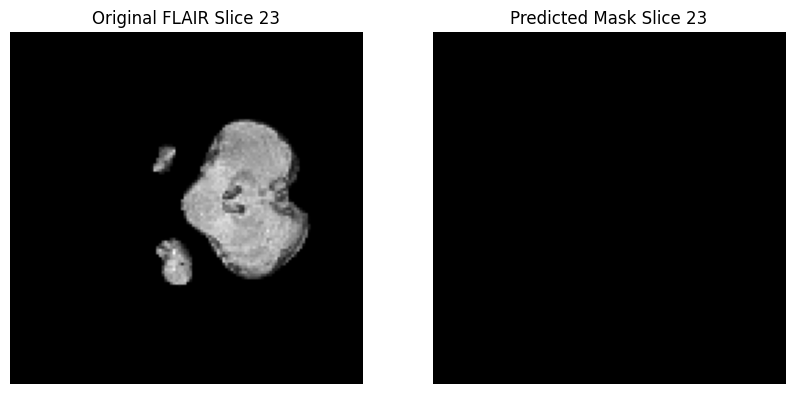

1/1 [==============================] - 0s 20ms/step


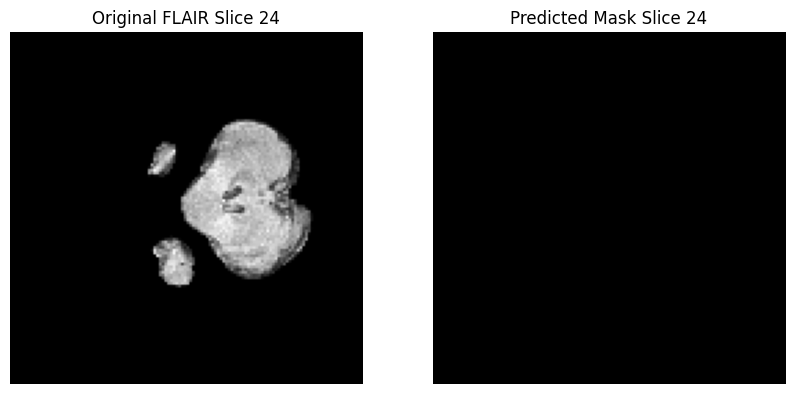

1/1 [==============================] - 0s 21ms/step


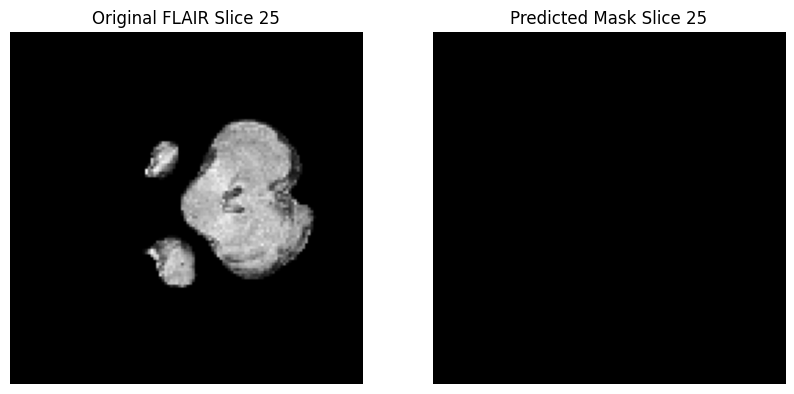

1/1 [==============================] - 0s 19ms/step


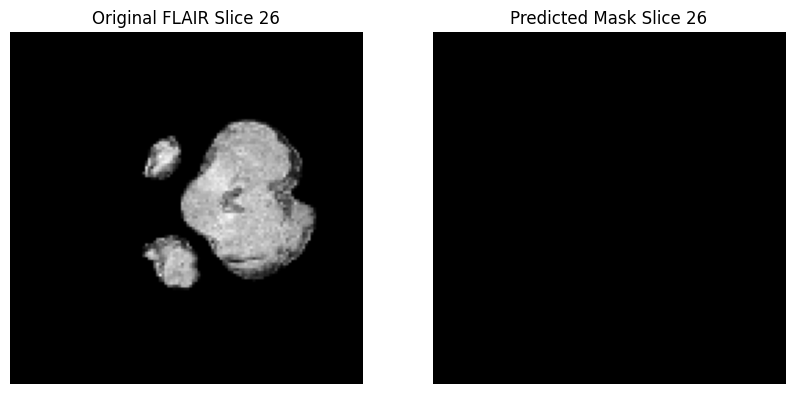

1/1 [==============================] - 0s 20ms/step


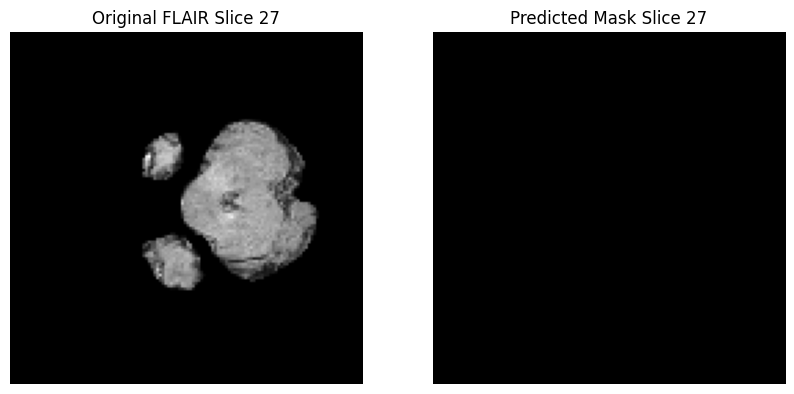

1/1 [==============================] - 0s 20ms/step


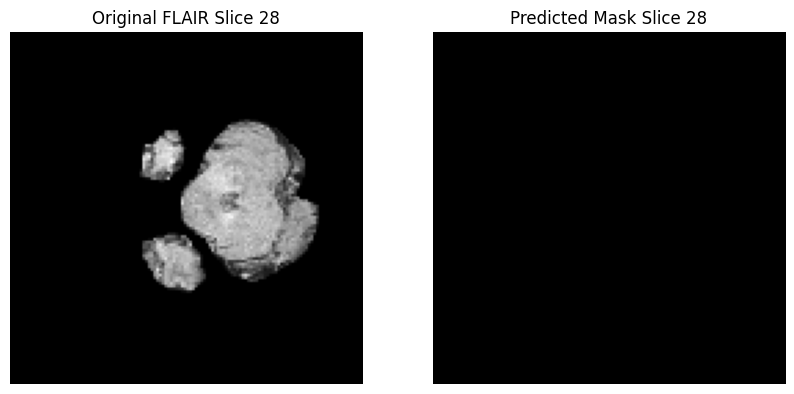

1/1 [==============================] - 0s 19ms/step


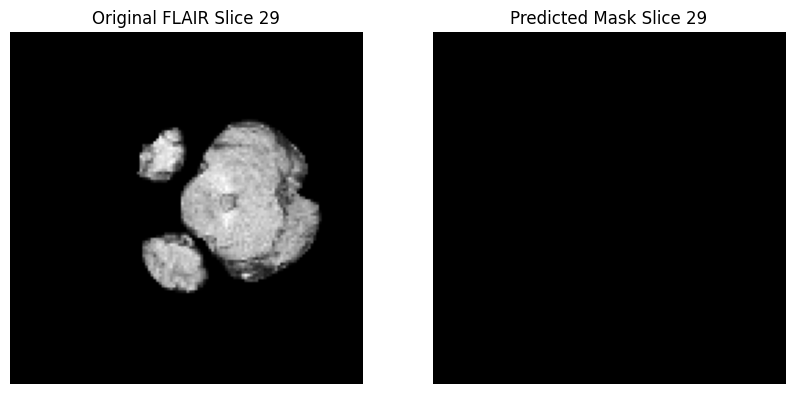

1/1 [==============================] - 0s 20ms/step


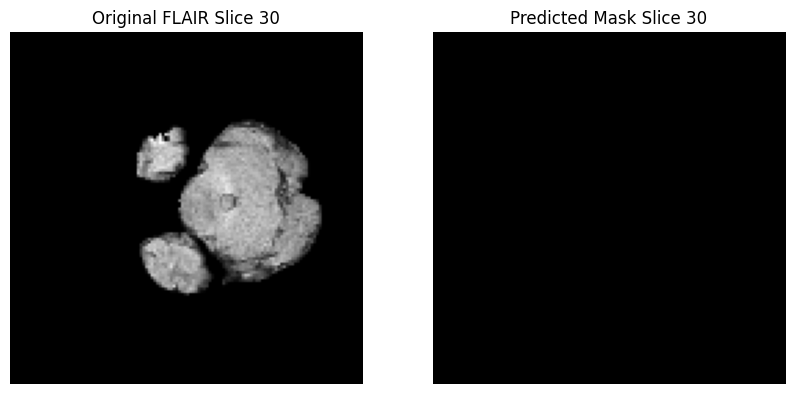

1/1 [==============================] - 0s 19ms/step


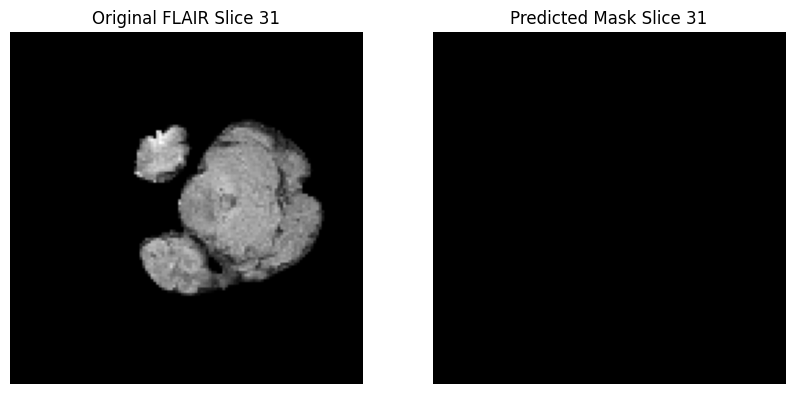

1/1 [==============================] - 0s 21ms/step


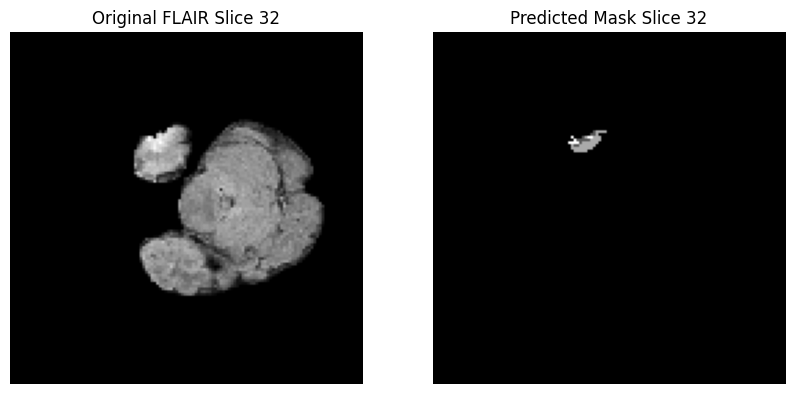

1/1 [==============================] - 0s 19ms/step


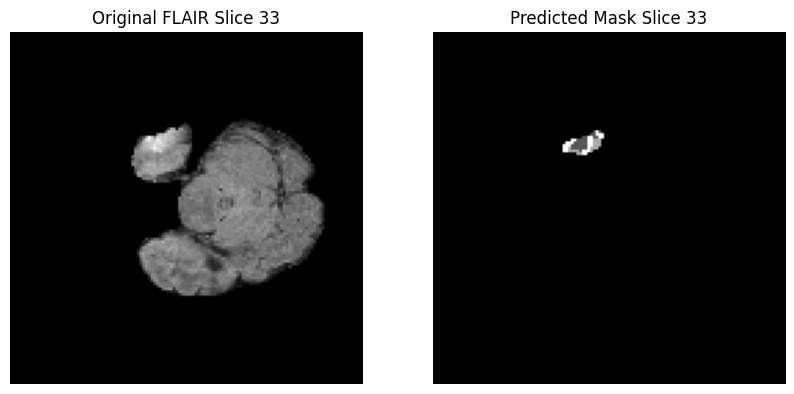

1/1 [==============================] - 0s 20ms/step


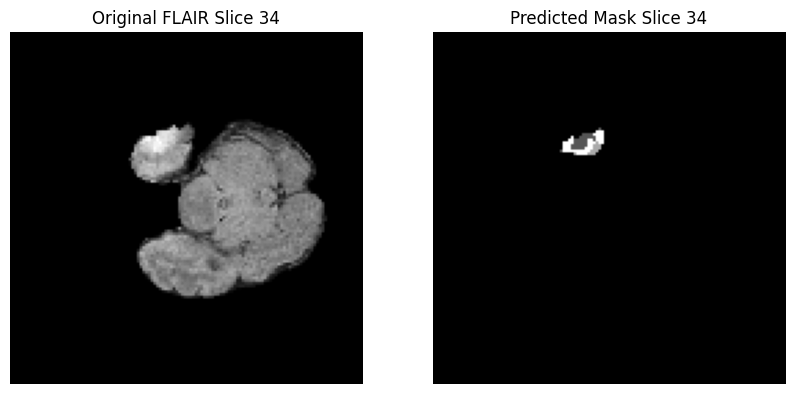

1/1 [==============================] - 0s 21ms/step


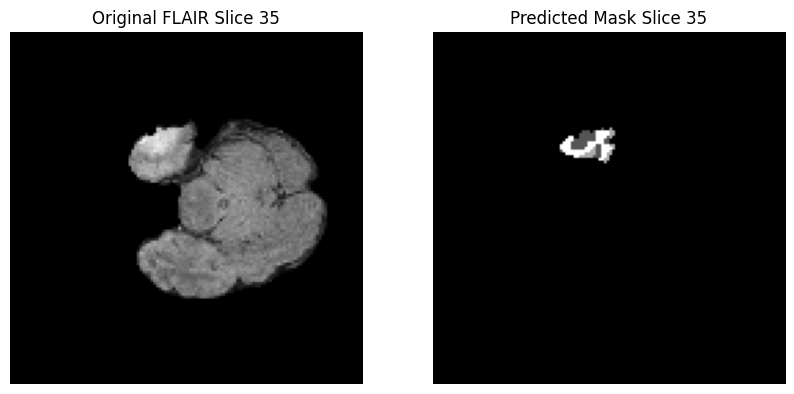

1/1 [==============================] - 0s 19ms/step


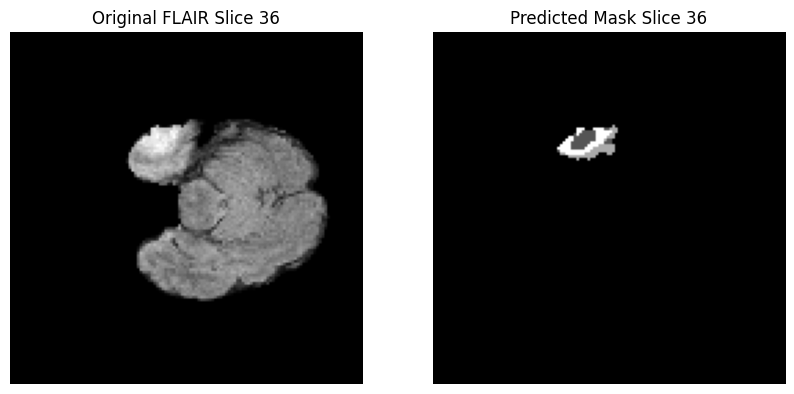

1/1 [==============================] - 0s 18ms/step


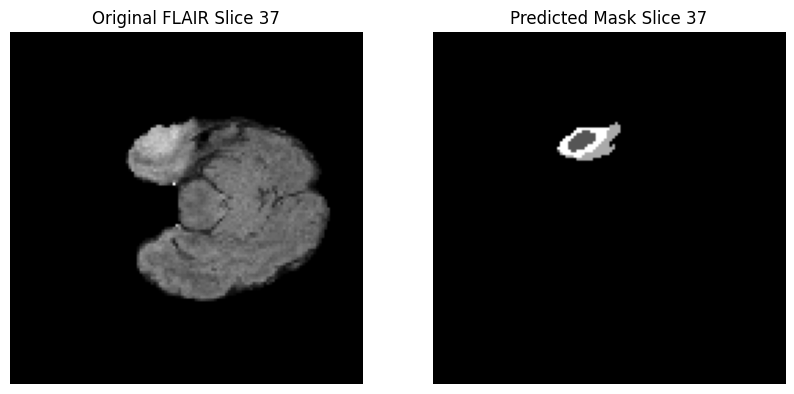

1/1 [==============================] - 0s 19ms/step


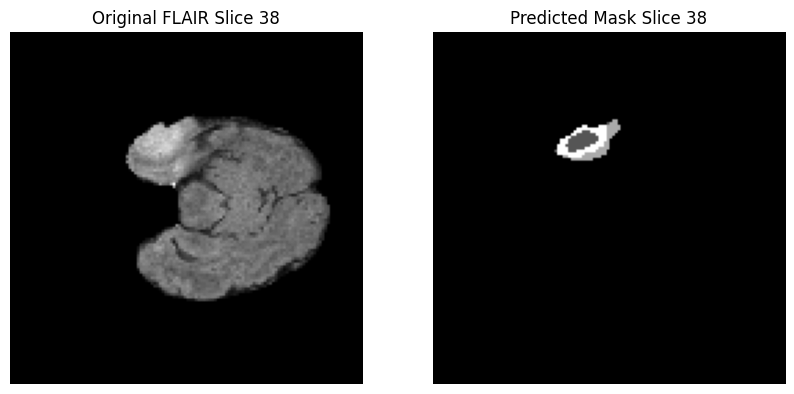

1/1 [==============================] - 0s 20ms/step


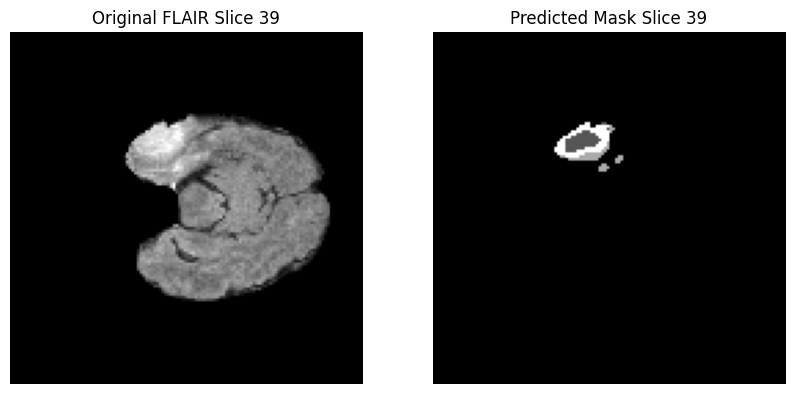

1/1 [==============================] - 0s 21ms/step


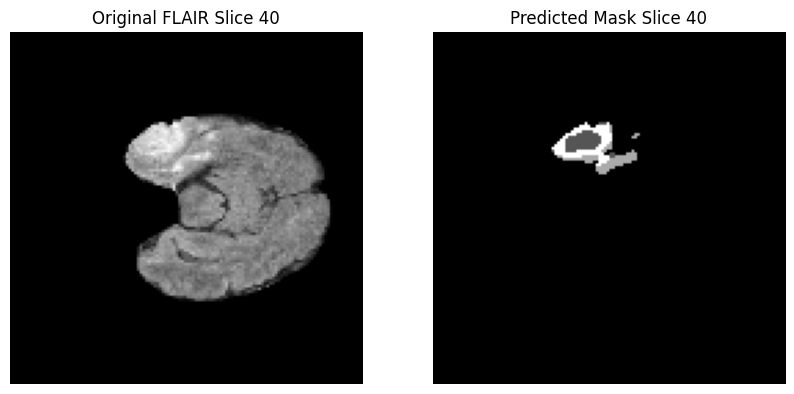

1/1 [==============================] - 0s 19ms/step


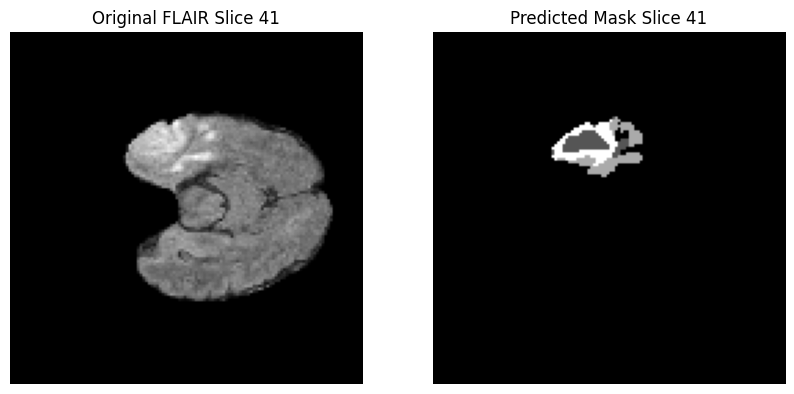

1/1 [==============================] - 0s 20ms/step


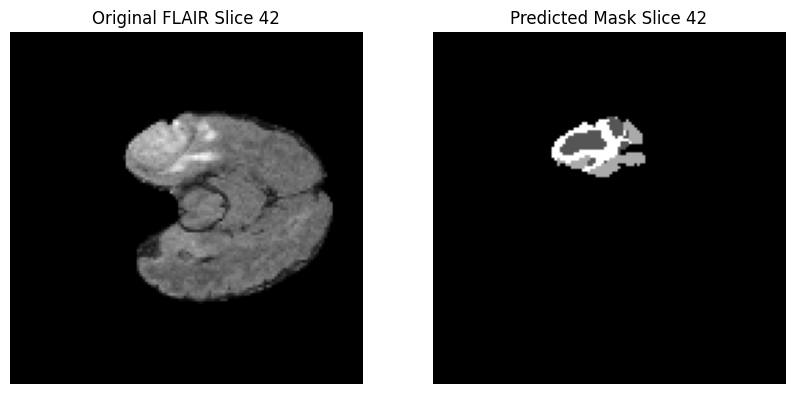

1/1 [==============================] - 0s 20ms/step


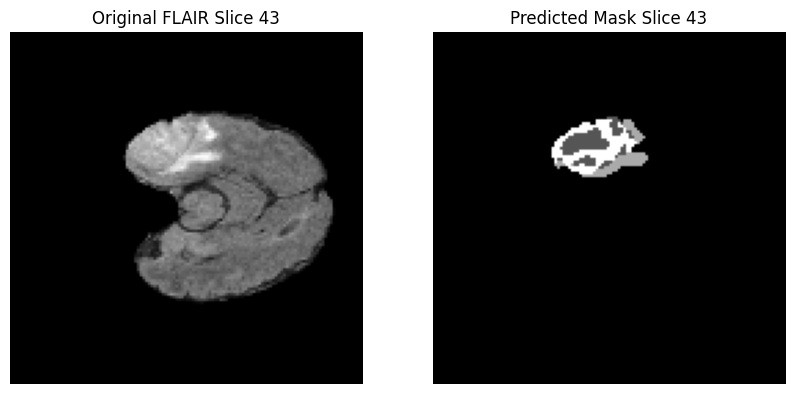

1/1 [==============================] - 0s 18ms/step


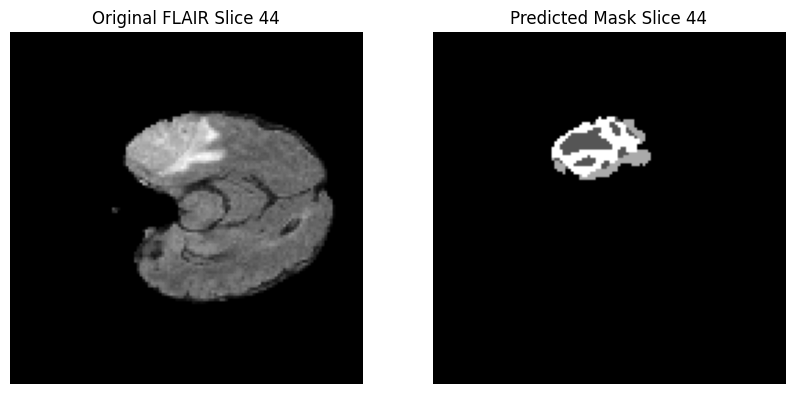

1/1 [==============================] - 0s 20ms/step


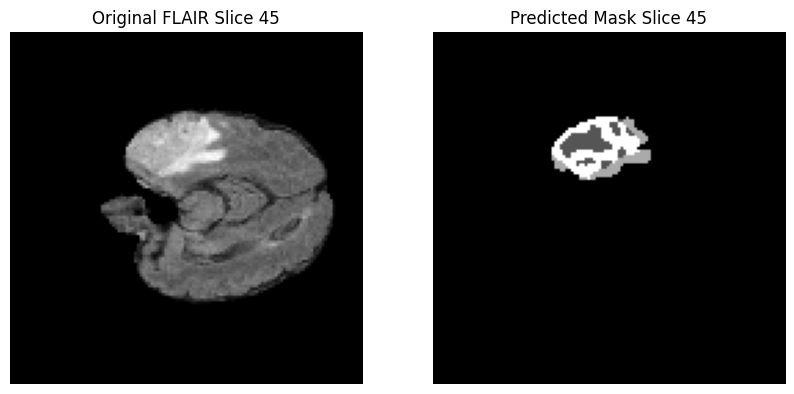

1/1 [==============================] - 0s 20ms/step


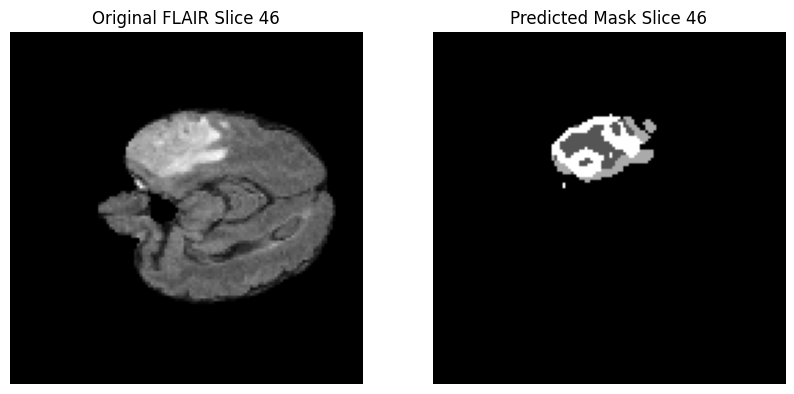

1/1 [==============================] - 0s 18ms/step


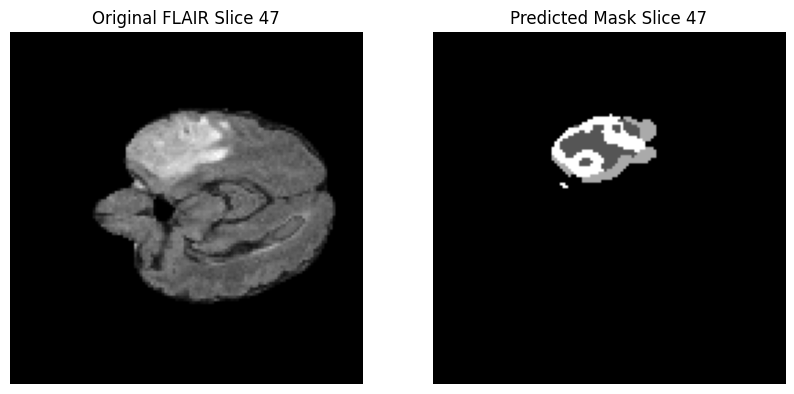

1/1 [==============================] - 0s 19ms/step


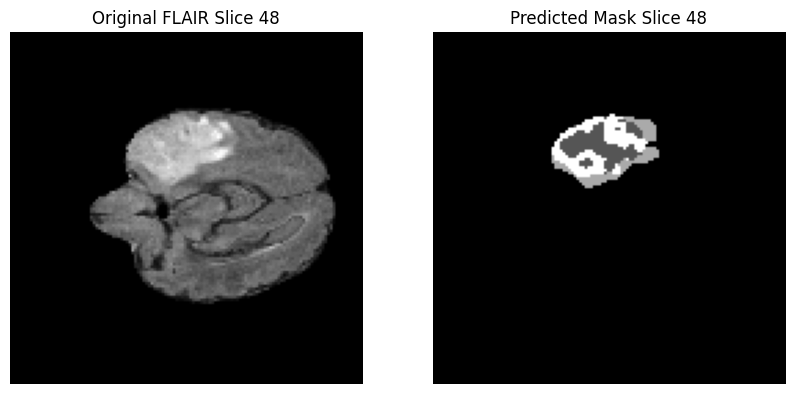

1/1 [==============================] - 0s 21ms/step


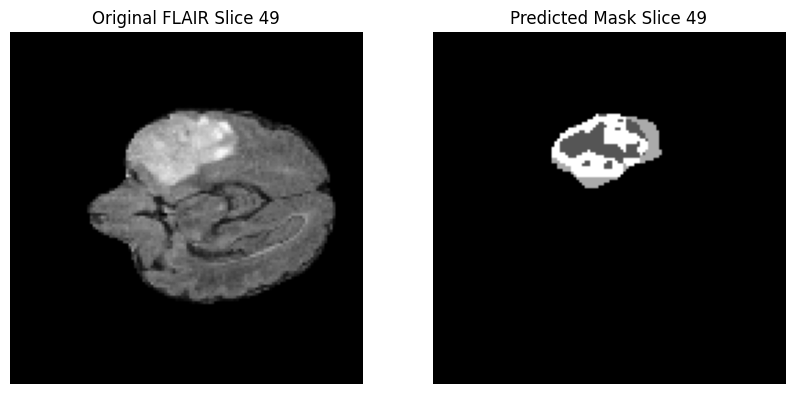

1/1 [==============================] - 0s 22ms/step


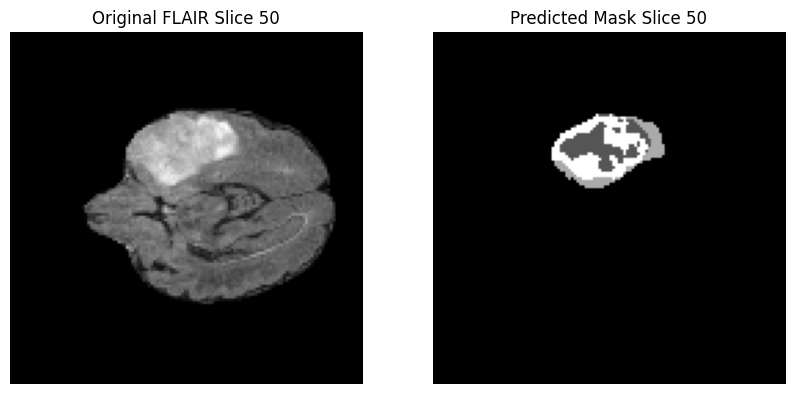

1/1 [==============================] - 0s 21ms/step


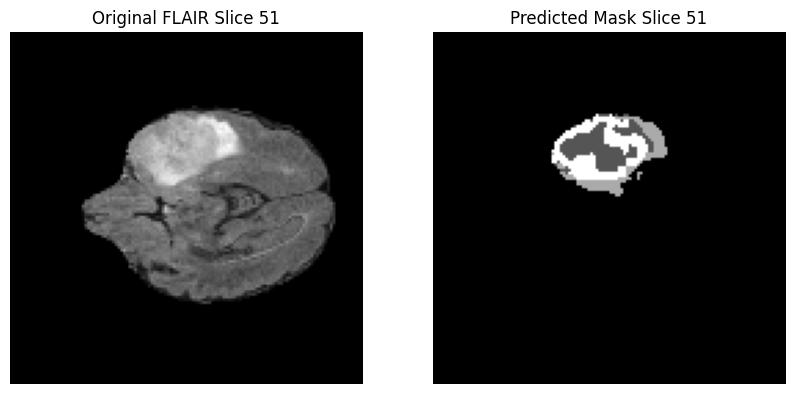

1/1 [==============================] - 0s 20ms/step


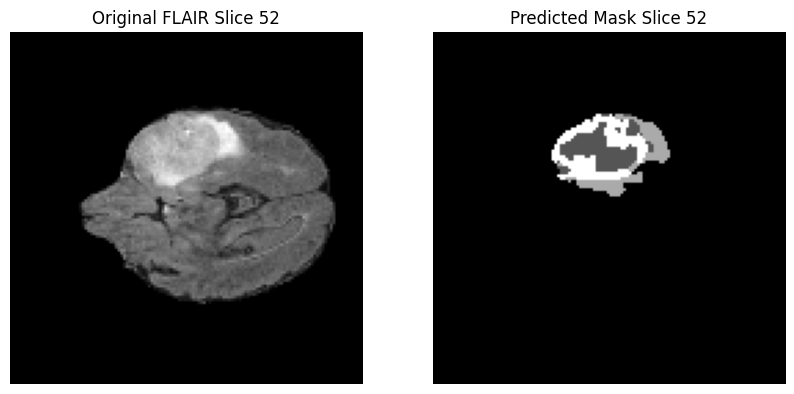

1/1 [==============================] - 0s 19ms/step


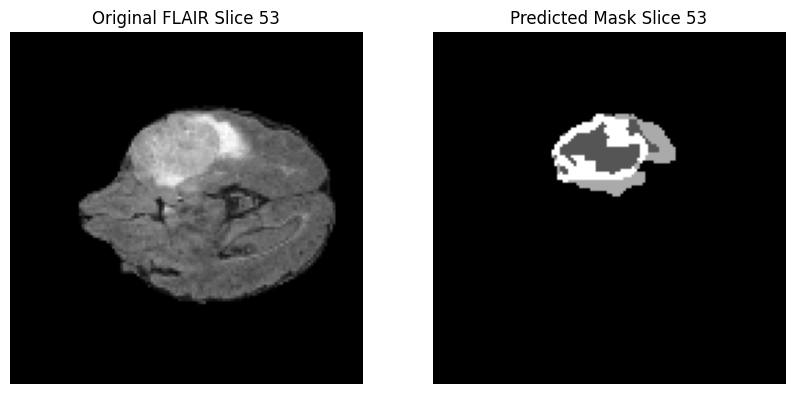

1/1 [==============================] - 0s 22ms/step


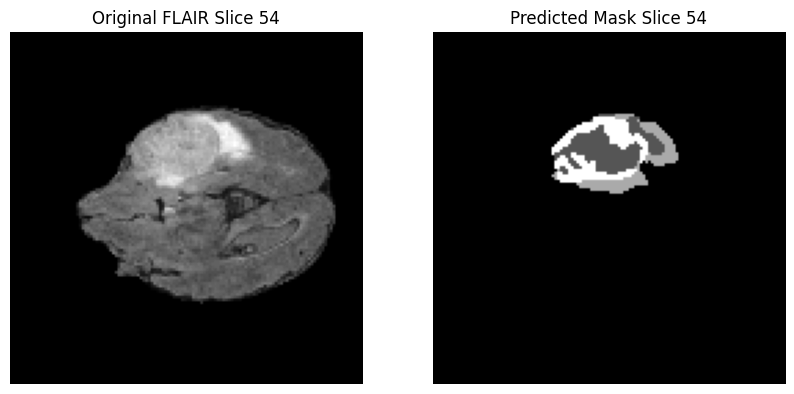

1/1 [==============================] - 0s 19ms/step


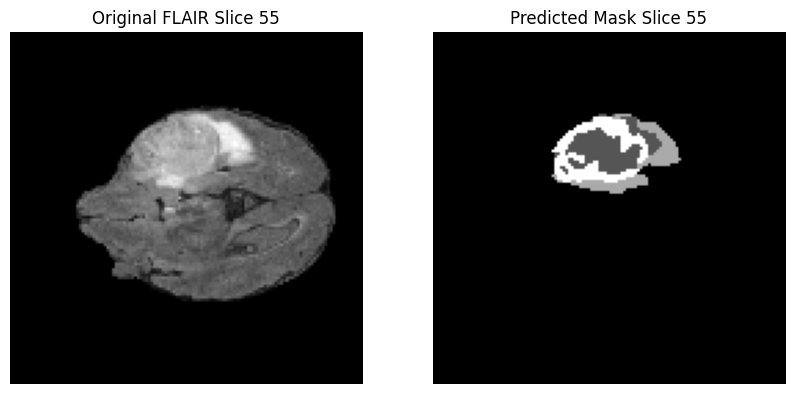

1/1 [==============================] - 0s 20ms/step


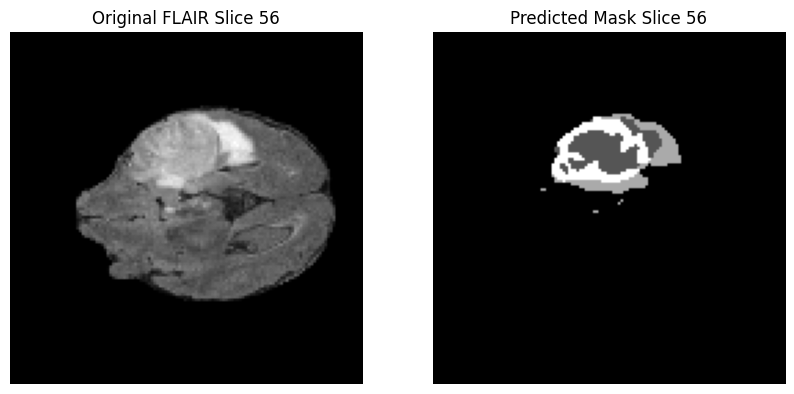

1/1 [==============================] - 0s 22ms/step


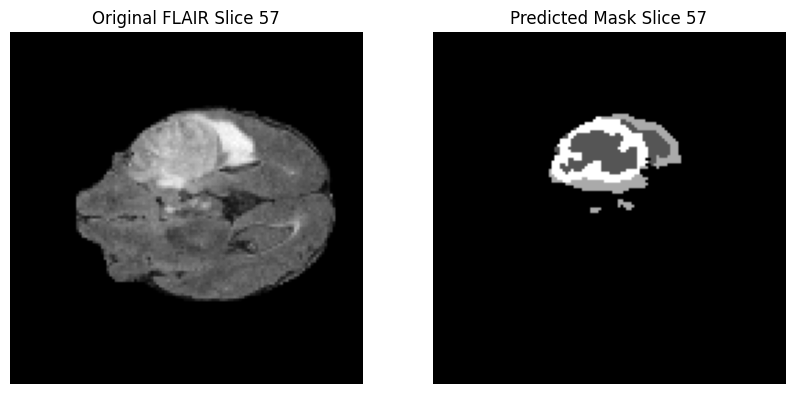

1/1 [==============================] - 0s 19ms/step


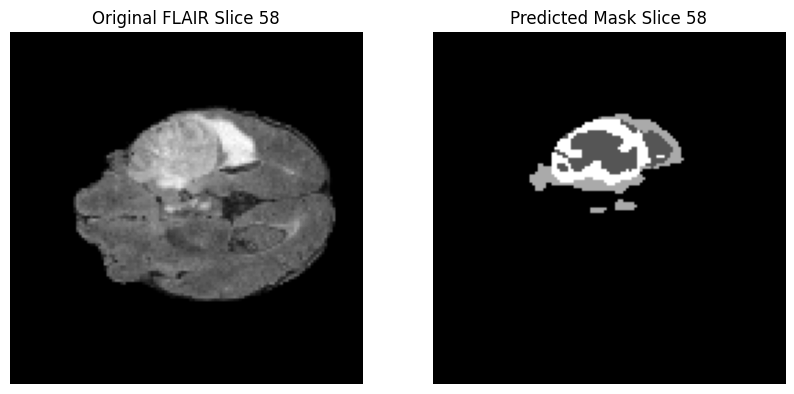

1/1 [==============================] - 0s 18ms/step


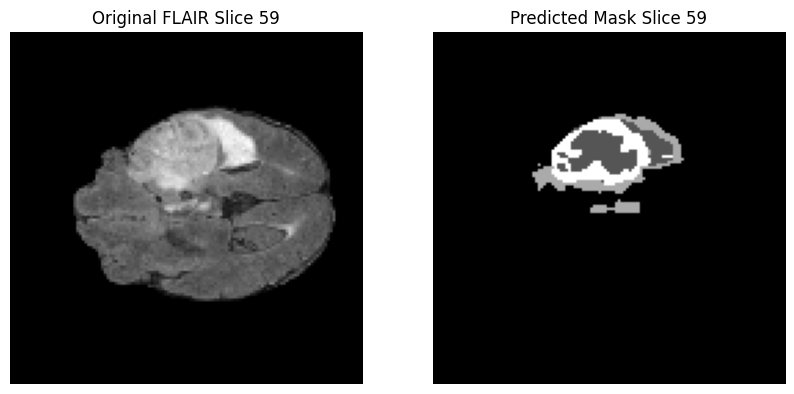

1/1 [==============================] - 0s 20ms/step


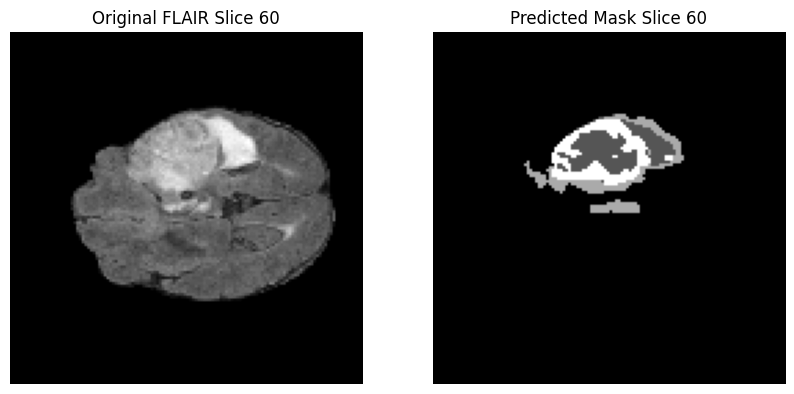

1/1 [==============================] - 0s 19ms/step


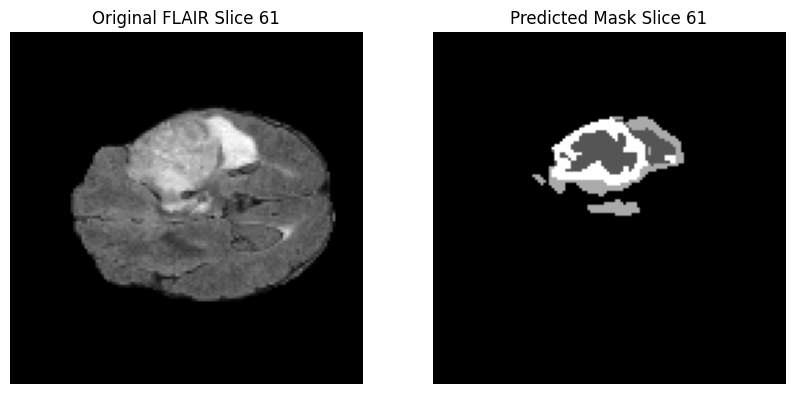

1/1 [==============================] - 0s 20ms/step


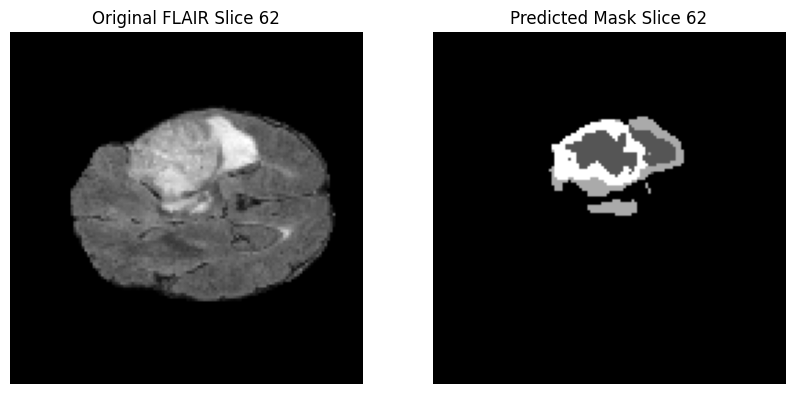

1/1 [==============================] - 0s 19ms/step


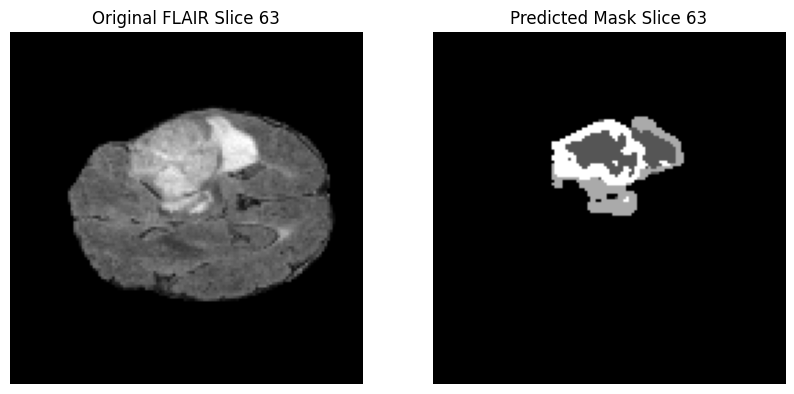

1/1 [==============================] - 0s 20ms/step


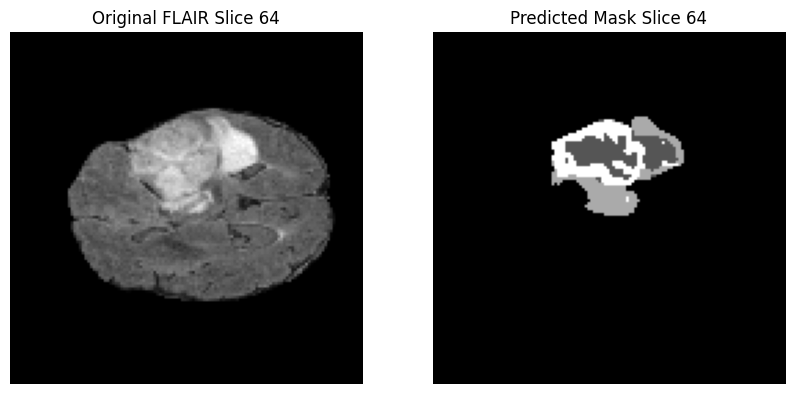

1/1 [==============================] - 0s 20ms/step


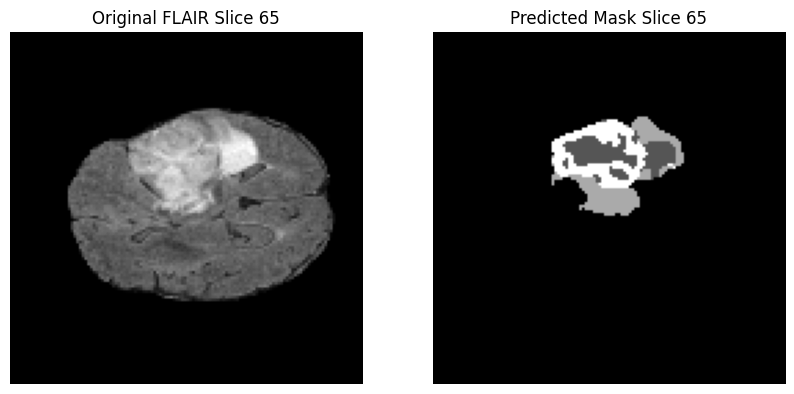

1/1 [==============================] - 0s 19ms/step


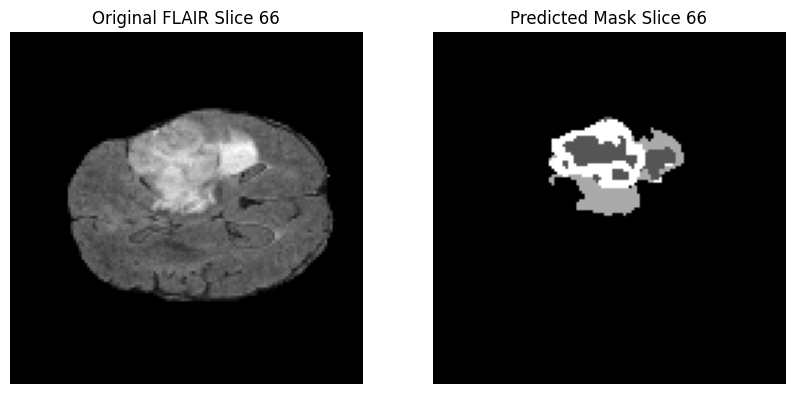

1/1 [==============================] - 0s 21ms/step


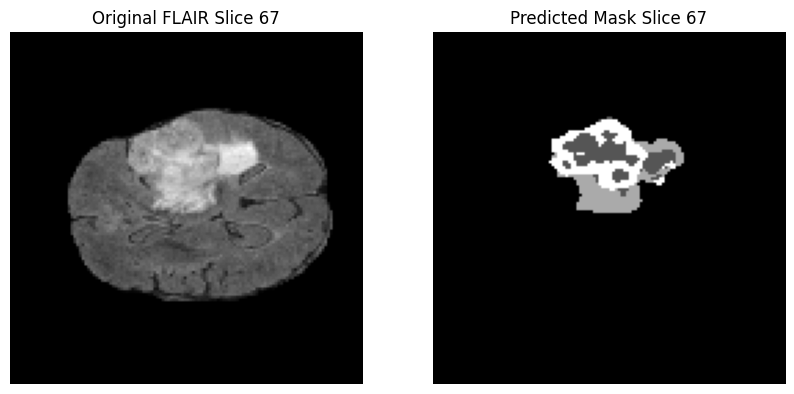

1/1 [==============================] - 0s 19ms/step


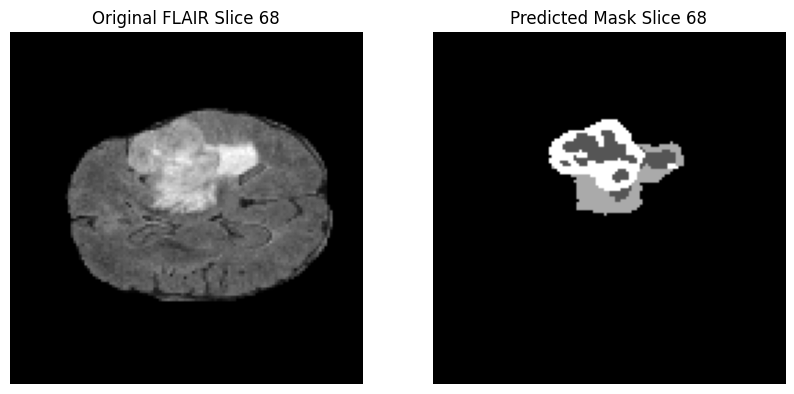

1/1 [==============================] - 0s 21ms/step


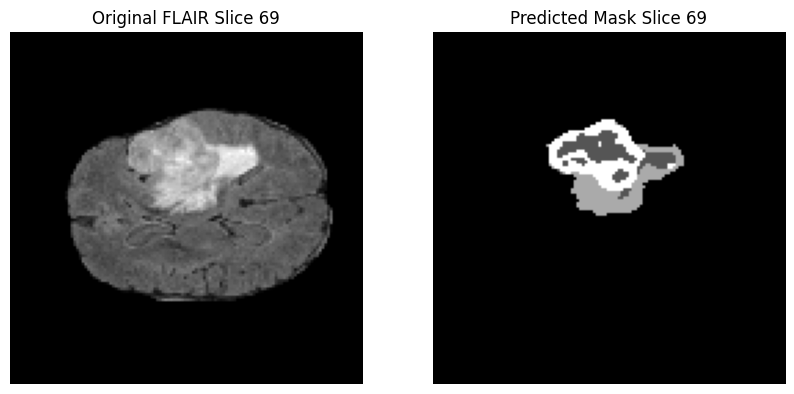

1/1 [==============================] - 0s 18ms/step


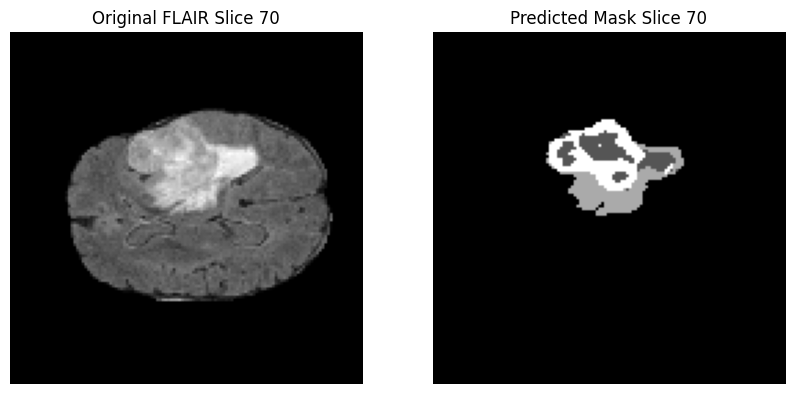

1/1 [==============================] - 0s 19ms/step


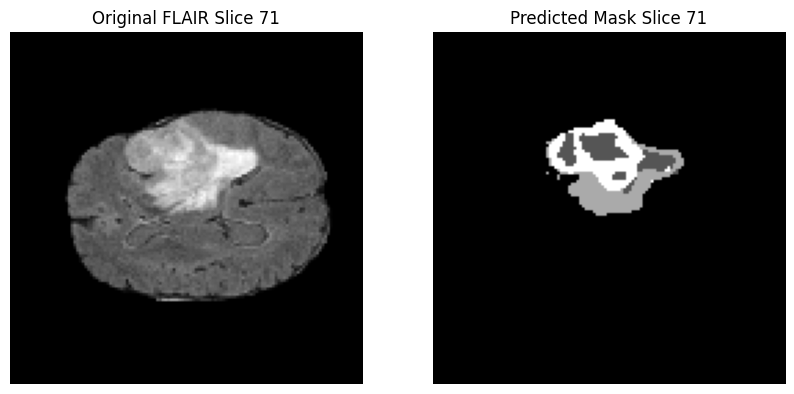

1/1 [==============================] - 0s 20ms/step


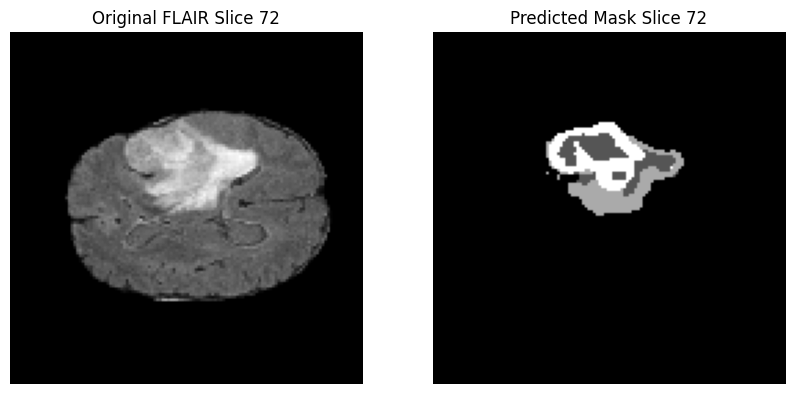

1/1 [==============================] - 0s 20ms/step


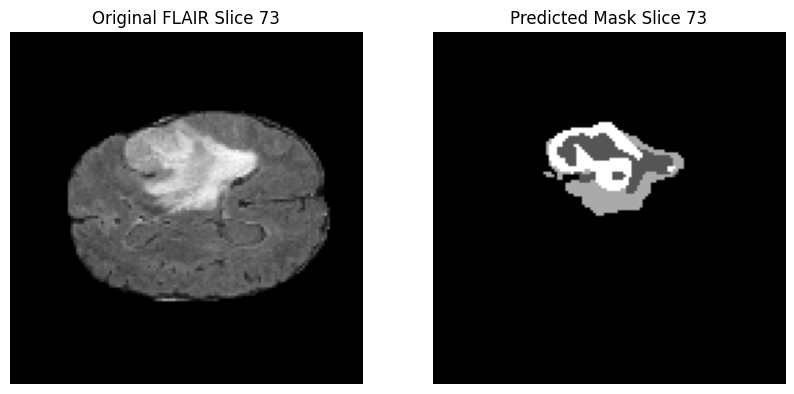

1/1 [==============================] - 0s 20ms/step


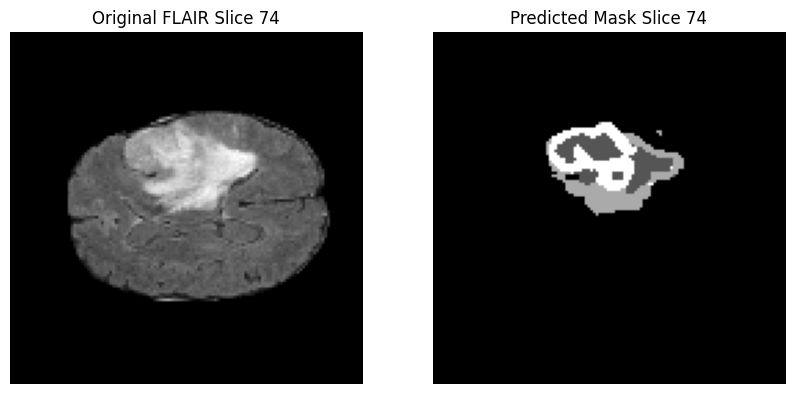

1/1 [==============================] - 0s 22ms/step


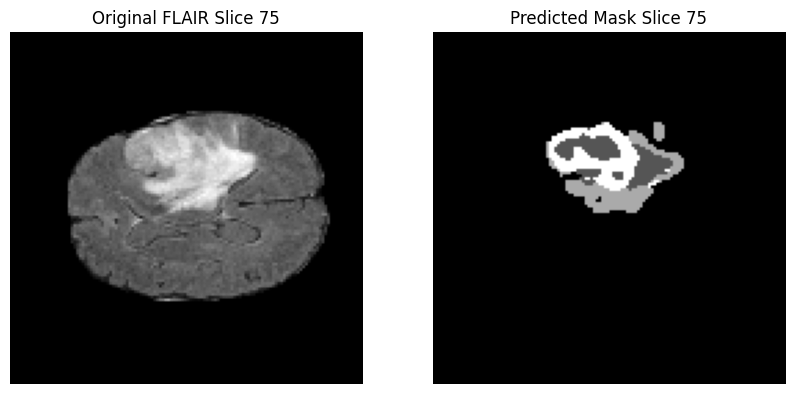

1/1 [==============================] - 0s 20ms/step


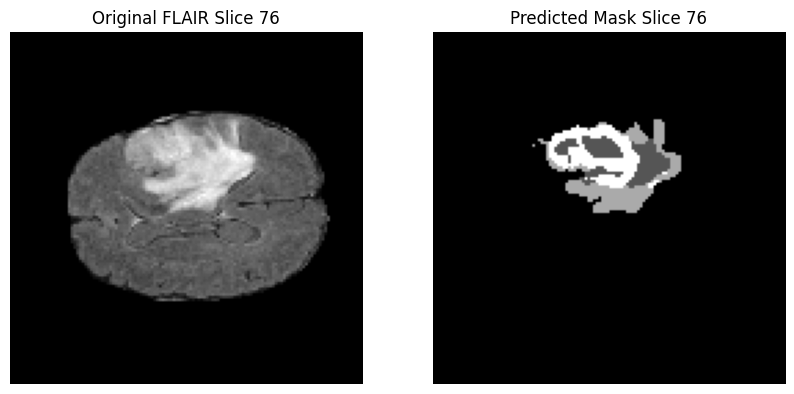

1/1 [==============================] - 0s 22ms/step


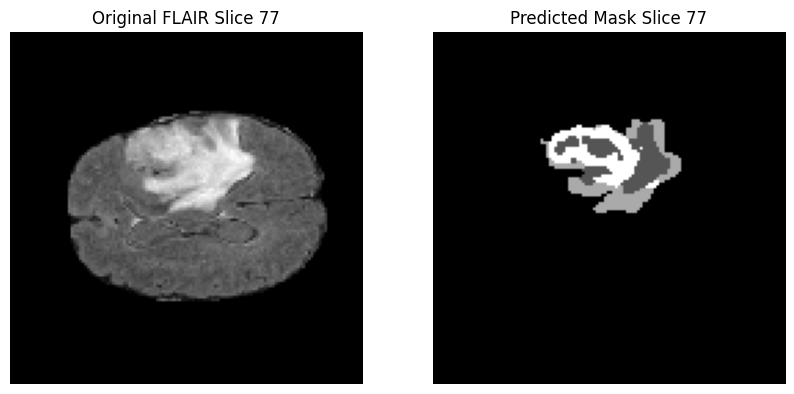

1/1 [==============================] - 0s 22ms/step


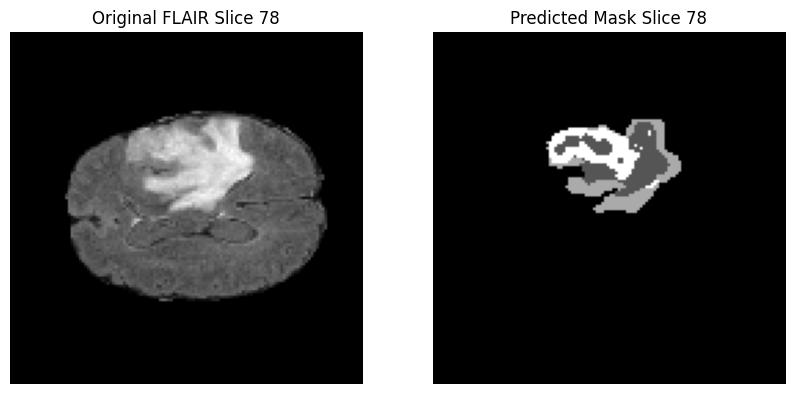

1/1 [==============================] - 0s 21ms/step


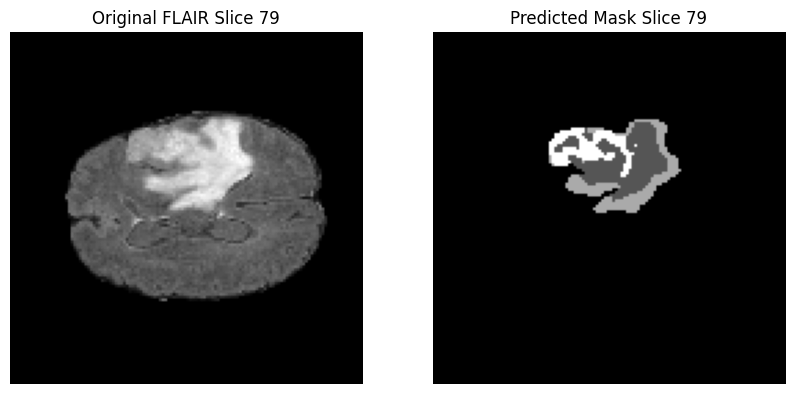

1/1 [==============================] - 0s 21ms/step


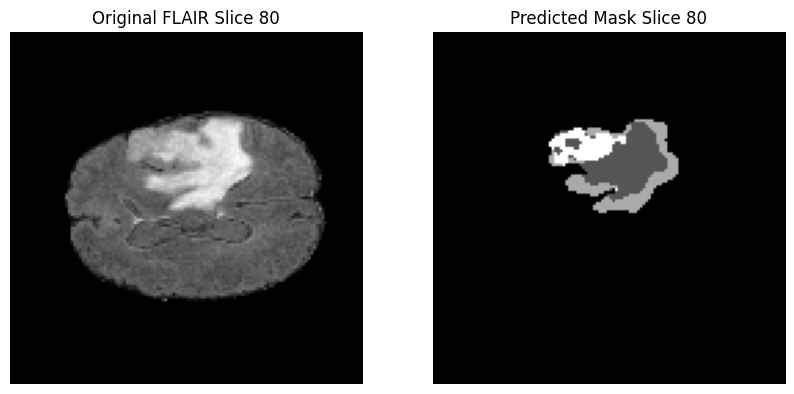

1/1 [==============================] - 0s 21ms/step


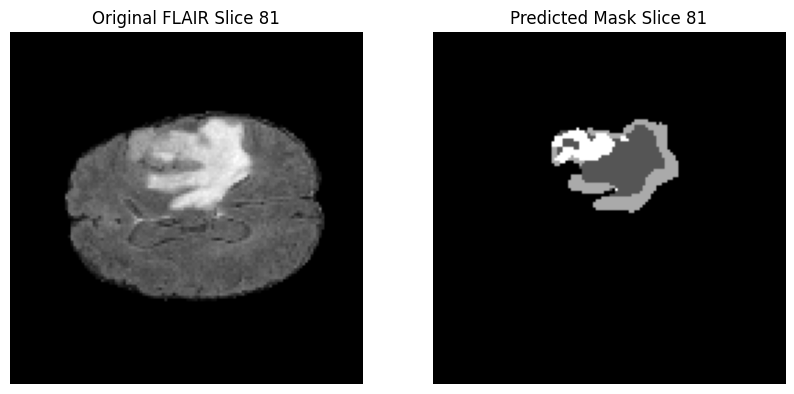

1/1 [==============================] - 0s 21ms/step


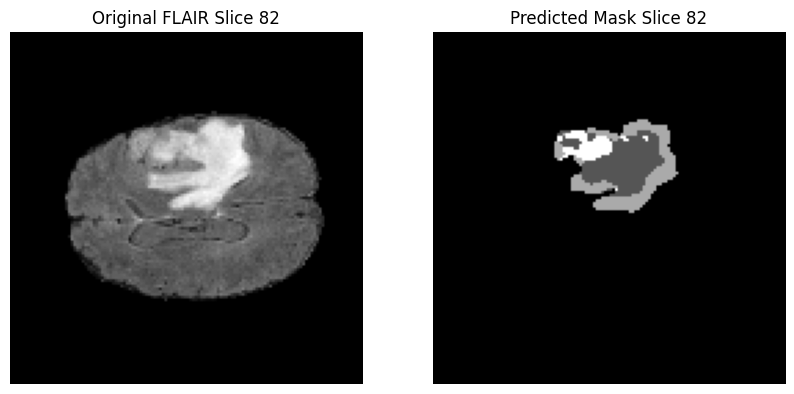

1/1 [==============================] - 0s 21ms/step


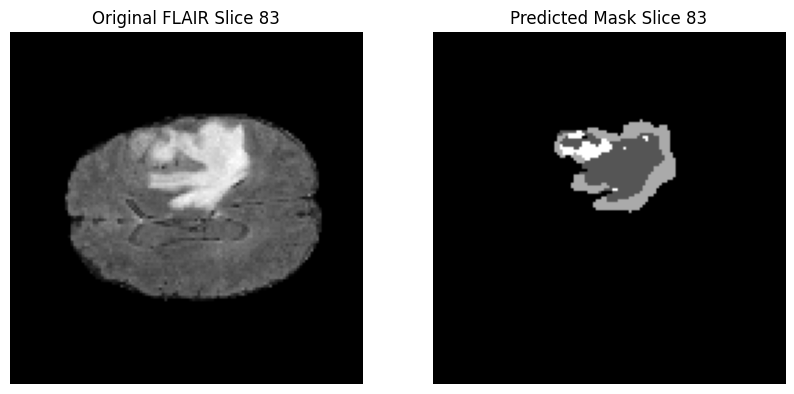

1/1 [==============================] - 0s 20ms/step


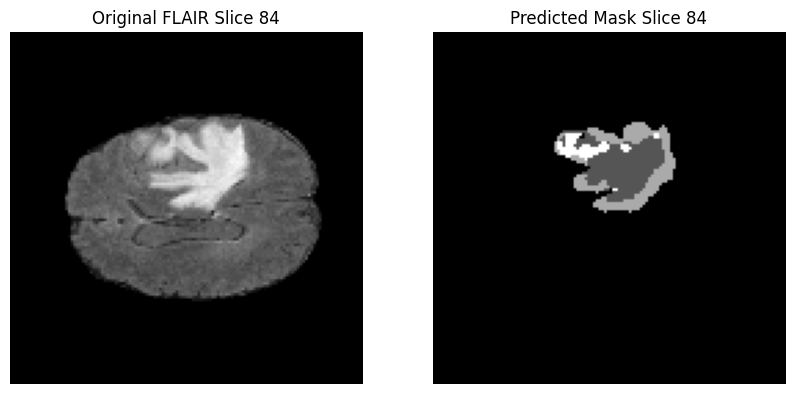

1/1 [==============================] - 0s 19ms/step


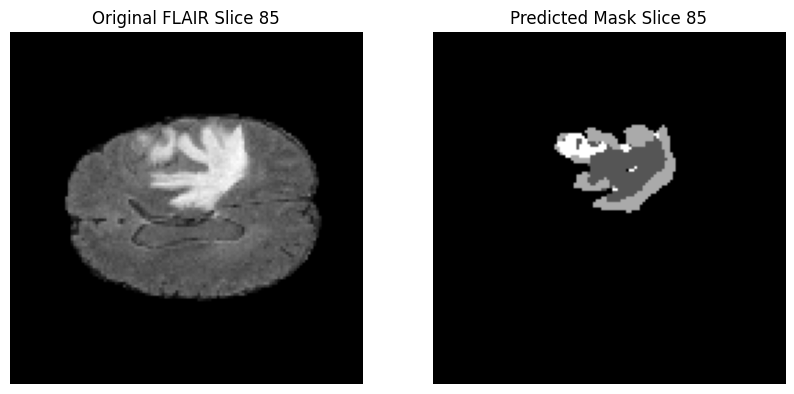

1/1 [==============================] - 0s 22ms/step


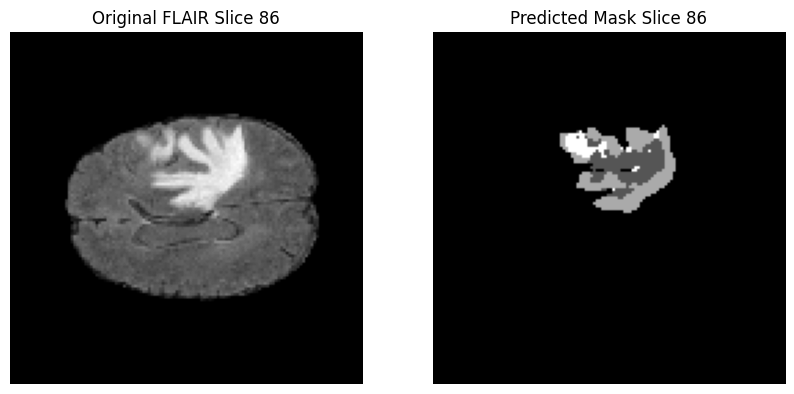

1/1 [==============================] - 0s 20ms/step


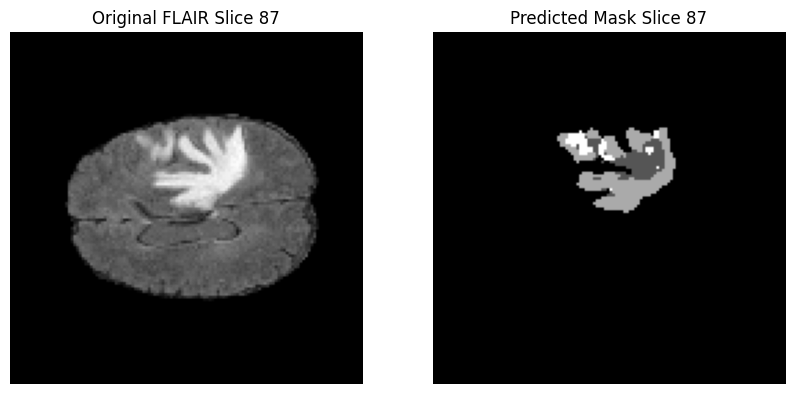

1/1 [==============================] - 0s 21ms/step


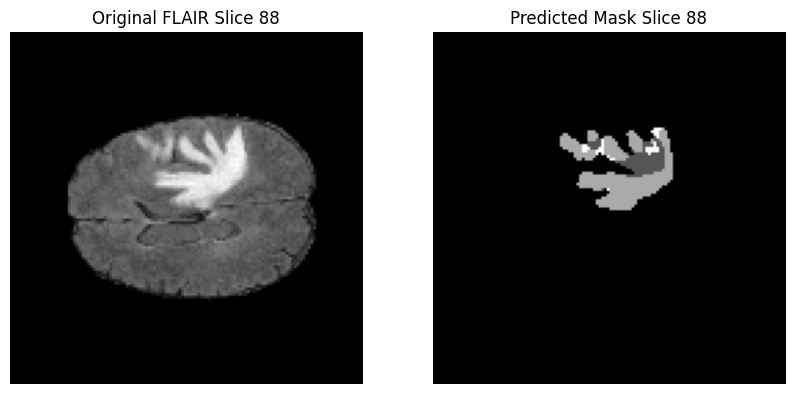

1/1 [==============================] - 0s 20ms/step


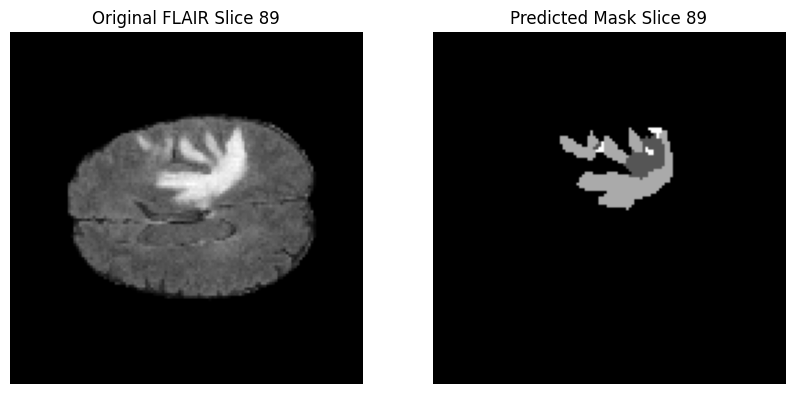

1/1 [==============================] - 0s 21ms/step


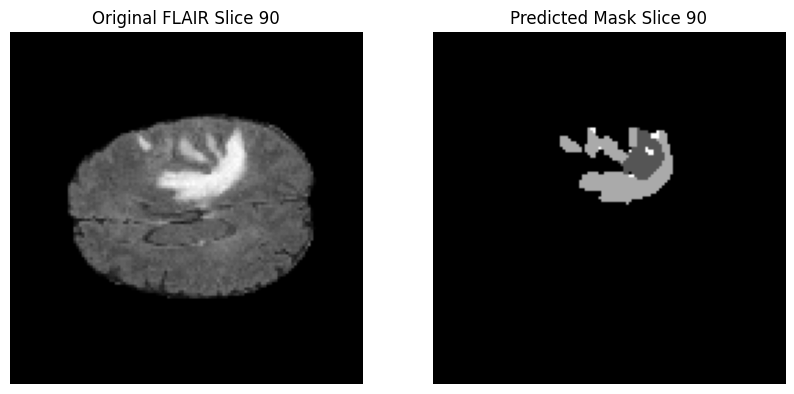

1/1 [==============================] - 0s 20ms/step


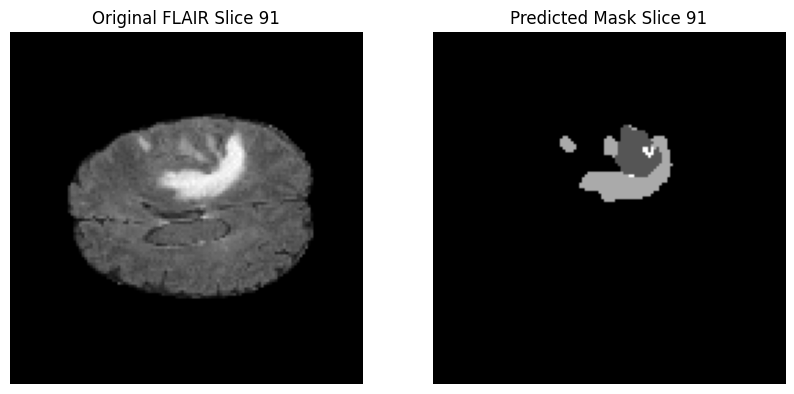

1/1 [==============================] - 0s 21ms/step


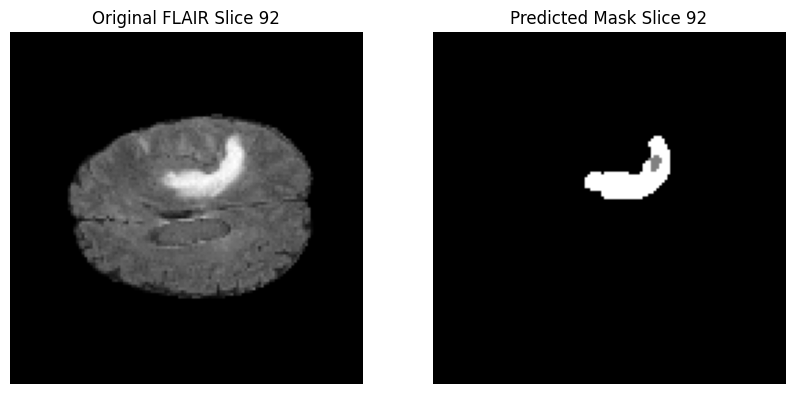

1/1 [==============================] - 0s 21ms/step


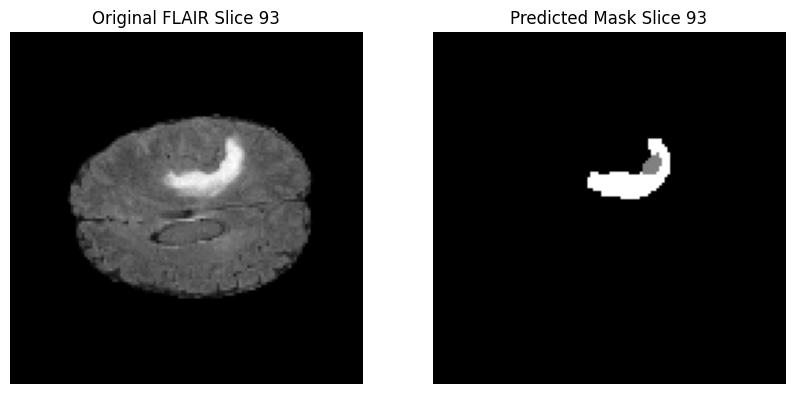

1/1 [==============================] - 0s 20ms/step


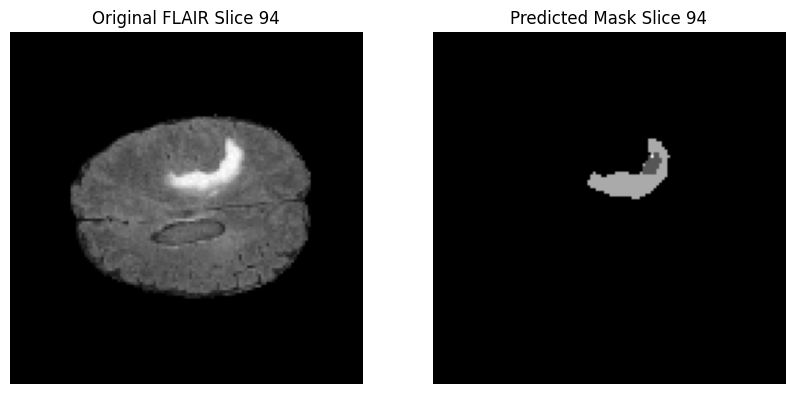

1/1 [==============================] - 0s 22ms/step


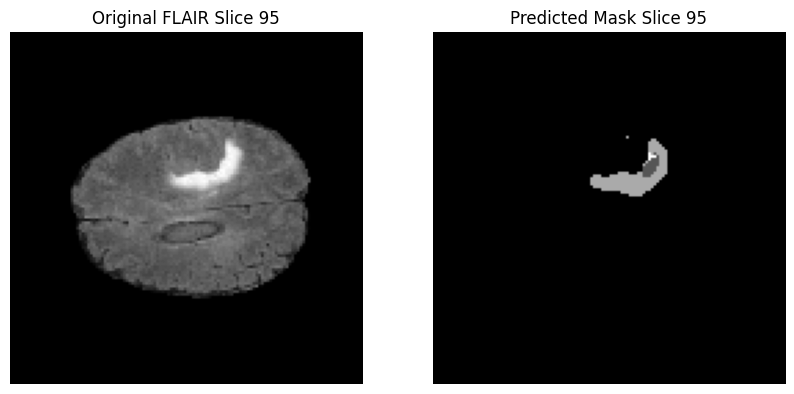

1/1 [==============================] - 0s 21ms/step


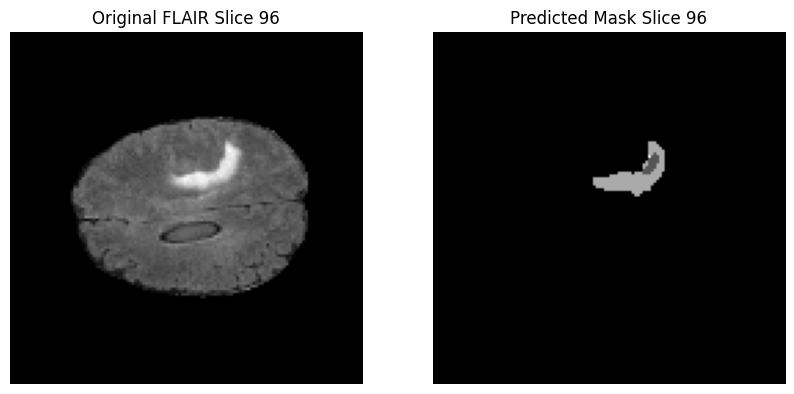

1/1 [==============================] - 0s 20ms/step


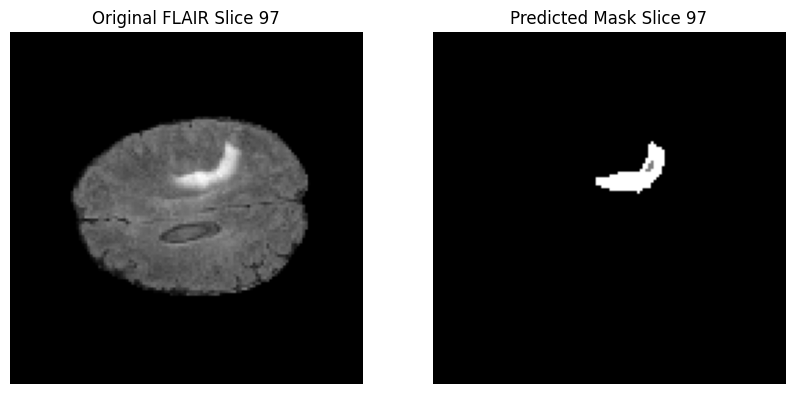

1/1 [==============================] - 0s 20ms/step


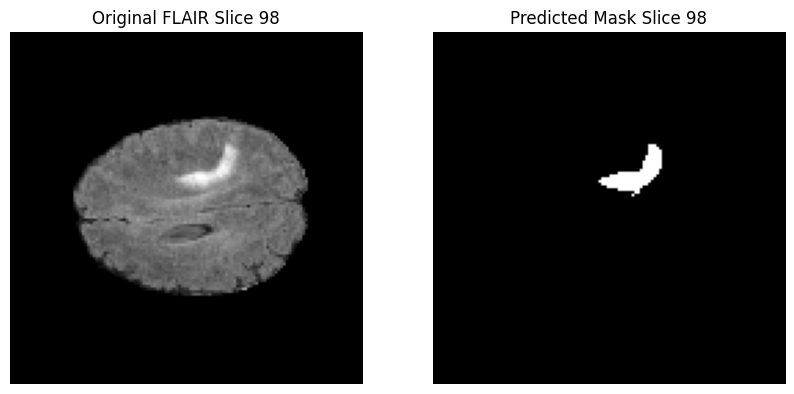

1/1 [==============================] - 0s 20ms/step


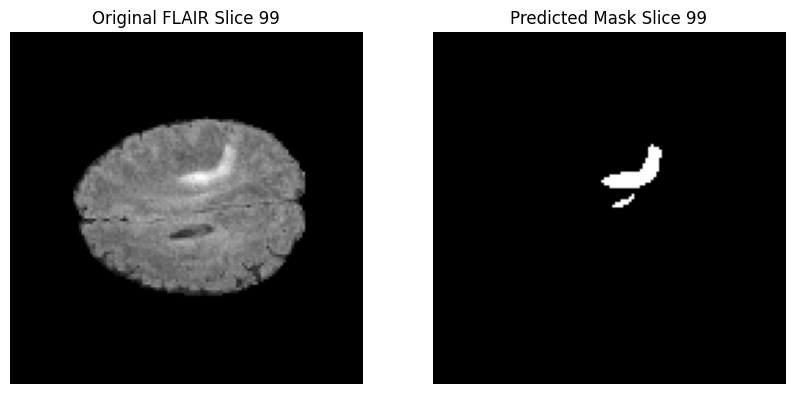

1/1 [==============================] - 0s 21ms/step


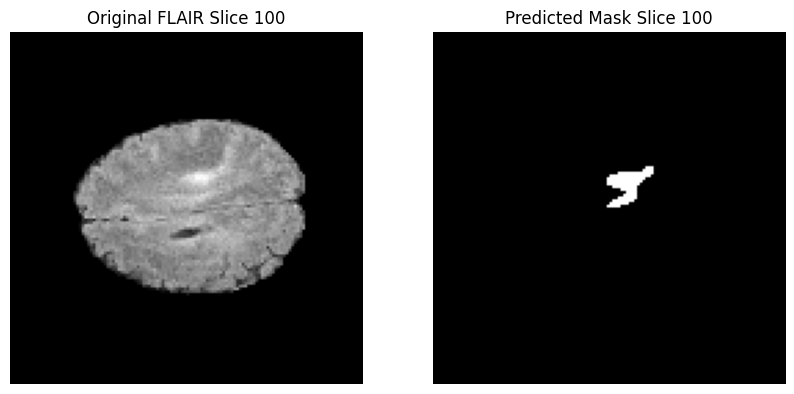

1/1 [==============================] - 0s 22ms/step


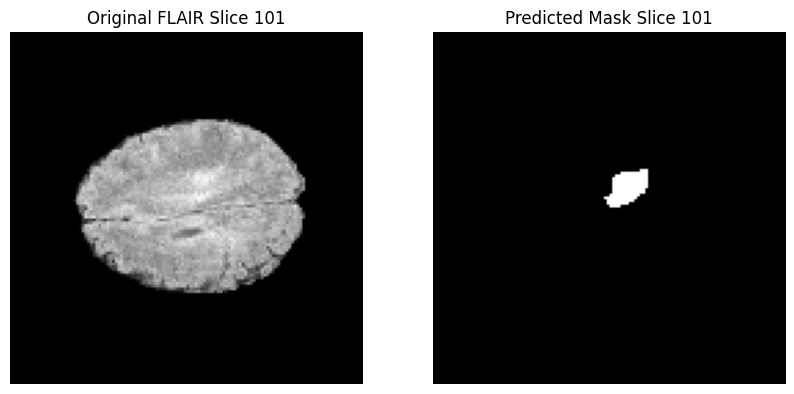

1/1 [==============================] - 0s 19ms/step


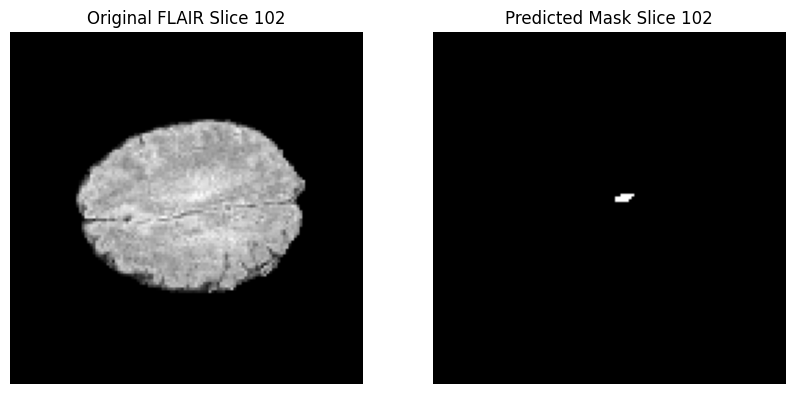

1/1 [==============================] - 0s 21ms/step


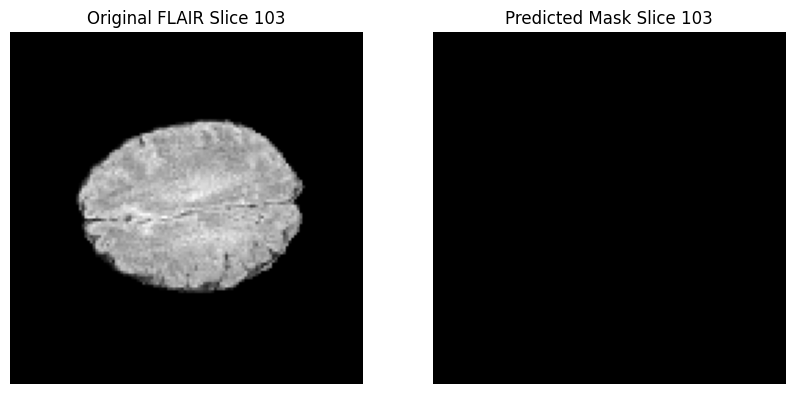

1/1 [==============================] - 0s 19ms/step


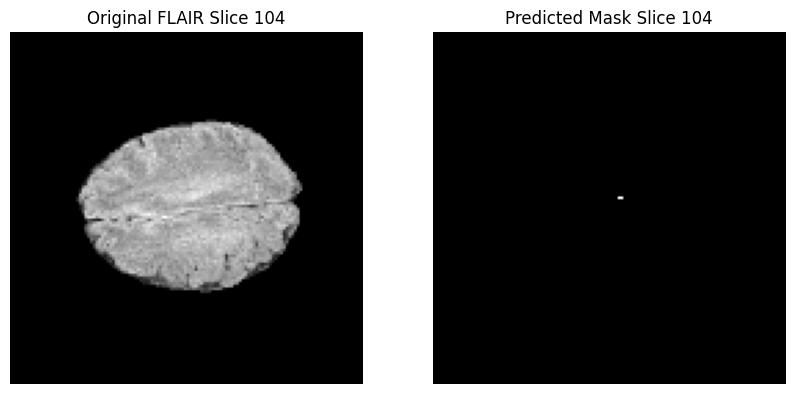

1/1 [==============================] - 0s 19ms/step


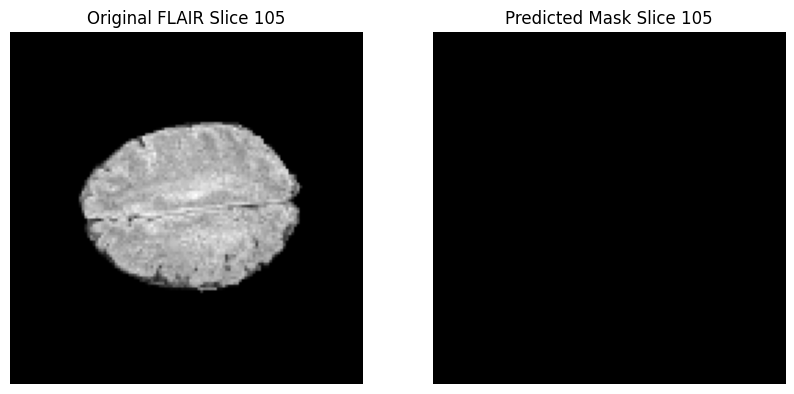

1/1 [==============================] - 0s 21ms/step


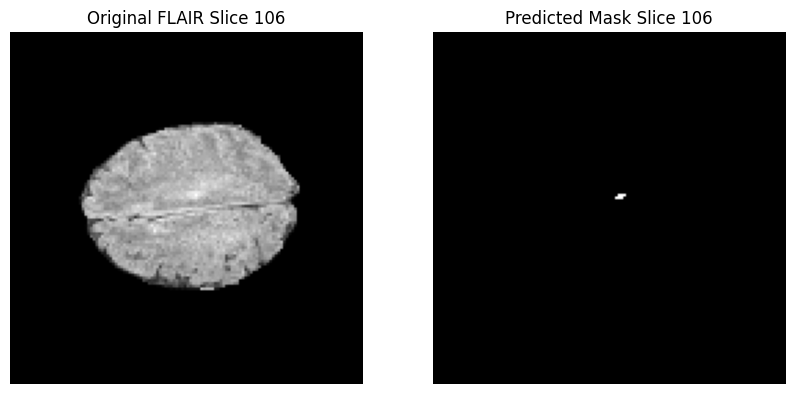

1/1 [==============================] - 0s 22ms/step


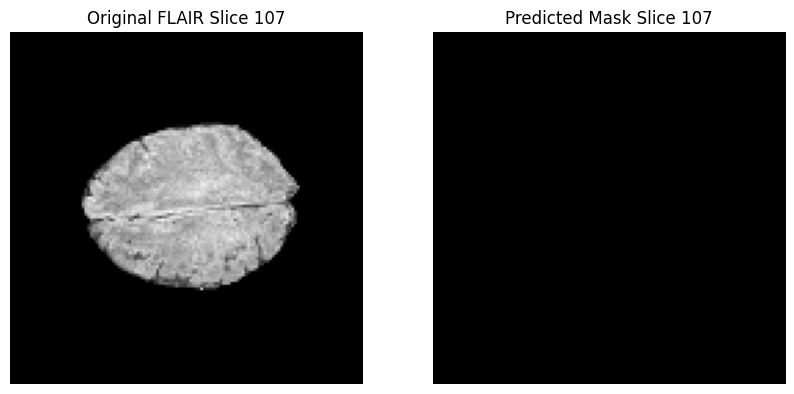

1/1 [==============================] - 0s 19ms/step


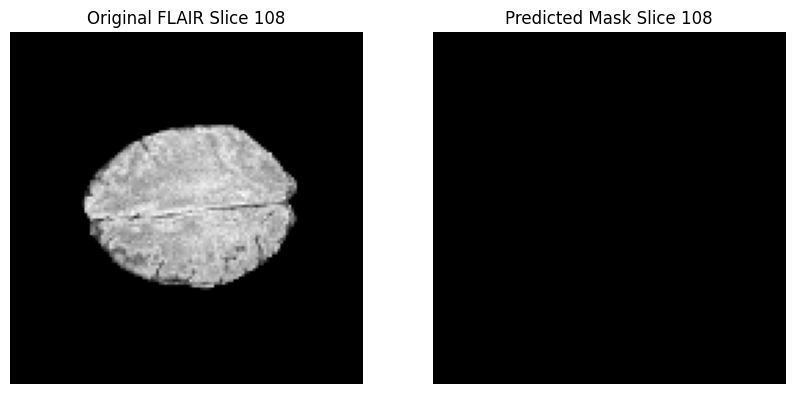

1/1 [==============================] - 0s 20ms/step


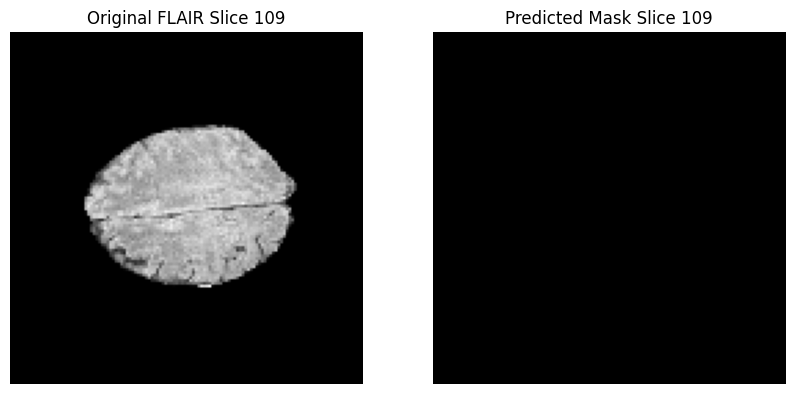

1/1 [==============================] - 0s 20ms/step


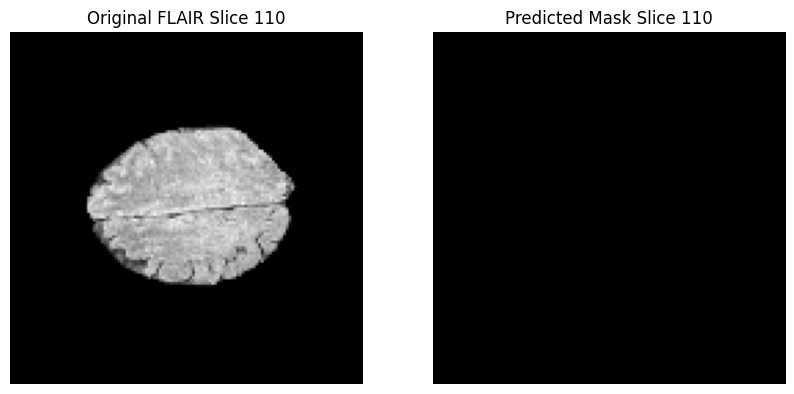

1/1 [==============================] - 0s 19ms/step


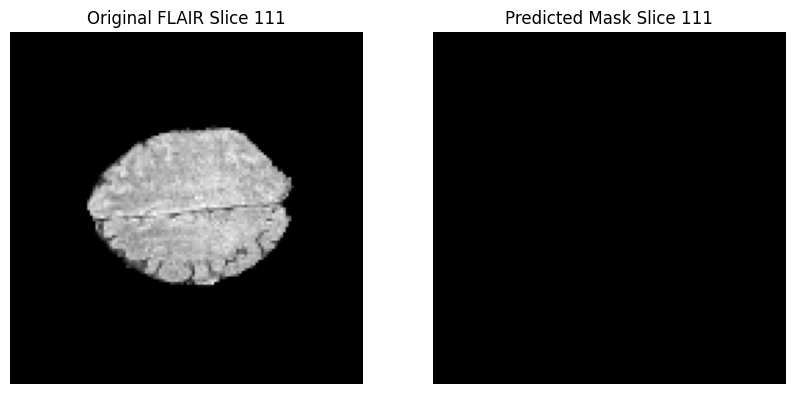

1/1 [==============================] - 0s 20ms/step


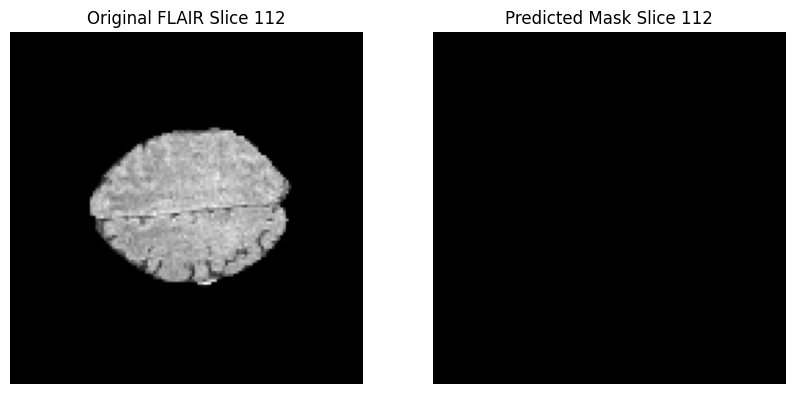

1/1 [==============================] - 0s 19ms/step


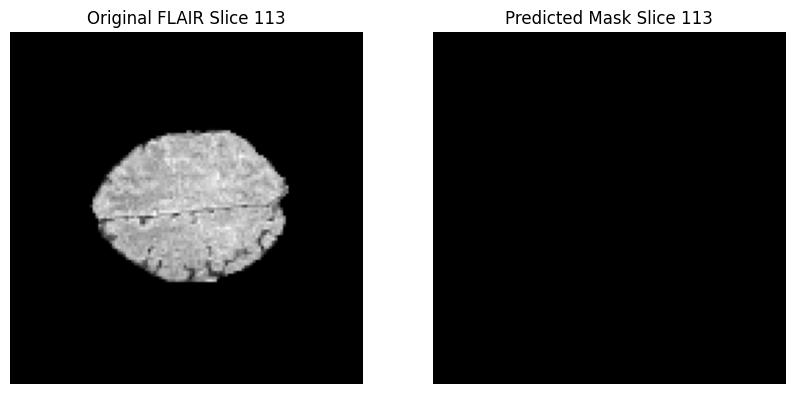

1/1 [==============================] - 0s 19ms/step


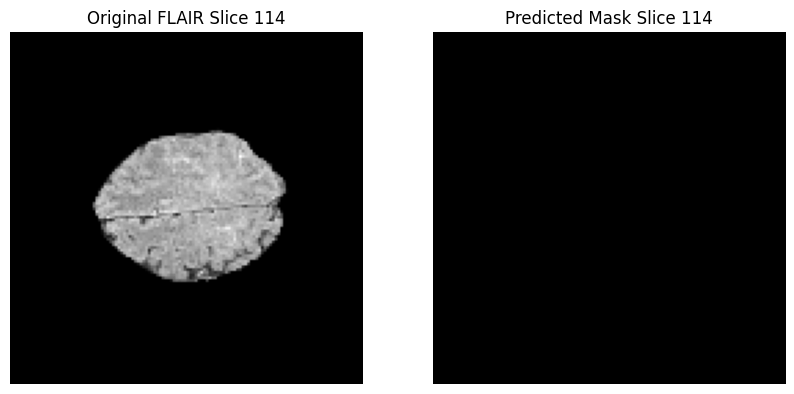

1/1 [==============================] - 0s 21ms/step


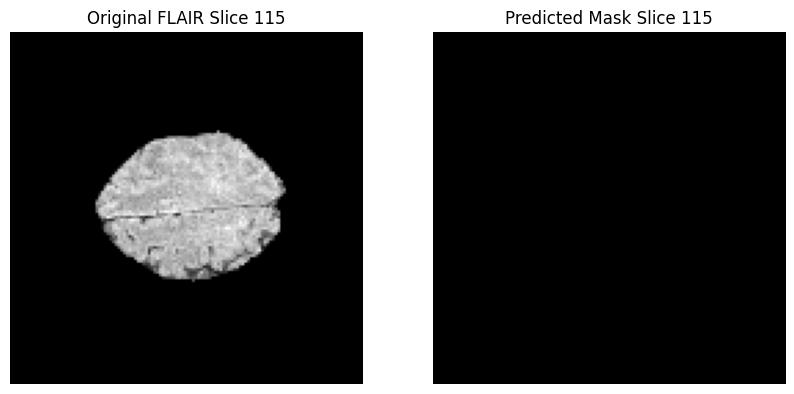

1/1 [==============================] - 0s 21ms/step


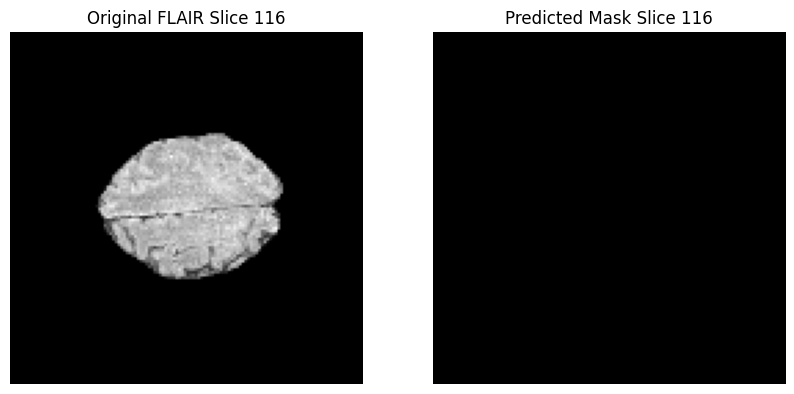

1/1 [==============================] - 0s 20ms/step


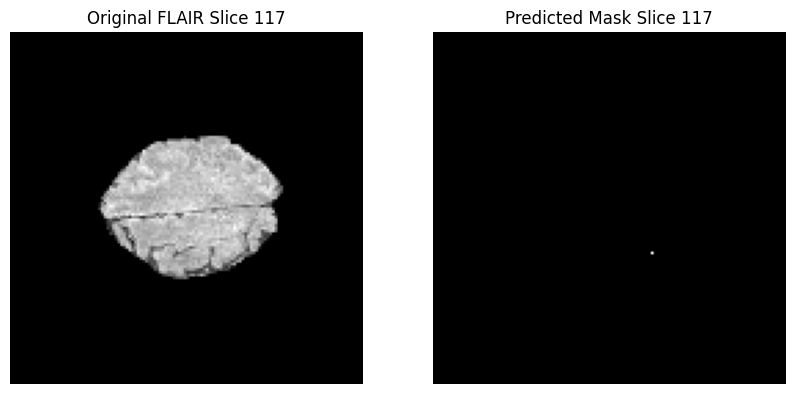

1/1 [==============================] - 0s 19ms/step


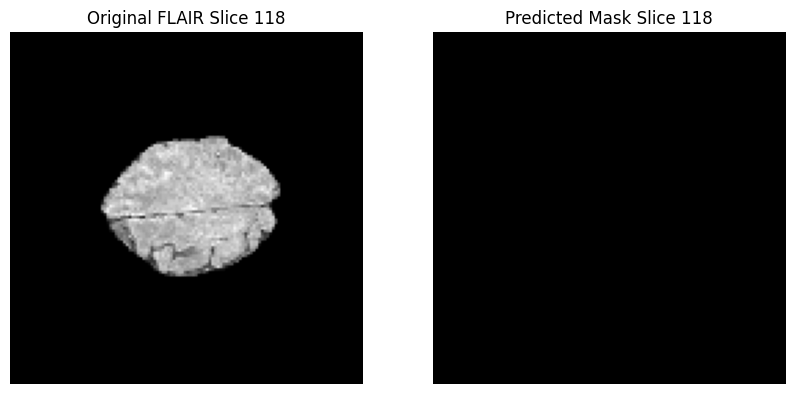

1/1 [==============================] - 0s 18ms/step


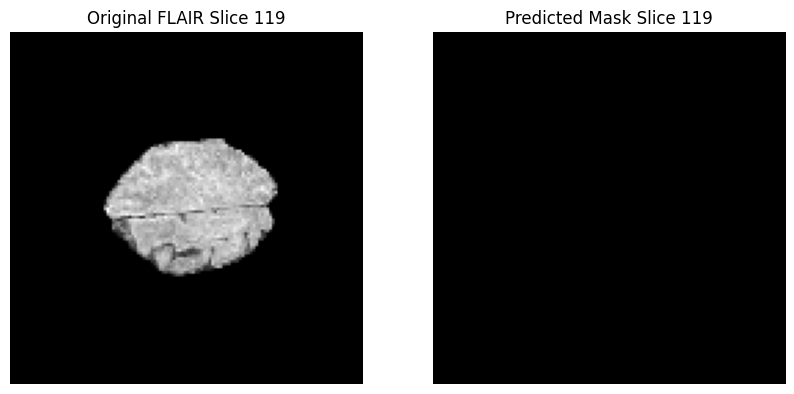

1/1 [==============================] - 0s 21ms/step


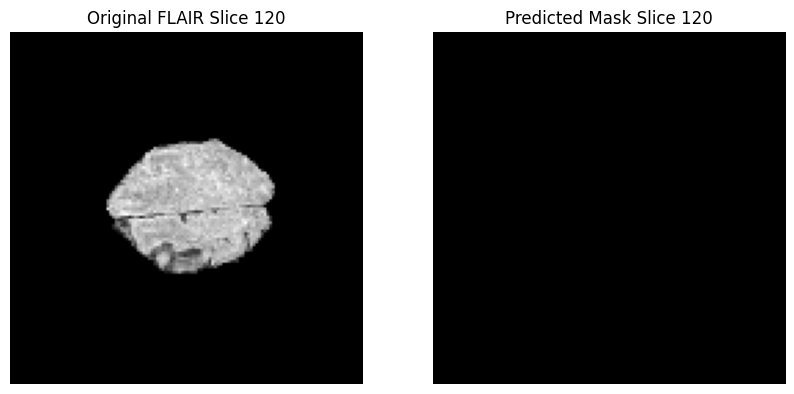

1/1 [==============================] - 0s 19ms/step


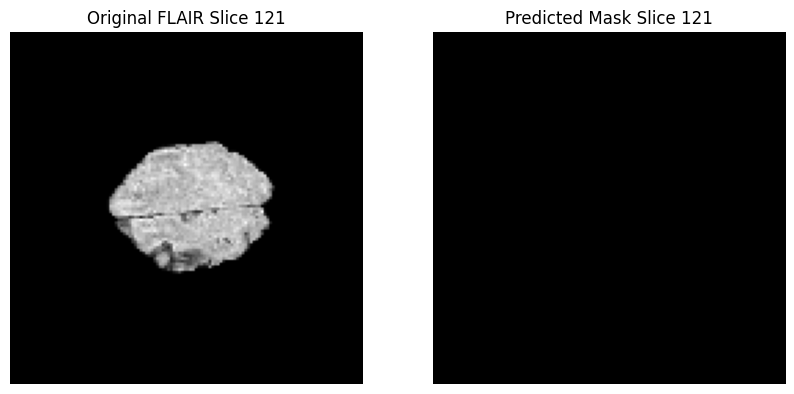

1/1 [==============================] - 0s 19ms/step


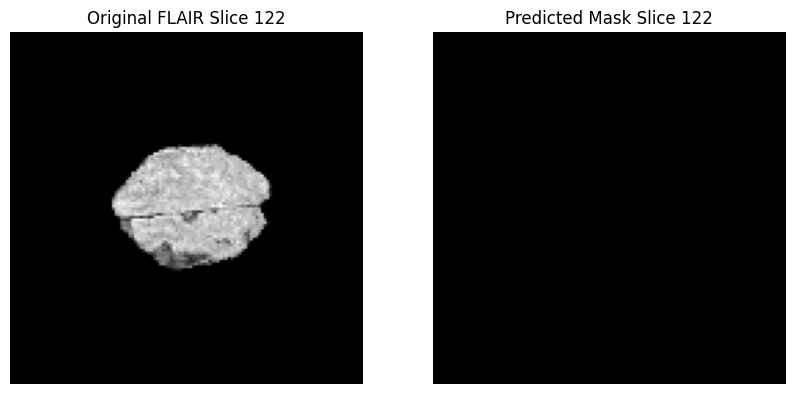

1/1 [==============================] - 0s 21ms/step


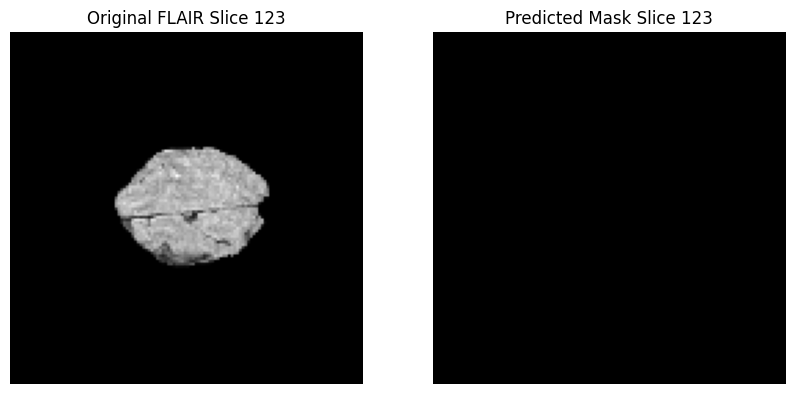

1/1 [==============================] - 0s 20ms/step


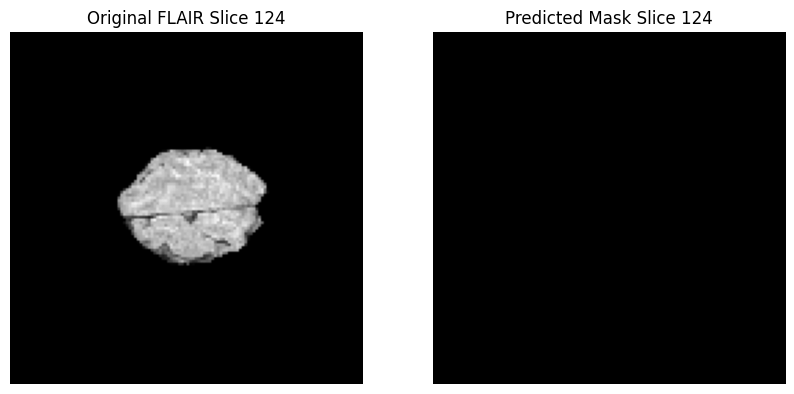

1/1 [==============================] - 0s 20ms/step


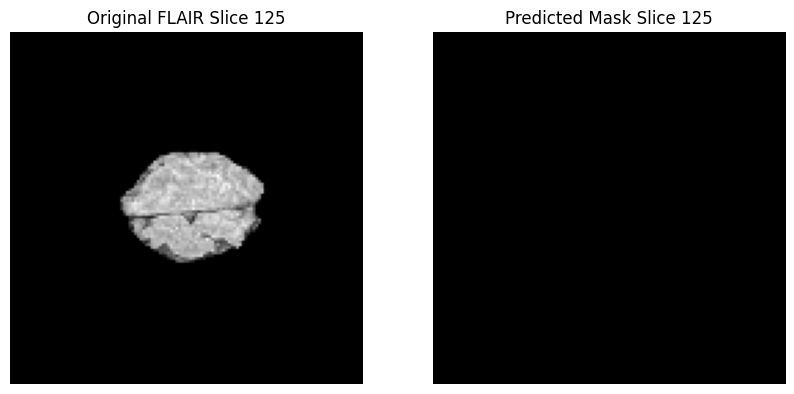

1/1 [==============================] - 0s 21ms/step


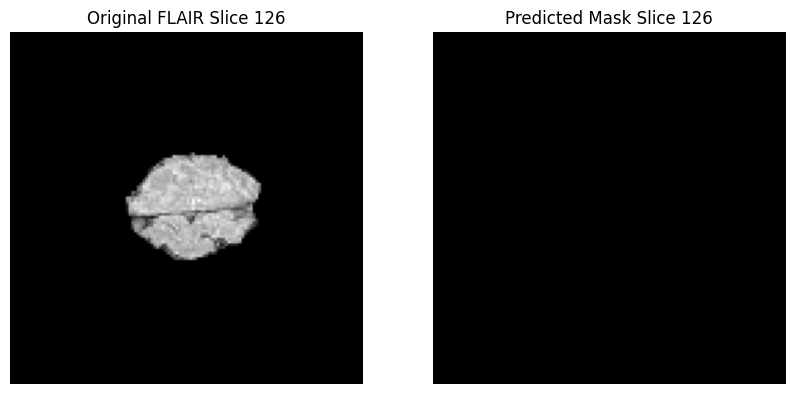

1/1 [==============================] - 0s 20ms/step


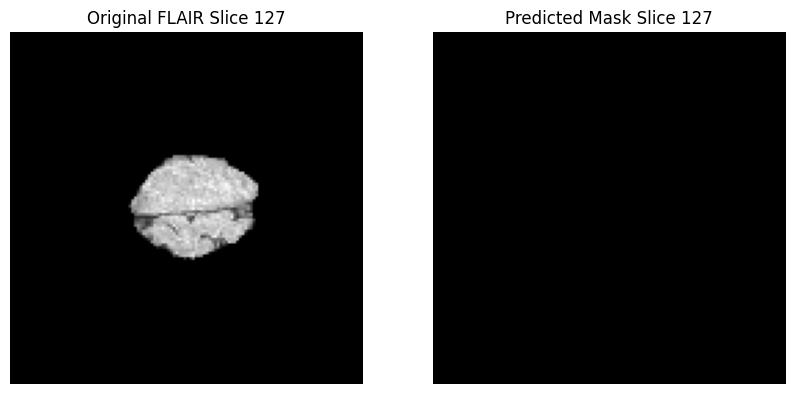

1/1 [==============================] - 0s 19ms/step


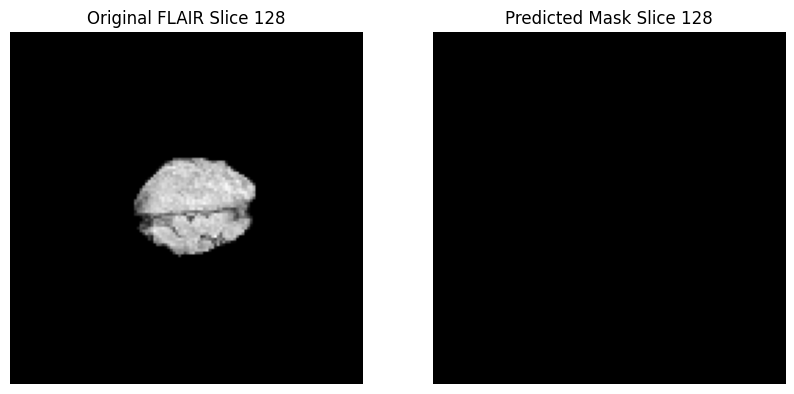

1/1 [==============================] - 0s 20ms/step


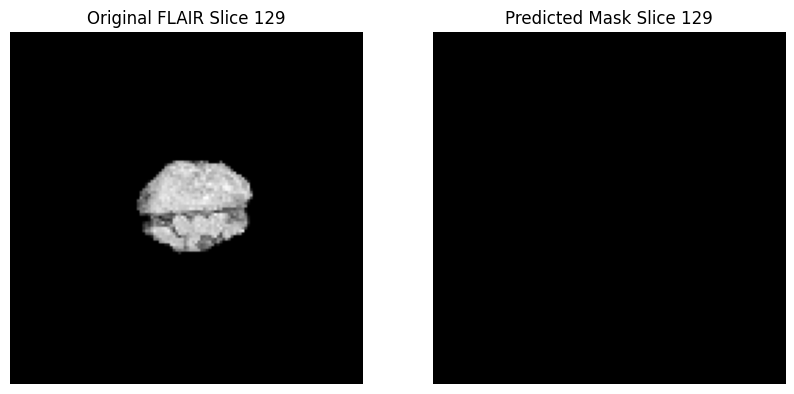

1/1 [==============================] - 0s 19ms/step


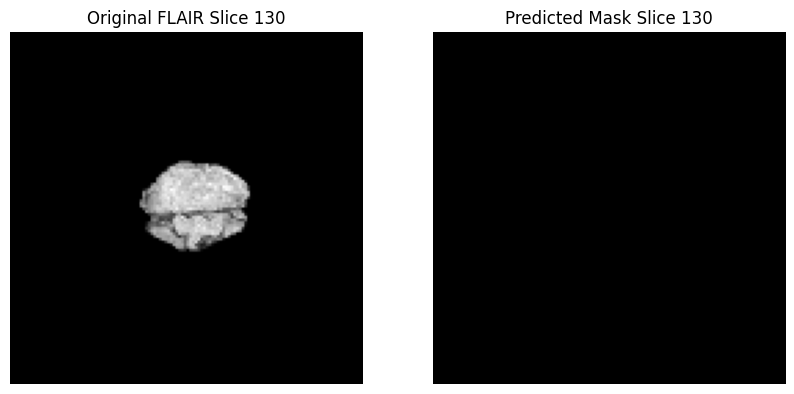

1/1 [==============================] - 0s 20ms/step


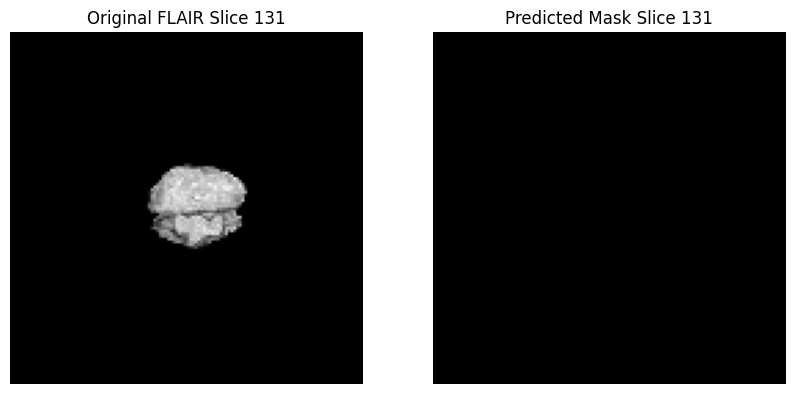

1/1 [==============================] - 0s 19ms/step


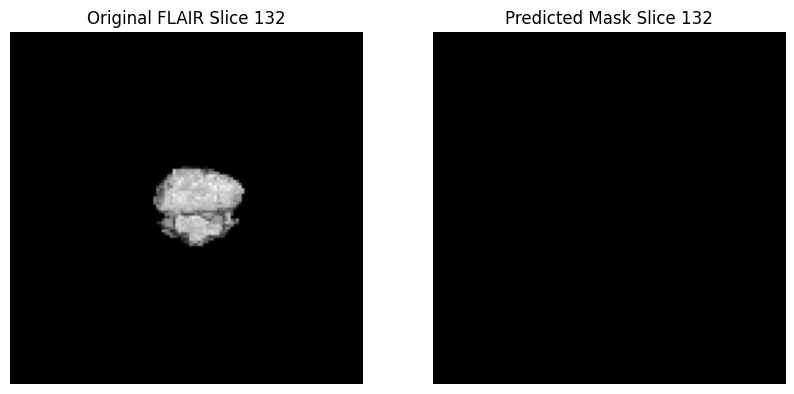

1/1 [==============================] - 0s 20ms/step


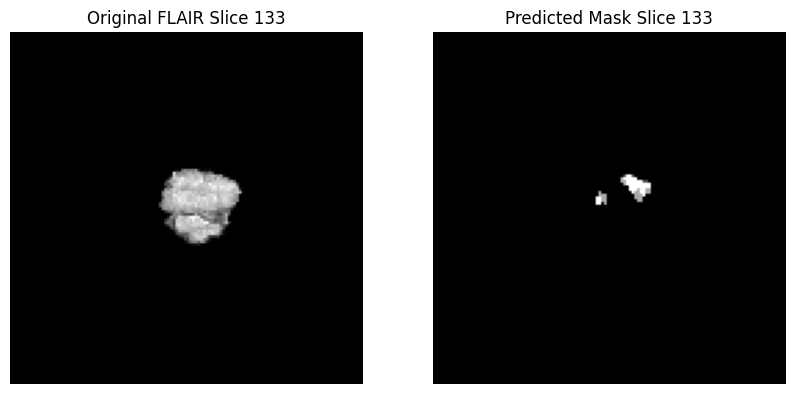

1/1 [==============================] - 0s 19ms/step


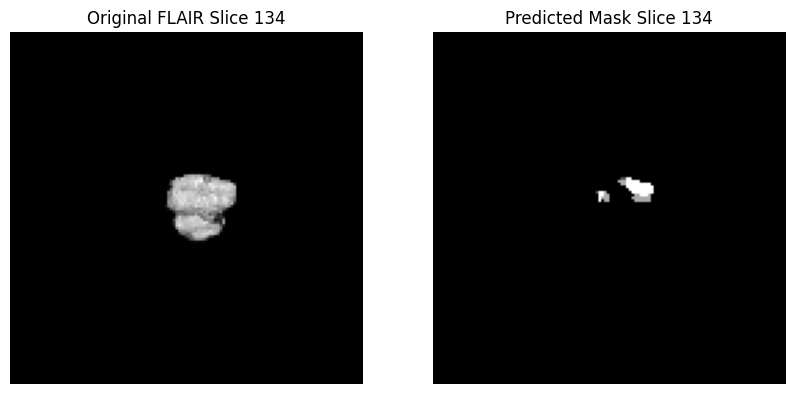

1/1 [==============================] - 0s 22ms/step


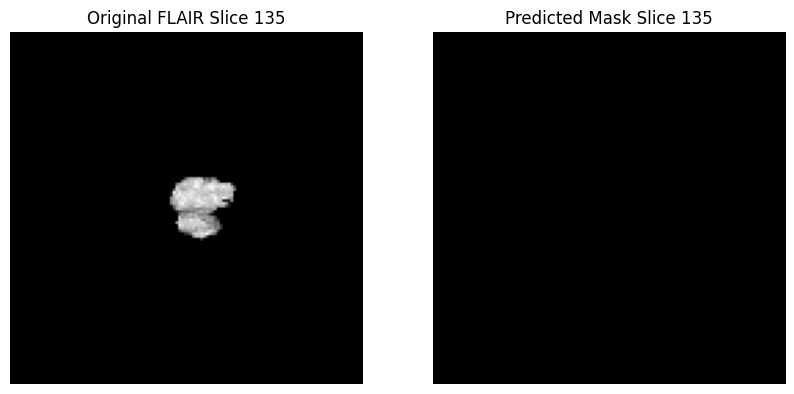

1/1 [==============================] - 0s 22ms/step


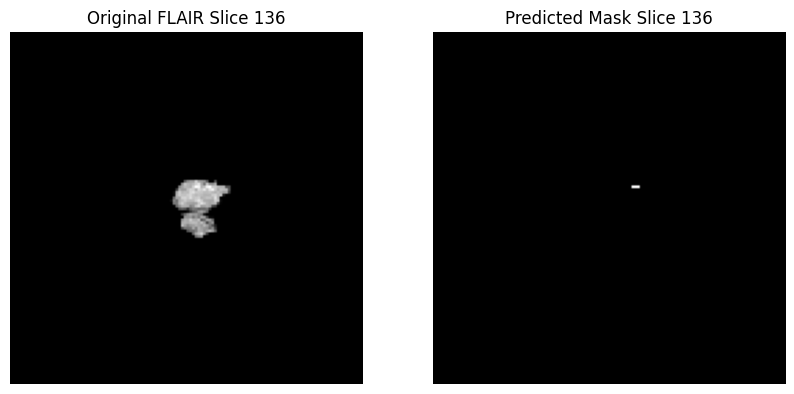

1/1 [==============================] - 0s 22ms/step


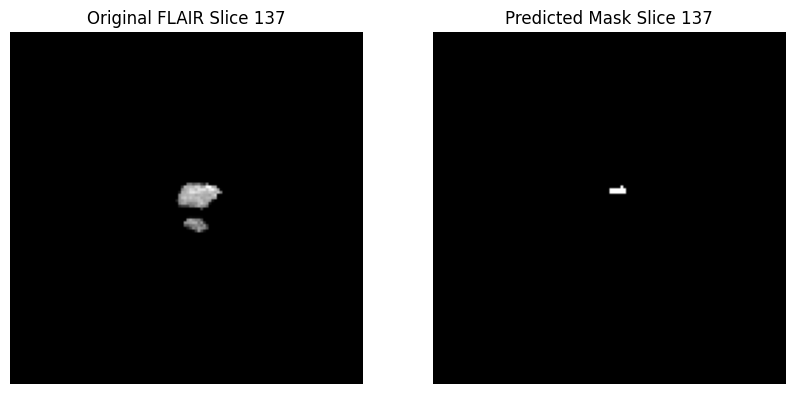

1/1 [==============================] - 0s 22ms/step


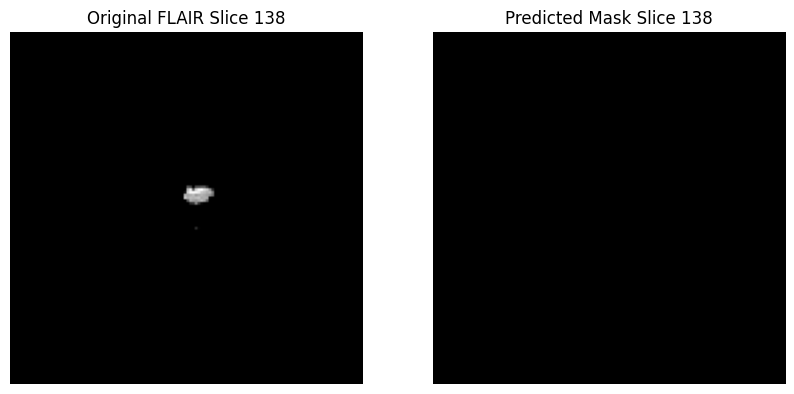

1/1 [==============================] - 0s 21ms/step


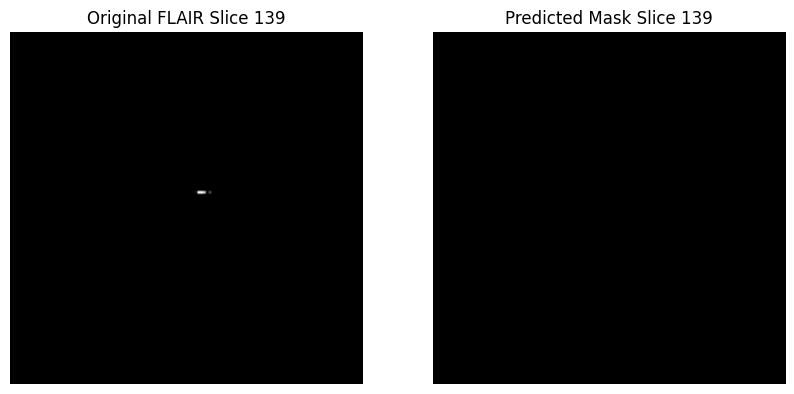

1/1 [==============================] - 0s 20ms/step


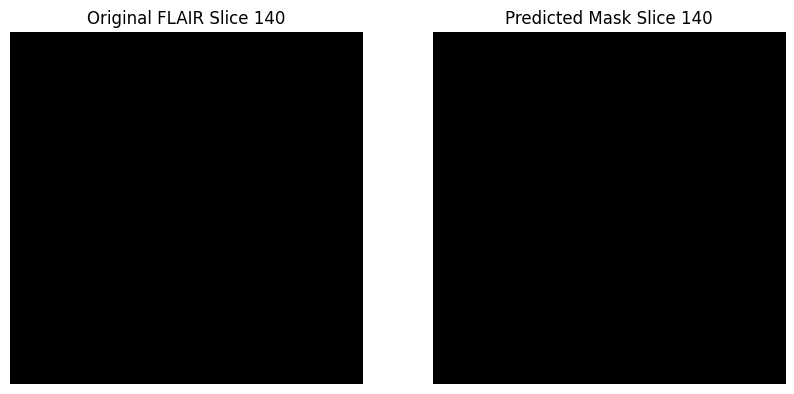

1/1 [==============================] - 0s 20ms/step


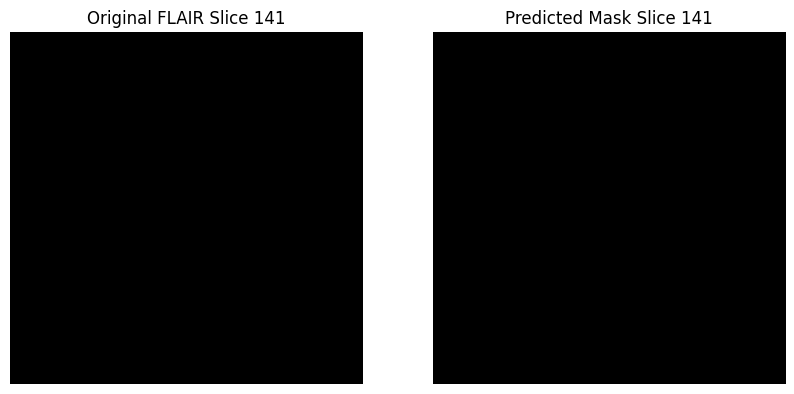

1/1 [==============================] - 0s 20ms/step


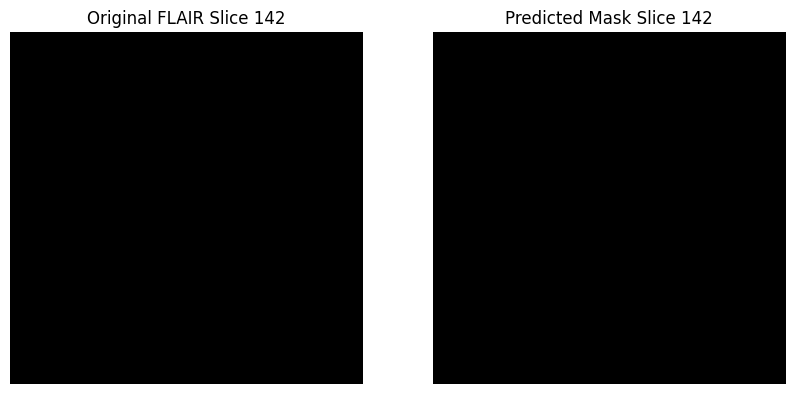

1/1 [==============================] - 0s 23ms/step


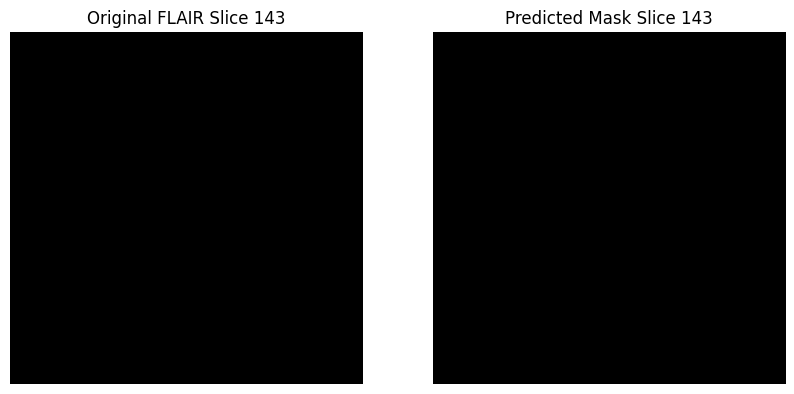

1/1 [==============================] - 0s 20ms/step


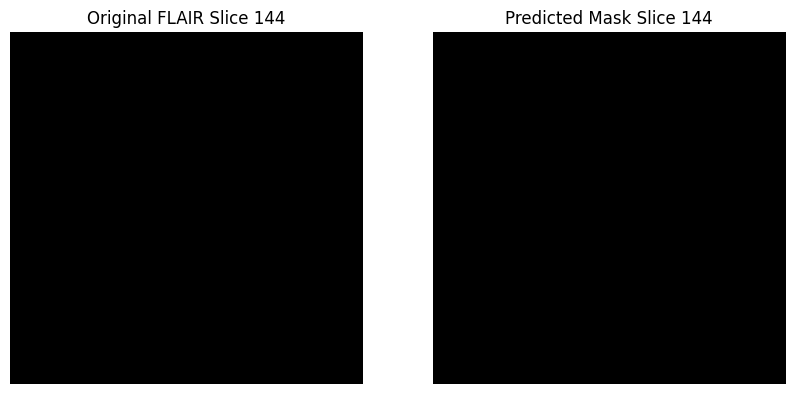

1/1 [==============================] - 0s 20ms/step


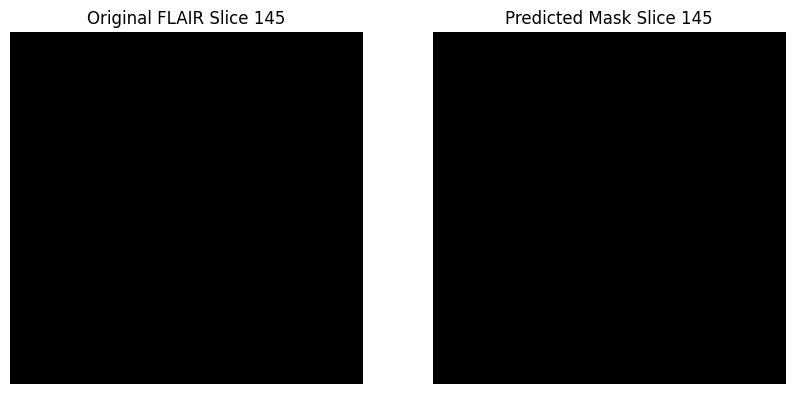

1/1 [==============================] - 0s 20ms/step


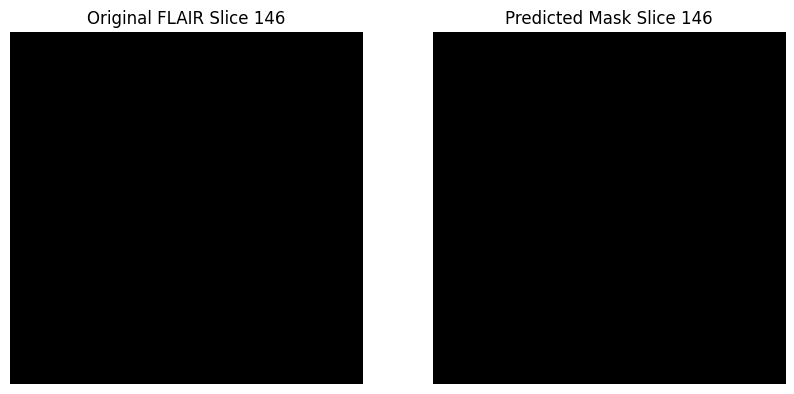

1/1 [==============================] - 0s 22ms/step


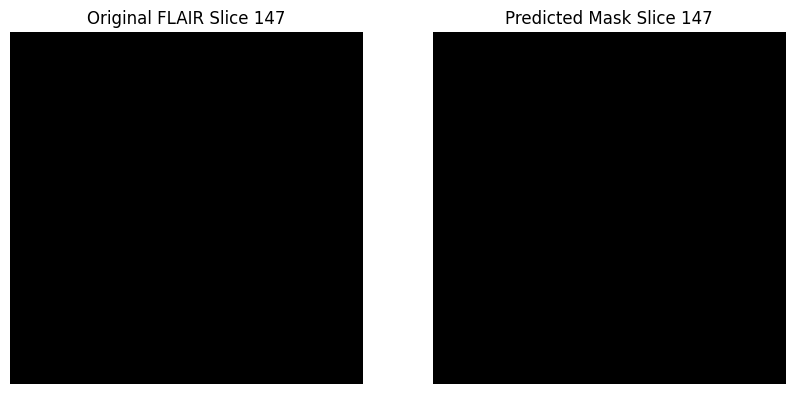

1/1 [==============================] - 0s 21ms/step


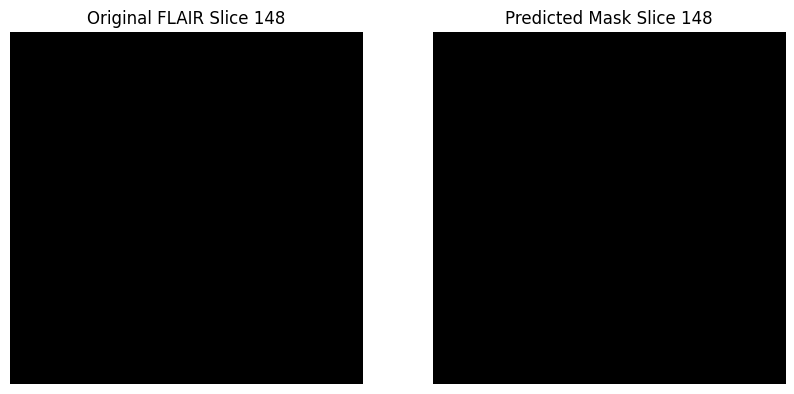

1/1 [==============================] - 0s 20ms/step


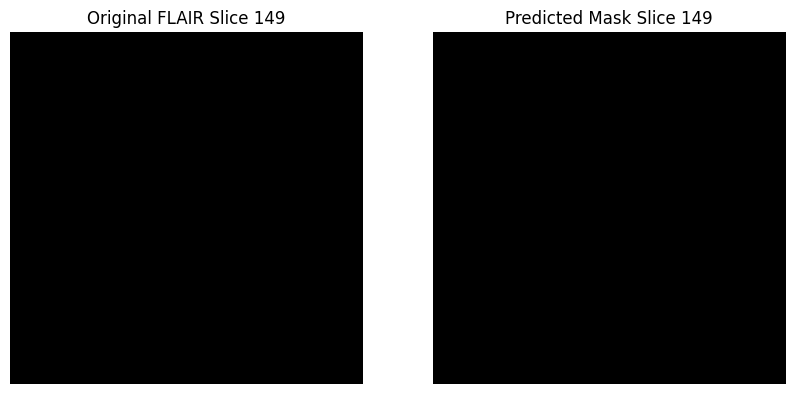

1/1 [==============================] - 0s 19ms/step


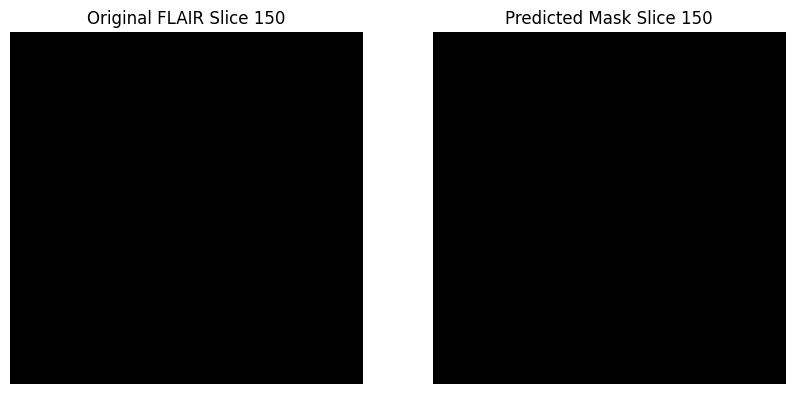

1/1 [==============================] - 0s 19ms/step


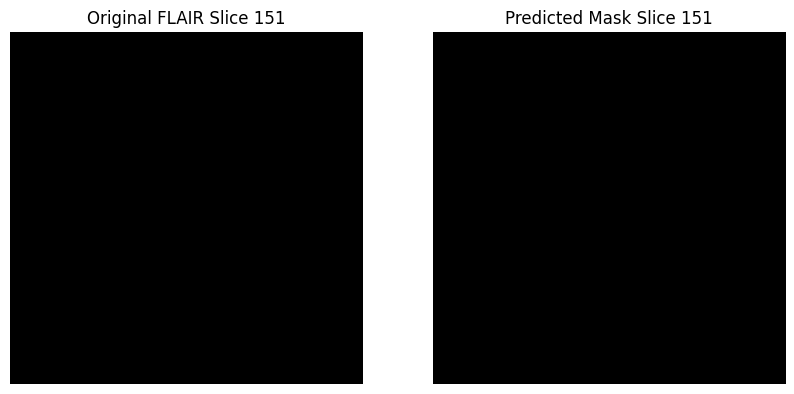

1/1 [==============================] - 0s 21ms/step


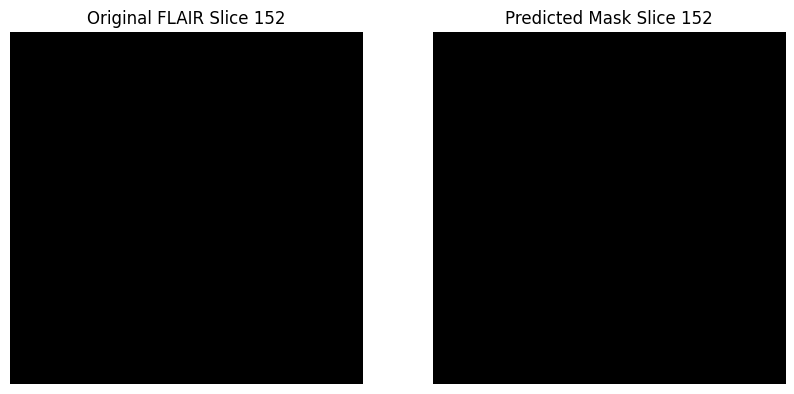

1/1 [==============================] - 0s 20ms/step


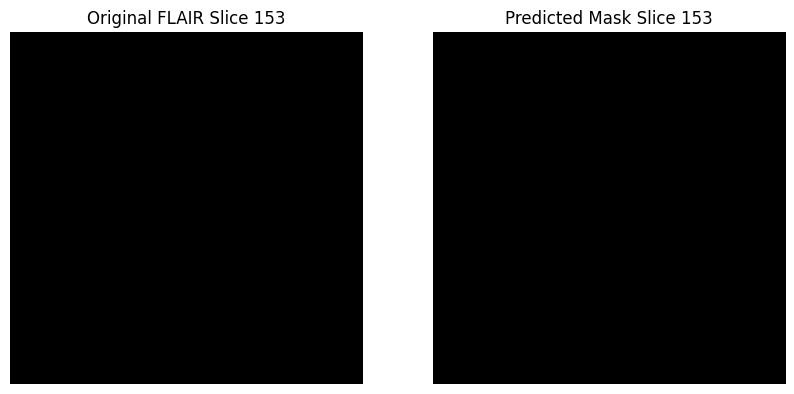

1/1 [==============================] - 0s 18ms/step


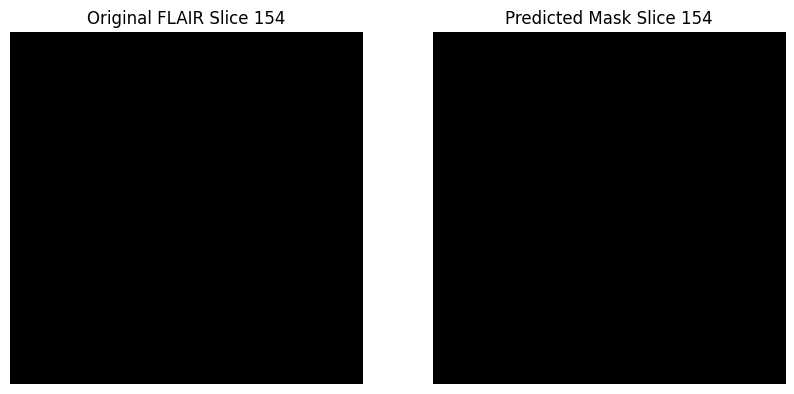

In [ ]:
# Load the MRI volumes
flair_path = '/content/data/BraTS2020_ValidationData/MICCAI_BraTS2020_ValidationData/BraTS20_Validation_039/BraTS20_Validation_039_flair.nii'
t1ce_path = '/content/data/BraTS2020_ValidationData/MICCAI_BraTS2020_ValidationData/BraTS20_Validation_039/BraTS20_Validation_039_t1ce.nii'

flair_volume = nib.load(flair_path).get_fdata()
t1ce_volume = nib.load(t1ce_path).get_fdata()

# Normalize the volumes
flair_volume = flair_volume / np.max(flair_volume)
t1ce_volume = t1ce_volume / np.max(t1ce_volume)

# Predict and visualize all slices
num_slices = flair_volume.shape[2]
for slice_index in range(num_slices):
    # Resize the slices to the input size expected by the model
    flair_slice = cv2.resize(flair_volume[:, :, slice_index], (IMG_SIZE, IMG_SIZE))
    t1ce_slice = cv2.resize(t1ce_volume[:, :, slice_index], (IMG_SIZE, IMG_SIZE))

    # Stack the slices and add batch dimension
    image = np.stack((flair_slice, t1ce_slice), axis=-1)[np.newaxis, ...]

    # Predict the mask
    predicted_mask = model.predict(image)
    predicted_mask = np.argmax(predicted_mask, axis=-1).squeeze()

    # Set up the subplots
    fig, axes = plt.subplots(1, 2, figsize=(10, 5))

    # Plot the original FLAIR slice
    axes[0].imshow(flair_slice, cmap='gray')
    axes[0].set_title(f'Original FLAIR Slice {slice_index}')
    axes[0].axis('off')

    # Plot the predicted mask
    axes[1].imshow(predicted_mask, cmap='gray')
    axes[1].set_title(f'Predicted Mask Slice {slice_index}')
    axes[1].axis('off')

    plt.show()


# Visualize Overlay of Predicted Segmentations on MRI Slices

1/1 [==============================] - 0s 17ms/step


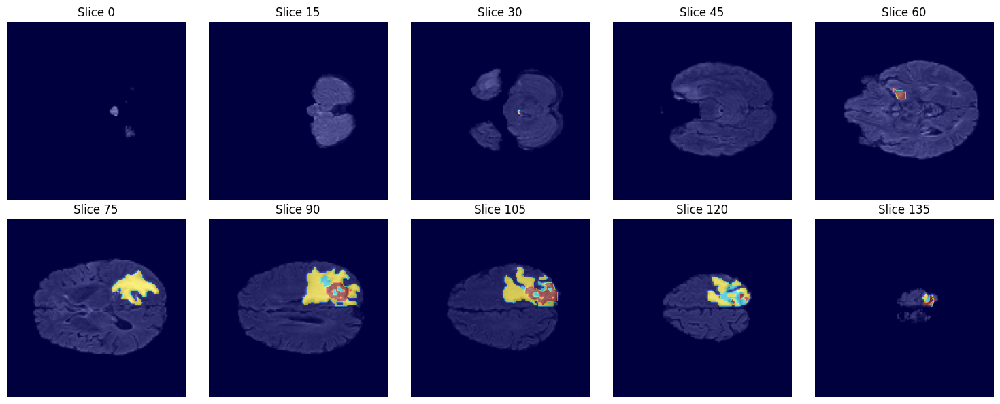

In [ ]:
# Define paths
# FIX
flair_path = '/content/data/BraTS2020_ValidationData/MICCAI_BraTS2020_ValidationData/BraTS20_Validation_001/BraTS20_Validation_001_flair.nii'
t1ce_path = '/content/data/BraTS2020_ValidationData/MICCAI_BraTS2020_ValidationData/BraTS20_Validation_001/BraTS20_Validation_001_t1ce.nii'

# Load modalities
flair_volume = nib.load(flair_path).get_fdata()
t1ce_volume = nib.load(t1ce_path).get_fdata()

# Normalize volumes
flair_volume = flair_volume / np.max(flair_volume)
t1ce_volume = t1ce_volume / np.max(t1ce_volume)

# Prepare a figure to visualize the slices
fig, axes = plt.subplots(2, 5, figsize=(15, 6))  # Adjust the grid size based on how many slices you want to show at once
axes = axes.flatten()

# Loop through each slice and predict the mask
for i, ax in enumerate(axes):
    # Assuming equal number of slices in both modalities and slicing across the z-axis (change if needed)
    slice_index = i * (flair_volume.shape[2] // len(axes))
    flair_slice = cv2.resize(flair_volume[:, :, slice_index], (IMG_SIZE, IMG_SIZE))
    t1ce_slice = cv2.resize(t1ce_volume[:, :, slice_index], (IMG_SIZE, IMG_SIZE))

    # Stack the slices along the channel axis and add batch dimension
    image = np.stack((flair_slice, t1ce_slice), axis=-1)[np.newaxis, ...]

    # Predict the mask for the slice
    predicted_mask = model.predict(image)
    predicted_mask = np.argmax(predicted_mask, axis=-1).squeeze()

    # Visualize the original slice and the predicted mask
    ax.imshow(flair_slice, cmap='gray')
    ax.imshow(predicted_mask, cmap='jet', alpha=0.5)  # Overlay mask
    ax.axis('off')
    ax.set_title(f'Slice {slice_index}')

plt.tight_layout()
plt.show()

# Save the model


In [ ]:
model.save('/content/sample_model.h5');

In [ ]:
from tensorflow.keras.models import load_model

# Define your custom objects in a dictionary
custom_objects = {'dice_coef': dice_coef}  # Add any other custom metrics, layers, or losses here

# Load the model with custom objects
model = load_model('/content/sample_model.h5', custom_objects=custom_objects)


In [ ]:
from google.colab import files
files.download('/content/sample_model.h5')

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>